# Gradual Domain Adaptation through Self-Training of Auxiliary Models


## Initial setup

Here we import libraries and set up the dataset

In [ ]:
# os stuff
import sys
from os import makedirs, listdir, mkdir, unlink
from os.path import join, basename, splitext, exists, split, normpath, sep, isdir
from shutil import copytree, rmtree
# progress bar
from tqdm.auto import tqdm
# colab drive
from google.colab import drive
# mathematicl library
import numpy as np
# cv
import cv2
from google.colab.patches import cv2_imshow
# matplotlib
import matplotlib.pyplot as plt
# some functions from sklearn
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
# pandas for classifcation report
import pandas as pd
# set precision
pd.set_option('precision', 2)
from IPython.display import display_html 
# torch related libraries
import torch
import torch.utils.data
from torch import nn, Tensor
from torch.nn import functional as F
from torch.autograd import Variable, Function
from torchvision import datasets, transforms, models
from scipy.special import softmax
# color and image manipulation
import colorsys
from PIL import Image, ImageDraw
# typing
from typing import Dict, Iterable, Callable, Tuple, Any, List, Optional
# seed
import random
from pprint import pprint
# set the device
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

 Here we also set the random seed. 
 The reason is that this way we can get always the same split between train and test. 
 There are some images that are just more difficult than others and depending on whether we get them in the train or test set, they affect the results significantly. 
 We also set the seed for torch, to get reproducible results

In [ ]:
seed = 0
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [ ]:
#@title Configuration
#@markdown Insert the number of classes
N_CLASSES = 31 # @param {type: "integer", min: 2}
#@markdown Insert size of training batches
BATCH_SIZE = 128 # @param {type: "slider", min:32, max:128, step:32}
#@markdown Insert path to the zipped file in your google drive folder
office31_path = "gdrive/MyDrive/office31.zip" # @param {type: "string"}
mnist_path = "gdrive/MyDrive/mnist_dataset.zip" # @param {type: "string"}
officehome_path = "gdrive/MyDrive/OfficeHomeDataset_10072016.zip" # @param {type: "string"}
#@markdown Insert path to the serialized binary of trained models
models_basepath = "gdrive/MyDrive/trained_models_tacv/" # @param {type: "string"}

## Dataset preparation

In this part we will import the dataset `Adaptiope.zip` from our google drive storage into the local storage of colab. Also we will create a subset of the dataset, called `adaptiope_small`, containing only the 20 classes that we will test. 


In [ ]:
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
# Prepare trained models serialized binaries basepath
if not isdir(models_basepath):
    try:
        makedirs(models_basepath)
    except FileNotFoundError:
      print("Something went wrong in creating models base dir, assert sanity of path", file=sys.stderr)

In [ ]:
## pretrained models file names for saving or loading to save time.

# source only
resnet18_ex_a_path = "resnet18_ex_a.pth"
resnet18_cl_a_path = "resnet18_cl_a.pth"
resnet18_ex_w_path = "resnet18_ex_w.pth"
resnet18_cl_w_path = "resnet18_cl_w.pth"

# self-training
resnet18_auxselftrain_ex_a_w_path = "resnet18_auxselftrain_ex_a_w.pth"
resnet18_auxselftrain_cl_a_w_path = "resnet18_auxselftrain_cl_a_w.pth"
resnet18_auxselftrain_ex_w_a_path = "resnet18_auxselftrain_ex_w_a.pth"
resnet18_auxselftrain_cl_w_a_path = "resnet18_auxselftrain_cl_w_a.pth"

resnet18_auxselftrain_ex_a_w_abs_path = "resnet18_auxselftrain_ex_a_w_abs.pth"
resnet18_auxselftrain_cl_a_w_abs_path = "resnet18_auxselftrain_cl_a_w_abs.pth"
resnet18_auxselftrain_ex_a_w_abf_path = "resnet18_auxselftrain_ex_a_w_abf.pth"
resnet18_auxselftrain_cl_a_w_abf_path = "resnet18_auxselftrain_cl_a_w_abf.pth"

resnet18_auxselftrain_ex_w_a_abs_path = "resnet18_auxselftrain_ex_w_a_abs.pth"
resnet18_auxselftrain_cl_w_a_abs_path = "resnet18_auxselftrain_cl_w_a_abs.pth"
resnet18_auxselftrain_ex_w_a_abf_path = "resnet18_auxselftrain_ex_w_a_abf.pth"
resnet18_auxselftrain_cl_w_a_abf_path = "resnet18_auxselftrain_cl_w_a_abf.pth"

# ablations
resnet18_ex_mnist_path = "resnet18_ex_mnist.pth"
resnet18_cl_mnist_path = "resnet18_cl_mnist.pth"
resnet18_ex_m_path = "resnet18_ex_m.pth"
resnet18_cl_m_path = "resnet18_cl_m.pth"

resnet18_mnist_auxselftrain_ex_b_m_path = "resnet18_mnist_auxselftrain_ex_b_m.pth"
resnet18_mnist_auxselftrain_cl_b_m_path = "resnet18_mnist_auxselftrain_cl_b_m.pth"
resnet18_mnist_auxselftrain_ex_m_b_path = "resnet18_mnist_auxselftrain_ex_m_b.pth"
resnet18_mnist_auxselftrain_cl_m_b_path = "resnet18_mnist_auxselftrain_cl_m_b.pth"

resnet18_mnist_auxselftrain_ex_b_m_abs_path = "resnet18_mnist_auxselftrain_ex_b_m_abs.pth"
resnet18_mnist_auxselftrain_cl_b_m_abs_path = "resnet18_mnist_auxselftrain_cl_b_m_abs.pth"
resnet18_mnist_auxselftrain_ex_m_b_abs_path = "resnet18_mnist_auxselftrain_ex_m_b_abs.pth"
resnet18_mnist_auxselftrain_cl_m_b_abs_path = "resnet18_mnist_auxselftrain_cl_m_b_abs.pth"

resnet18_mnist_auxselftrain_ex_b_m_abf_path = "resnet18_mnist_auxselftrain_ex_b_m_abf.pth"
resnet18_mnist_auxselftrain_cl_b_m_abf_path = "resnet18_mnist_auxselftrain_cl_b_m_abf.pth"
resnet18_mnist_auxselftrain_ex_m_b_abf_path = "resnet18_mnist_auxselftrain_ex_m_b_abf.pth"
resnet18_mnist_auxselftrain_cl_m_b_abf_path = "resnet18_mnist_auxselftrain_cl_m_b_abf.pth"

resnet18_ex_p_path = "resnet18_ex_p.pth"
resnet18_cl_p_path = "resnet18_cl_p.pth"
resnet18_ex_r_path = "resnet18_ex_r.pth"
resnet18_cl_r_path = "resnet18_cl_r.pth"

resnet18_oh_auxselftrain_ex_p_r_path = "resnet18_oh_auxselftrain_ex_p_r.pth"
resnet18_oh_auxselftrain_cl_p_r_path = "resnet18_oh_auxselftrain_cl_p_r.pth"
resnet18_oh_auxselftrain_ex_r_p_path = "resnet18_oh_auxselftrain_ex_r_p.pth"
resnet18_oh_auxselftrain_cl_r_p_path = "resnet18_oh_auxselftrain_cl_r_p.pth"

resnet18_oh_auxselftrain_ex_p_r_abs_path = "resnet18_oh_auxselftrain_ex_p_r_abs.pth"
resnet18_oh_auxselftrain_cl_p_r_abs_path = "resnet18_oh_auxselftrain_cl_p_r_abs.pth"
resnet18_oh_auxselftrain_ex_r_p_abs_path = "resnet18_oh_auxselftrain_ex_r_p_abs.pth"
resnet18_oh_auxselftrain_cl_r_p_abs_path = "resnet18_oh_auxselftrain_cl_r_p_abs.pth"

resnet18_oh_auxselftrain_ex_p_r_abf_path = "resnet18_oh_auxselftrain_ex_p_r_abf.pth"
resnet18_oh_auxselftrain_cl_p_r_abf_path = "resnet18_oh_auxselftrain_cl_p_r_abf.pth"
resnet18_oh_auxselftrain_ex_r_p_abf_path = "resnet18_oh_auxselftrain_ex_r_p_abf.pth"
resnet18_oh_auxselftrain_cl_r_p_abf_path = "resnet18_oh_auxselftrain_cl_r_p_abf.pth"

# assert basepath is all set up
assert exists(models_basepath), f'directory {models_basepath} does not exists'

In [ ]:
assert exists(office31_path), f'file {office31_path} does not exists'

In [ ]:
get_unzipped_name = lambda temp_dataset_zip: splitext(temp_dataset_zip)[0]

In [ ]:
# remove blank spaces
dataset_path = office31_path.replace(' ','\ ')

In [ ]:
# where to store temporary files for this run ./ for base
temp_dataset_path = './'
temp_dataset_zip = join(temp_dataset_path,basename(dataset_path))
temp_dataset_zip = temp_dataset_zip.replace(' ','\ ')

In [ ]:
!rm -rf $temp_dataset_zip
!cp $dataset_path $temp_dataset_path

In [ ]:
unzipped_dataset_office31 = splitext(temp_dataset_zip)[0]

In [ ]:
%%capture
!rm -rf $unzipped_dataset_office31
!unzip $temp_dataset_zip

In [ ]:
classes = listdir(join(unzipped_dataset_office31,"amazon"))
domains = ["amazon", "webcam"]
for dir in listdir(unzipped_dataset_office31):
  if dir not in set(domains):
    rmtree(join(unzipped_dataset_office31, dir))

pprint(classes)

['paper_notebook',
 'bike',
 'headphones',
 'bottle',
 'laptop_computer',
 'tape_dispenser',
 'punchers',
 'desk_lamp',
 'ring_binder',
 'keyboard',
 'bike_helmet',
 'speaker',
 'mouse',
 'printer',
 'monitor',
 'letter_tray',
 'desk_chair',
 'bookcase',
 'phone',
 'ruler',
 'mobile_phone',
 'file_cabinet',
 'stapler',
 'trash_can',
 'scissors',
 'calculator',
 'back_pack',
 'projector',
 'pen',
 'desktop_computer',
 'mug']


In [ ]:
def show_images(dataset_path: str, category: str, quantity: int=1) -> None:
    pth = join(dataset_path,category)
    images = listdir(pth)
    images.sort(key = lambda a: int(normpath(a).split('/')[-1].split('.')[0][-3:]))
    img = np.zeros((1))
    for i in range(quantity):
        img_1 = cv2.imread(join(pth,images[i]))
        img_1 = cv2.resize(img_1, (224,224))
        if img.any():
            img = np.concatenate((img,img_1),axis=1)
        else:
            img = img_1
    cv2_imshow(img)

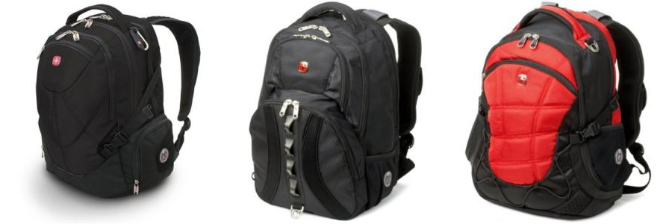

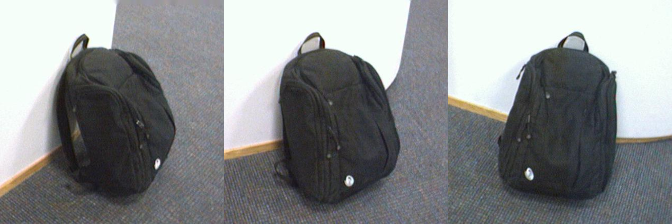

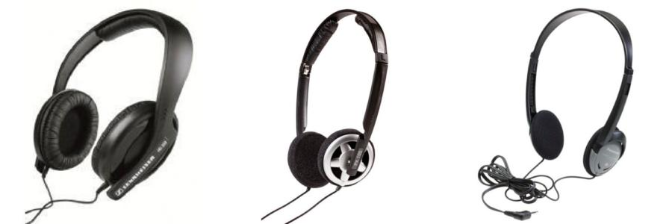

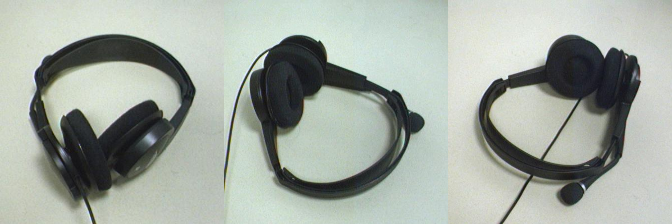

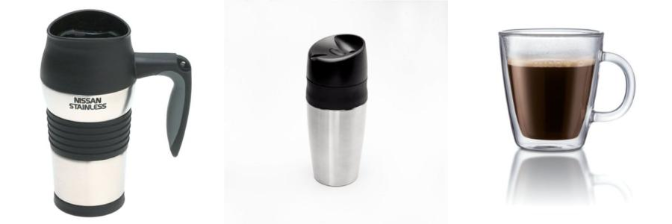

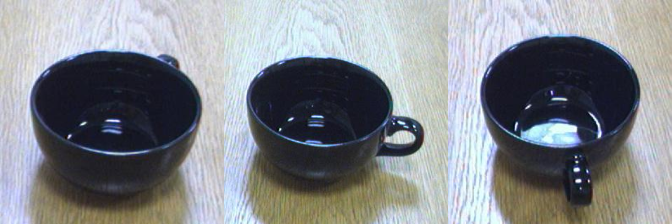

In [ ]:
show_images(f'{unzipped_dataset_office31}/amazon','back_pack',3)
show_images(f'{unzipped_dataset_office31}/webcam','back_pack',3)
show_images(f'{unzipped_dataset_office31}/amazon','headphones',3)
show_images(f'{unzipped_dataset_office31}/webcam','headphones',3)
show_images(f'{unzipped_dataset_office31}/amazon','mug',3)
show_images(f'{unzipped_dataset_office31}/webcam','mug',3)

## Mean and Standard deviance


In [ ]:
def compute_mean_std(dataloader: Iterable, len_dataloader: int, img_size: int) -> Tuple[int, int]:
    ####### COMPUTE MEAN / STD

    # placeholders
    psum    = torch.tensor([0.0, 0.0, 0.0])
    psum_sq = torch.tensor([0.0, 0.0, 0.0])

    # loop through images
    for (inputs, labels) in tqdm(dataloader):
        psum    += inputs.sum(axis        = [0, 2, 3])
        psum_sq += (inputs ** 2).sum(axis = [0, 2, 3])

    ####### FINAL CALCULATIONS

    # pixel count
    count = len_dataloader * img_size * img_size

    # mean and std
    total_mean = psum / count
    total_var  = (psum_sq / count) - (total_mean ** 2)
    total_std  = torch.sqrt(total_var)

    # output
    print('mean: '  + str(total_mean))
    print('std:  '  + str(total_std))

    return total_mean, total_std

In [ ]:
def get_loader_for_mean_std(root: str, img_size: int = 512, num_workers: int = 4, batch_size: int = 8) -> Iterable:

    transformations_sequence = list()
    transformations_sequence.append(transforms.Resize((img_size, img_size)))         
    transformations_sequence.append(transforms.ToTensor())                               
    transformations_sequence.append(transforms.Normalize(mean=(0, 0, 0), std=(1, 1, 1))) 
    composed_transformation = transforms.Compose(transformations_sequence) 

    dataset = datasets.ImageFolder(root, composed_transformation)
    return dataset, torch.utils.data.DataLoader(dataset, batch_size)

In [ ]:
def get_mean_std(img_size: int = 512, batch_size: int = 8):
    ds = []
    tot_len = 0  
    for cl in ["amazon", "webcam"]:
        dataset, dataloader = get_loader_for_mean_std(f"{unzipped_dataset_office31}/{cl}", img_size=img_size, batch_size=batch_size)
        ds.append(dataset)
        tot_len += len(dataset)
        mean, std = compute_mean_std(dataloader, len(dataset), img_size=img_size)

    dataset = torch.utils.data.ConcatDataset(ds)
    dataloader = torch.utils.data.DataLoader(dataset, batch_size)
    mean, std = compute_mean_std(dataloader, tot_len, img_size=img_size)
    return mean, std
      

In [ ]:
'''
amazon
mean: tensor([0.7923, 0.7862, 0.7842])
std:  tensor([0.3158, 0.3183, 0.3201])

webcam
mean: tensor([0.6120, 0.6188, 0.6173])
std:  tensor([0.2519, 0.2567, 0.2590])

concat
mean: tensor([0.7527, 0.7494, 0.7474])
std:  tensor([0.3120, 0.3136, 0.3154])
'''

'\namazon\nmean: tensor([0.7923, 0.7862, 0.7842])\nstd:  tensor([0.3158, 0.3183, 0.3201])\n\nwebcam\nmean: tensor([0.6120, 0.6188, 0.6173])\nstd:  tensor([0.2519, 0.2567, 0.2590])\n\nconcat\nmean: tensor([0.7527, 0.7494, 0.7474])\nstd:  tensor([0.3120, 0.3136, 0.3154])\n'

In [ ]:
mean, std = get_mean_std()

  0%|          | 0/353 [00:00<?, ?it/s]

mean: tensor([0.7923, 0.7862, 0.7842])
std:  tensor([0.3158, 0.3183, 0.3201])


  0%|          | 0/100 [00:00<?, ?it/s]

mean: tensor([0.6120, 0.6188, 0.6173])
std:  tensor([0.2519, 0.2567, 0.2590])


  0%|          | 0/452 [00:00<?, ?it/s]

mean: tensor([0.7527, 0.7494, 0.7474])
std:  tensor([0.3120, 0.3136, 0.3154])


## Data Loaders

We will need to instantiate our `Dataloader` classes for both `real_life` and `product_images`. In his case we use `ImageFolder` as dataset class and `train_test_split`in order to get a stratified dataset divison in train and test sets. Batch sizes of 128 are used. The dataset is split in 80% for training and 20% for testing. No validation set is used as the dataset we have is already very small.

In [ ]:
class ImageFolderWithIndices(datasets.DatasetFolder):

    def __init__(
        self,
        root: str,
        transform: Optional[Callable] = None,
        target_transform: Optional[Callable] = None,
        loader: Callable[[str], Any] = datasets.folder.default_loader,
        is_valid_file: Optional[Callable[[str], bool]] = None,
    ):
        super().__init__(
            root,
            loader,
            datasets.folder.IMG_EXTENSIONS if is_valid_file is None else None,
            transform=transform,
            target_transform=target_transform,
            is_valid_file=is_valid_file,
        )
        self.imgs = self.samples

    def __getitem__(self, index: int) -> Tuple[Any, Any]:
        path, target = self.samples[index]
        sample = self.loader(path)
        if self.transform is not None:
            sample = self.transform(sample)
        if self.target_transform is not None:
            target = self.target_transform(target)

        return sample, target, index

In [ ]:
# function to divide the load the dataset and divide in train and test
def get_data(
    batch_size: int, 
    img_root: str, 
    apply_norm = True,
    apply_flip = True,
    resize: int = 256,
    rand_crop_size: int = 224,
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225], 
    train_percentage: float = 0.8, 
    val_percentage: float = 0.0, 
    test_percentage: float = 0.2, 
    random_state: int = None, 
    collate_fn = None):
    
    # prepare data transformations for the train loader
    transform = list()
    transform.append(transforms.Resize((resize, resize)))                       # resize each PIL image to 256 x 256
    transform.append(transforms.RandomCrop((rand_crop_size, rand_crop_size)))   # randomly crop a 224 x 224 patch
    if apply_flip:
        transform.append(transforms.RandomHorizontalFlip(0.5))                      # random mirroring
    transform.append(transforms.ToTensor())                                     # convert Numpy to Pytorch Tensor
    if apply_norm:
      transform.append(transforms.Normalize(mean=mean, std=std))                # normalize 


    transform = transforms.Compose(transform)                         
    # load data
    office31 = ImageFolderWithIndices(root=img_root, transform=transform)
    dataset_size = len(office31.samples)
    print(f"dataset size {dataset_size}")
    train_size = int(dataset_size*train_percentage)
    print(f"train set size {train_size}")
    val_size = int(dataset_size*val_percentage)
    print(f"val set size {val_size}")
    test_size = dataset_size - val_size - train_size 
    print(f"test set size {test_size}")
    train_data, test_data = train_test_split(office31,train_size=train_size+val_size,test_size=test_size,random_state=0,
                                           shuffle=True,stratify=office31.targets)
    
    # initialize dataloaders
    train_loader = torch.utils.data.DataLoader(train_data, batch_size, shuffle=True, collate_fn=collate_fn)
    test_loader = torch.utils.data.DataLoader(test_data, batch_size, shuffle=False,collate_fn=collate_fn)
    full_loader = torch.utils.data.DataLoader(office31, batch_size, shuffle=False,collate_fn=collate_fn)

    if val_size==0:
        return office31, full_loader, train_loader, test_loader,office31.class_to_idx
    
    else: 
        targets = [j for i,j in train_data]
        train_data,val_data = train_test_split(train_data,train_size=train_size,test_size=val_size,
                                            shuffle=True,stratify=targets)   
        train_loader = torch.utils.data.DataLoader(train_data, batch_size, shuffle=False,collate_fn=collate_fn)
        val_loader = torch.utils.data.DataLoader(val_data, batch_size, shuffle=False,collate_fn=collate_fn)
        return train_loader,val_loader, test_loader,office31.class_to_idx


In [ ]:
dataset_a, full_loader_a, train_loader_a, test_loader_a,class_mapping = get_data(
    BATCH_SIZE,
    img_root = f"{unzipped_dataset_office31}/amazon", 
    train_percentage=0.8,
    test_percentage=0.2, 
    random_state=seed)

dataset size 2817
train set size 2253
val set size 0
test set size 564


In [ ]:
dataset_w, full_loader_w, train_loader_w,test_loader_w,class_mapping = get_data(
    BATCH_SIZE,
    img_root = f"{unzipped_dataset_office31}/webcam", 
    train_percentage=0.8,
    test_percentage=0.2, 
    random_state=seed)

dataset size 795
train set size 636
val set size 0
test set size 159


## Plotting
This section contains plotting functions for error analysis. In particular we plot:

* TSNE It uses the t-distributed stochastic neighbour embedding. https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding 


<!---${\displaystyle p_{j\mid i}={\frac{\exp(-\lVert \mathbf {x} _{i}-\mathbf {x} _{j}\rVert ^{2}/2\sigma _{i}^{2})}{\sum _{k\neq i}\exp(-\lVert \mathbf {x} _{i}-\mathbf {x} _{k}\rVert ^{2}/2\sigma _{i}^{2})}}}$

${\displaystyle p_{ij}={\frac {p_{j\mid i}+p_{i\mid j}}{2N}}}$

${\displaystyle q_{ij}={\frac {(1+\lVert \mathbf {y} _{i}-\mathbf {y} _{j}\rVert ^{2})^{-1}}{\sum _{k}\sum _{l\neq k}(1+\lVert \mathbf {y} _{k}-\mathbf {y} _{l}\rVert ^{2})^{-1}}}}$

${\displaystyle \mathrm {KL} \left(P\parallel Q\right)=\sum _{i\neq j}p_{ij}\log {\frac {p_{ij}}{q_{ij}}}}$--->

* Confusion matrixes
* Confidence for class prediction

In [ ]:
def ref_labels(loader: Iterable) -> Iterable:
    data = []
    for i in loader:
        data.append(i[1])
    return np.concatenate(data,axis=0)

In [ ]:
def color_map(class_labels: Dict[str,int]) -> Dict[int,Tuple[int,int,int]]:
    colormap = {}
    for k,i in class_labels.items():
        i = i/len(class_labels)
        (h, s, v) = (0.0+i, 0.5, 1)
        (r, g, b) = colorsys.hsv_to_rgb(h, s, v)
        colormap[int (i * len(class_labels))] = (round(r,2),round(g,2),round(b,2))
    return colormap

In [ ]:
def color(labels: Iterable[str], colormap: Dict[int,Tuple[int,int,int]]) -> Iterable[Tuple[int,int,int]]:
    colors = []
    for i in labels:
        colors.append(colormap[i])
    return colors

In [ ]:
colormap = color_map(class_mapping)

In [ ]:
def eval_plot_source_target(extractor: nn.Module,
                            classifier: nn.Module,
                            source_loader: Iterable,
                            target_loader: Iterable,
                            cost_function: nn.Module,
                            class_mapping: Dict[str,int],
                            layers: Iterable[str] = ['avgpool'],
                            device: str ='cuda:0') -> Tuple[float,float,Iterable[Iterable],Iterable[Iterable],Tuple[Iterable,Iterable,Iterable],Tuple[Iterable,Iterable,Iterable]]:

    colormap = color_map(class_mapping)

    source_test_loss,source_test_accuracy,source_emb,source_out = test_step(extractor,classifier, source_loader, cost_function,device='cuda:0',features = layers,net_outputs=True)
    
    # source_test_loss = source_test_loss.cpu().detach().numpy()
    # source_test_accuracy = source_test_accuracy.cpu().detach().numpy()
    # source_emb = source_emb.cpu().detach().numpy()
    source_out = source_out.cpu().detach().numpy()
    ref_source = ref_labels(source_loader)
    # out_source = source_out.cpu().detach().numpy()
    e_source = source_emb[-1].squeeze().cpu().detach().numpy()

    target_test_loss,target_test_accuracy,target_emb,target_out = test_step(extractor,classifier, target_loader, cost_function,device='cuda:0',features = layers,net_outputs=True)
    # target_test_loss = target_test_loss.cpu().detach().numpy()
    # target_test_accuracy = target_test_accuracy.cpu().detach().numpy()
    # target_emb = target_emb.cpu().detach().numpy()
    target_out = target_out.cpu().detach().numpy()
    ref_target = ref_labels(target_loader)
    # out_target = target_out.cpu().detach().numpy()
    e_target = target_emb[-1].squeeze().cpu().detach().numpy()

    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(10, 10))

  
    tsne = TSNE(n_components=2,  learning_rate='auto', init='pca')
    tsne_out = tsne.fit_transform(np.concatenate((e_source,e_target),axis=0))
    tsne_out_source,tsne_out_target = tsne_out[:len(e_source)],tsne_out[-len(e_target):]
    # source
    # get ref labels
    source_ref_colors = color(ref_source,colormap)
    # get hyp labels
    source_hyp_colors = color(source_out,colormap)
    # compute TSNE
    # plot features
    ax1.scatter(tsne_out_source[:,0], tsne_out_source[:,1],c=source_ref_colors)
    ax1.set_title('Reference Embedding')
    # plot features
    ax2.scatter(tsne_out_source[:,0], tsne_out_source[:,1],c=source_hyp_colors)
    ax2.set_title('Hypothesis Embedding')
    # target
    # get ref labels
    target_ref_colors = color(ref_target,colormap)
    # get hyp labels
    target_hyp_colors = color(target_out,colormap)
    # compute TSNE
    #tsne = TSNE(n_components=2,  learning_rate='auto', init='pca')
    #tsne_out = tsne.fit_transform(target_features)
    # plot features
    ax3.scatter(tsne_out_target[:,0], tsne_out_target[:,1],c=target_ref_colors)
    ax3.set_title('Reference Embedding')
    # plot features
    ax4.scatter(tsne_out_target[:,0], tsne_out_target[:,1],c=target_hyp_colors)
    ax4.set_title('Hypothesis Embedding')
    
    
    plt.figtext(-0.25, 0.75, 'Source', fontsize = 14)
    plt.figtext(-0.25, 0.7, f'Accuracy: {source_test_accuracy:.2f}', fontsize = 14)
    plt.figtext(-0.25, 0.65, f'Loss: {source_test_loss:.2f}', fontsize = 14)
    plt.figtext(-0.25, 0.25, 'Target', fontsize = 14)
    plt.figtext(-0.25, 0.2, f'Accuracy: {target_test_accuracy:.2f}', fontsize = 14)
    plt.figtext(-0.25, 0.15, f'Loss: {target_test_loss:.2f}', fontsize = 14)

    markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for idx,color in colormap.items()]
    inv_map = {v: k for k, v in class_mapping.items()}
    plt.legend(markers, [inv_map[k] for k,v in colormap.items()], numpoints=1,loc=(1.25,0))
    
    fig.suptitle("TSNE of the embeddings", fontsize=14)
    plt.show()

    # classification report
    names = [k for k,v in class_mapping.items()]

    report_source = classification_report(ref_source,source_out,target_names=names,output_dict=True)
    df_source = pd.DataFrame(report_source).transpose()
    df_source=df_source.round(2)

    report_target = classification_report(ref_target,target_out,target_names=names,output_dict=True)
    df_target = pd.DataFrame(report_target).transpose()
    df_target = df_target.round(2)

    df1_styler = df_source.style.set_table_attributes("style='display:inline'").set_caption('source').set_table_styles([{
            'selector': 'caption',
            'props': [
                ('color', 'black'),
                ('font-size', '15px'),
                ('font-style', 'italic'),
                ('font-weight', 'bold'),
                ('text-align', 'center')
                ]
            }])
    
    df2_styler = df_target.style.set_table_attributes("style='display:inline'").set_caption('target').set_table_styles([{
            'selector': 'caption',
            'props': [
                ('color', 'black'),
                ('font-size', '15px'),
                ('font-style', 'italic'),
                ('font-weight', 'bold'),
                ('text-align', 'center')
                ]
            }])
    space = "\xa0" * 10
    display_html(df1_styler._repr_html_() + df2_styler._repr_html_(), raw=True)
    
    # confusion matrixes
    ground_source = torch.cat([j for i,j, _ in source_loader]).cpu().detach().numpy()
    ground_target = torch.cat([j for i,j, _ in target_loader]).cpu().detach().numpy()
    matrix_source = confusion_matrix(ground_source,source_out,labels=[v for k,v in class_mapping.items()])
    matrix_target = confusion_matrix(ground_target,target_out,labels=[v for k,v in class_mapping.items()])
    # return list of error images
    source_errors = np.not_equal(ground_source,source_out)
    source_errors_index = np.asarray(range(ground_source.shape[0]))[source_errors]
    source_predicted_error = source_out[source_errors]
    source_ground_error = ground_source[source_errors]

    target_errors = np.not_equal(ground_target,target_out)
    target_errors_index = np.asarray(range(ground_target.shape[0]))[target_errors]
    target_predicted_error = target_out[target_errors]
    target_ground_error = ground_target[target_errors]
    return source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,(source_errors_index,source_ground_error,source_predicted_error),(target_errors_index,target_ground_error,target_predicted_error)

In [ ]:
def confusion_matrix_plotter(matrix_source: Iterable[Iterable], matrix_target: Iterable[Iterable], class_mapping: Dict[str,int]) -> None:
    labels = [k for k,v in class_mapping.items()]
    fig = plt.figure(dpi=100)
    fig.set_figheight(10)
    fig.set_figwidth(20)
    plt.subplots_adjust(left=0.1,
                        bottom=0.1,
                        right=0.9,
                        top=0.9,
                        wspace=0.4,
                        hspace=0.4)
    for (i,j),name in zip(enumerate([matrix_source,matrix_target]),['Source','Target']):
        matrix = j
        ax = plt.subplot(1, 2, i+1)
        ax.xaxis.set_ticks_position('top')
        ax.title.set_text(name+ ' Confusion Matrix')
        heatmap = ax.pcolormesh(matrix, cmap=plt.cm.Blues)
        for i in range(matrix.shape[0]):
            if np.sum(matrix[i]) > 0.0:
                for j in range(matrix.shape[1]):
                    color = "white" if matrix[i, j] >= 0.5 else "black"
                    number = f"{matrix[i, j]:.0f}" 
                    plt.text(j+0.5, i+0.5, number, ha="center", va="center", color=color,) 
        plt.xticks([ i+0.5 for i in list(range(len(labels)))], labels,fontsize=12,rotation=90)
        plt.yticks([ i+0.5 for i in list(range(len(labels)))], labels,fontsize=12,rotation=0)
        plt.gca().invert_yaxis()
    plt.show()

In [ ]:
def prediction_confidence(extractor: nn.Module,
                          classifier: nn.Module,
                          loader: Iterable,
                          class_mapping: Dict[str,int],
                          colormap: Dict[int,Tuple[int,int,int]],
                          title: str = None,
                          device = 'cuda:0') -> None:
    outputs = {}
    for input,target in loader:
        out = extractor(input.to(device))
        out = classifier(out)
        for k,v in class_mapping.items():
            if k not in outputs:
                outputs[k] = [out[target==v].cpu().detach().numpy()]
            else:
                outputs[k].append(out[target==v].cpu().detach().numpy())
    for k,v in outputs.items():
        outputs[k] = np.concatenate(outputs[k],axis=0)
        outputs[k] = softmax(outputs[k],axis=1)
    labels = list(class_mapping.keys())
    x = np.arange(len(labels))
    width = 0.35  # the width of the bars
    fig = plt.figure(dpi=100)
    fig.set_figheight(50)
    fig.set_figwidth(50)
    fig.suptitle(title,size=48)
    for i,(label,v) in enumerate(class_mapping.items()):
        mean = np.mean(outputs[label],axis=0)
        min = np.min(outputs[label],axis=0)
        max = np.max(outputs[label],axis=0)
        std = np.std(outputs[label],axis=0)
        ax = plt.subplot(5, 4, i+1)
        plt.ylim([0, 1.0])
        plt.bar(x, mean, yerr=2*std, width=width,label='mean', align='center',alpha=0.5,color=colormap[v], ecolor='grey', capsize=3)
        # Add some text for labels, title and custom x-axis tick labels, etc.
        ax.set_title(label)
        ax.set_xticks(x)
        ax.set_xticklabels(labels)
        plt.xticks(rotation=90)
        ax.legend()
    plt.show()

In [ ]:
def show_error_images(loader: Iterable,
                      indexes: Iterable[int],
                      ground: Iterable[int],
                      predicted: Iterable[int],
                      class_mapping: Dict[str,int],
                      max_images: int = None) -> None:
    if max_images!=None:
        indexes = indexes[:max_images]
        ground = ground[:max_images]
        predicted = predicted[:max_images]
    inv_map = {v: k for k, v in class_mapping.items()}
    def get_concat_h(im1, im2):
        dst = Image.new('RGB', (im1.width + im2.width, im1.height))
        dst.paste(im1, (0, 0))
        dst.paste(im2, (im1.width, 0))
        return dst
    W, H = (224,224)
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    wrap = [i for i,j,_ in loader]
    count = 0
    batch_size=-1
    for i,j,_ in loader:
        count+=i.shape[0]
        if batch_size==-1:
            batch_size=i.shape[0]
    # from index to batch position
    for i,gr,pr in zip(indexes,ground,predicted):
        batch = i // batch_size
        in_batch = i % batch_size
        #print(batch)
        #print(in_batch)
        tensor = wrap[batch][in_batch]
        #print(tensor.shape)
        z = tensor * torch.tensor(std).view(3, 1, 1)
        z = z + torch.tensor(mean).view(3, 1, 1)
        img = transforms.ToPILImage(mode='RGB')(z)
        #img = transform(tensor)

        im = Image.new("RGBA",(W,H),"white")
        draw = ImageDraw.Draw(im)

        msg1 = "Predicted : " + inv_map[pr]
        msg2 = "Ground truth : " + inv_map[gr]
        draw.text((10,120+10), msg1, fill="black")
        draw.text((10,120-10), msg2, fill="black")

        label = get_concat_h(img,im)
        display(label)

## Magic 3D plotter

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d import proj3d
import matplotlib.pyplot as plt
from matplotlib import offsetbox
import numpy as np
import pylab
from PIL import Image
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from IPython import display
from os.path import join,exists
from os import mkdir
import io
from tqdm.auto import tqdm
def eval_plot_3D(extractor: nn.Module,
                            classifier: nn.Module,
                            source_loader: Iterable,
                            cost_function: nn.Module,
                            class_mapping: Dict[str,int],
                            path,
                            frame_step=5,
                            duration=100,
                            layers: Iterable[str] = ['avgpool'],
                            max_images=None,
                            plot_size=(20,20),
                            image_size=(24,24),
                            W_H = (224,224),
                            mean=[0.485, 0.456, 0.406],
                            std=[0.229, 0.224, 0.225],
                            device: str ='cuda:0') -> None:

    colormap = color_map(class_mapping)

    source_test_loss,source_test_accuracy,source_emb,source_out = test_step(extractor,classifier, source_loader, cost_function,device='cuda:0',features = layers,net_outputs=True)
    source_out = source_out.cpu().detach().numpy()
    ref_source = ref_labels(source_loader)
    e_source = source_emb[-1].squeeze().cpu().detach().numpy()

    tsne = TSNE(n_components=3,  learning_rate='auto', init='pca')
    tsne_out = tsne.fit_transform(e_source)
    # source
    # get ref labels
    source_ref_colors = color(ref_source,colormap)
    # get hyp labels
    source_hyp_colors = color(source_out,colormap)
    # compute TSNE
    # plot features
    source_errors = np.not_equal(ref_source,source_out)
    source_errors_index = np.asarray(range(ref_source.shape[0]))[source_errors]
    source_predicted_error = source_out[source_errors]
    source_ground_error = ref_source[source_errors]

    #fig = plt.figure(figsize=(20,20))
    fig = pylab.figure(figsize=plot_size)
    #ax = fig.add_subplot(111, projection=Axes3D.name)
    ax = fig.add_subplot(111, projection = '3d')
    ax.scatter(*tsne_out.T, c=source_ref_colors, marker="o")
    #ax.axis("off")
    # Create a dummy axes to place annotations to
    ax2 = fig.add_subplot(111,frame_on=False) 
    ax2.axis("off")
    ax2.axis([0,1,0,1])

    class ImageAnnotations3D():
        def __init__(self, xyz, imgs, ax3d,ax2d):
            self.xyz = xyz
            self.imgs = imgs
            self.ax3d = ax3d
            self.ax2d = ax2d
            self.annot = []
            for s,im in zip(self.xyz, self.imgs):
                x,y = self.proj(s)
                self.annot.append(self.image(im,[x,y]))
            self.lim = self.ax3d.get_w_lims()
            self.rot = self.ax3d.get_proj()
            self.cid = self.ax3d.figure.canvas.mpl_connect("draw_event",self.update)

            self.funcmap = {"button_press_event" : self.ax3d._button_press,
                            "motion_notify_event" : self.ax3d._on_move,
                            "button_release_event" : self.ax3d._button_release}

            self.cfs = [self.ax3d.figure.canvas.mpl_connect(kind, self.cb) \
                            for kind in self.funcmap.keys()]

        def cb(self, event):
            event.inaxes = self.ax3d
            self.funcmap[event.name](event)

        def proj(self, X):
            """ From a 3D point in axes ax1, 
                calculate position in 2D in ax2 """
            x,y,z = X
            x2, y2, _ = proj3d.proj_transform(x,y,z, self.ax3d.get_proj())
            tr = self.ax3d.transData.transform((x2, y2))
            return self.ax2d.transData.inverted().transform(tr)

        def image(self,arr,xy):
            """ Place an image (arr) as annotation at position xy """
            im = offsetbox.OffsetImage(arr, zoom=1)
            im.image.axes = ax
            ab = offsetbox.AnnotationBbox(im, xy, xybox=(-30., 30.),
                                xycoords='data', boxcoords="offset points",
                                pad=0.3, arrowprops=dict(arrowstyle="->"))
            self.ax2d.add_artist(ab)
            return ab

        def update(self,event):
            if np.any(self.ax3d.get_w_lims() != self.lim) or \
                            np.any(self.ax3d.get_proj() != self.rot):
                self.lim = self.ax3d.get_w_lims()
                self.rot = self.ax3d.get_proj()
                for s,ab in zip(self.xyz, self.annot):
                    ab.xy = self.proj(s)

    def show_error_images(loader: Iterable,
                        indexes: Iterable[int],
                        ground: Iterable[int],
                        predicted: Iterable[int],
                        class_mapping: Dict[str,int],
                        max_images: int = None,
                        image_size=(24,24),
                        W_H = (224,224),
                        mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225],
                        ) -> None:
        if max_images!=None:
            indexes = indexes[:max_images]
            ground = ground[:max_images]
            predicted = predicted[:max_images]
        inv_map = {v: k for k, v in class_mapping.items()}
        def get_concat_h(im1, im2):
            dst = Image.new('RGB', (im1.width + im2.width, im1.height))
            dst.paste(im1, (0, 0))
            dst.paste(im2, (im1.width, 0))
            return dst
        W, H = W_H
        mean= mean
        std= std
        wrap = [i for i,j,_ in loader]
        count = 0
        batch_size=-1
        for i,j,_ in loader:
            count+=i.shape[0]
            if batch_size==-1:
                batch_size=i.shape[0]
        # from index to batch position
        ls = []
        for i,gr,pr in zip(indexes,ground,predicted):
            batch = i // batch_size
            in_batch = i % batch_size
            tensor = wrap[batch][in_batch]
            z = tensor * torch.tensor(std).view(3, 1, 1)
            z = z + torch.tensor(mean).view(3, 1, 1)
            img = transforms.ToPILImage(mode='RGB')(z)
            label = img.resize(image_size)
            ls.append(np.asarray(label))
        return ls
    imgs = show_error_images(source_loader,source_errors_index,source_ground_error,source_predicted_error,class_mapping,max_images)
    ia = ImageAnnotations3D(tsne_out[source_out!=ref_source][:max_images,:],imgs,ax, ax2)
    folder = path
    im_frame = []
    pbar = tqdm(range(0, 360,frame_step))
    print("Rendering the GIF ...")
    for p,angle in zip(pbar,range(0, 360,frame_step)):
        ax.view_init(30, angle)
        img_buf = io.BytesIO()
        plt.savefig(img_buf, format='png')
        im = Image.open(img_buf)
        im_frame.append(im)
    print("Saving the GIF ...")
    im_frame[0].save(join(folder,"output.gif"), save_all=True, append_images=im_frame[1:], duration=duration, loop=0)
    with open(join(folder,"output.gif"),'rb') as f:
        display.Image(data=f.read(), format='png')

In [ ]:
!rm -r ./frames

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


  0%|          | 0/72 [00:00<?, ?it/s]

saving the GIF ...


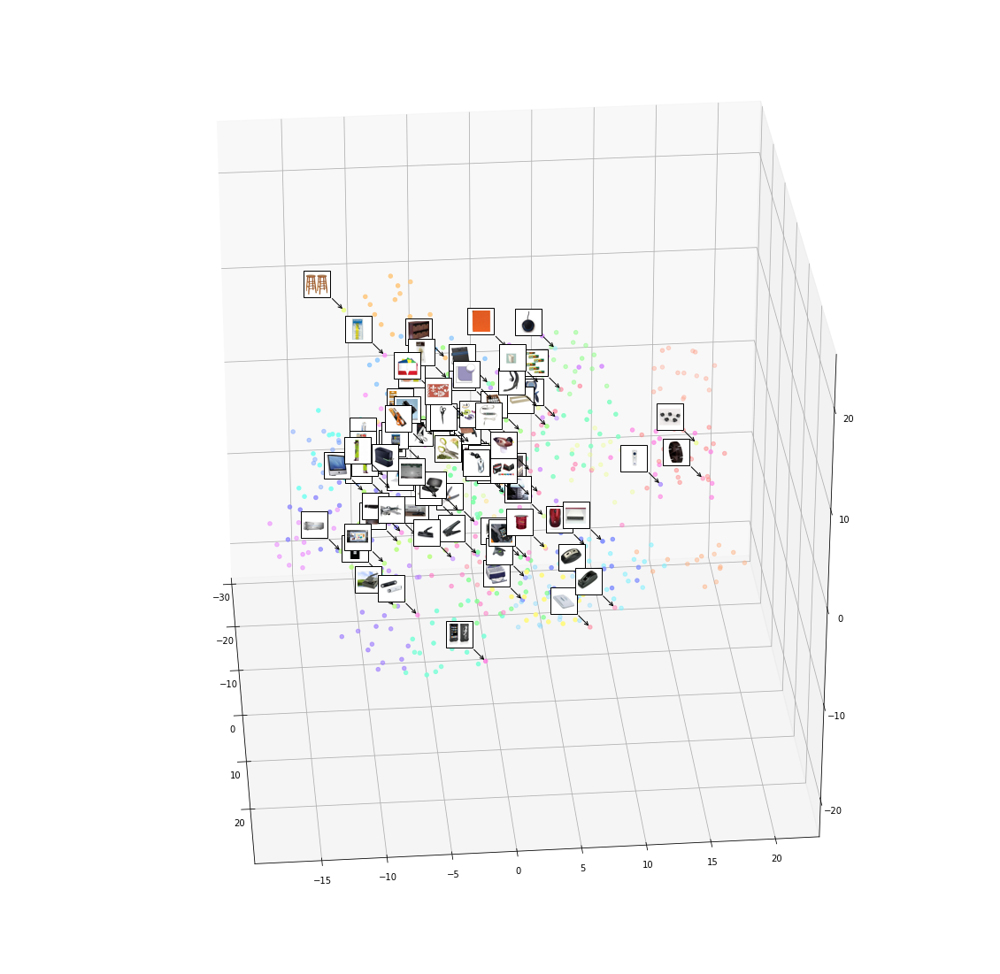

In [ ]:
cost_function = get_ce_loss()
eval_plot_3D(extractor,classifier,test_loader_a,cost_function,class_mapping,'./',frame_step=5,duration=100,layers=['identity'],device='cuda:0')

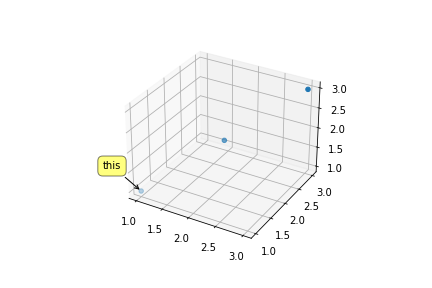

In [ ]:
import pylab
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d import proj3d
fig = pylab.figure()
ax = fig.add_subplot(111, projection = '3d')
x = y = z = [1, 2, 3]
sc = ax.scatter(x,y,z)
# now try to get the display coordinates of the first point

x2, y2, _ = proj3d.proj_transform(1,1,1, ax.get_proj())

label = pylab.annotate(
    "this", 
    xy = (x2, y2), xytext = (-20, 20),
    textcoords = 'offset points', ha = 'right', va = 'bottom',
    bbox = dict(boxstyle = 'round,pad=0.5', fc = 'yellow', alpha = 0.5),
    arrowprops = dict(arrowstyle = '->', connectionstyle = 'arc3,rad=0'))

def update_position(e):
    x2, y2, _ = proj3d.proj_transform(1,1,1, ax.get_proj())
    label.xy = x2,y2
    label.update_positions(fig.canvas.renderer)
    fig.canvas.draw()
fig.canvas.mpl_connect('button_release_event', update_position)
pylab.show()

## Shared components

In [ ]:
#@title Criterions
def get_ce_loss() -> nn.Module:
    return nn.CrossEntropyLoss()
def get_bce_loss() -> nn.Module:
    return nn.BCEWithLogitsLoss()

In [ ]:
#@title Model
class Extractor(nn.Module):
    def __init__(self, model: nn.Module):
        super().__init__()
        self.model = nn.Sequential(*(list(model.children())[:-1]))
    def forward(self, x: Tensor) -> Tensor:
        out = self.model(x)
        out = out.squeeze()
        return out



In [ ]:
#@title Test step
def test_step(extractor: nn.Module,
              classifier: nn.Module, 
              data_loader: Iterable, 
              cost_function: nn.Module, 
              device='cuda:0',
              features: Iterable[str] = None,
              net_outputs: bool = False) -> Tuple[float,float] or Tuple[float,float,Iterable[Tensor]] or Tuple[float,float,Iterable[Tensor],Iterable[Tensor]]:
    samples = 0.
    cumulative_loss = 0.
    cumulative_accuracy = 0.
    # set the network to evaluation mode
    extractor.eval() 
    classifier.eval()
    # disable gradient computation (we are only testing, we do not want our model to be modified in this step!)
    embeddings = []
    outs = []
    with torch.no_grad():
        # iterate over the test set
        for batch_idx, (inputs, targets, _) in enumerate(data_loader):
            # load data into GPU
            inputs = inputs.to(device)
            targets = targets.to(device)
            # forward pass
            if features:
                extracted = extractor(inputs)
                outputs,emb = classifier(extracted,features)
                for id,e in enumerate(emb):
                    if batch_idx==0:
                        embeddings.append(e)
                    else:
                        embeddings[id] = torch.cat([embeddings[id],e],dim=0)
            else:
                extracted = extractor(inputs)
                outputs = classifier(extracted)
            # loss computation
            loss = cost_function(outputs, targets)
            # fetch prediction and loss value
            samples+=inputs.shape[0]
            cumulative_loss += loss.item() # Note: the .item() is needed to extract scalars from tensors
            _, predicted = outputs.max(1)
            # compute accuracy
            cumulative_accuracy += predicted.eq(targets).sum().item()
            outputs = torch.argmax(outputs,dim=1)
            outs.append(outputs)
    outs = torch.cat(outs,dim=0)
    if features:
        if net_outputs:
            return float(cumulative_loss/samples), float(cumulative_accuracy/samples*100),embeddings,outs
        else:
            return float(cumulative_loss/samples), float(cumulative_accuracy/samples*100),embeddings
    else:
        if net_outputs:
            return float(cumulative_loss/samples), float(cumulative_accuracy/samples*100),outs
        else:
            return float(cumulative_loss/samples), float(cumulative_accuracy/samples*100)

In [ ]:
#@title Optimizer
def get_optimizer(model: nn.Module, lr: float, wd: float):
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=wd)
    return optimizer

def get_optimizer_params_list(params: List[Any], lr: float, wd: float):
    optimizer = torch.optim.Adam(params, lr=lr, weight_decay=wd)
    return optimizer

# used bu Self-Supervision UDA
def get_optimizer_ext_head(models_params: Tuple[nn.Module, nn.Module], lr: float, wd: float):
    extractor_params, head_params = models_params[0], models_params[1]
    # assign the distinct learning rates to each group of parameters
    optimizer = torch.optim.Adam([
        {'params': extractor_params},
        {'params': head_params, 'lr': lr}
    ], lr=lr / 10, weight_decay=wd)
    return optimizer

In [ ]:
lr_lambda = lambda e: torch.pow(1 + alpha * (e / epochs)**beta, -1)
def get_scheduler(optim: Any, lr_lambda: Callable):
    return torch.optim.lr_scheduler.LambdaLR(optim, lr_lambda=lr_lambda)

# Source-only scenario

Here we start from a test a simple ResNET18 without domain adaptation to get a baseline to compare the results.

We train the model using a simple Cross Entropy Loss.

$CE = -\sum\limits_{i}\limits^{M} y_i log(p(y_i)) $
where $M$ is the number of classes

In [ ]:
def get_ce_loss() -> nn.Module:
    return nn.CrossEntropyLoss()

In [ ]:
class Extractor(nn.Module):
    def __init__(self, model: nn.Module):
        super().__init__()
        self.model = nn.Sequential(*(list(model.children())[:-1]))
    def forward(self, x: Tensor) -> Tensor:
        out = self.model(x)
        out = out.squeeze()
        return out

In [ ]:
class Classifier(nn.Module):
    def __init__(self, input, n_classes : int ,layers:Iterable[str] = None) -> None:
        super().__init__()
        self.identity = torch.nn.Identity()
        self.fc = torch.nn.Linear(in_features=input,out_features=n_classes)
        self.layers = layers
        if layers != None:
            self._features = {layer: torch.empty(0) for layer in layers}
            for layer_id in layers:
                layer = dict([*self.named_modules()])[layer_id]
                layer.register_forward_hook(self.save_outputs_hook(layer_id))

    def save_outputs_hook(self, layer_id: str) -> Callable:
        def fn(_, __, output):
            self._features[layer_id] = output
        return fn

    def forward(self, x: Tensor,layers : Iterable[str] = None) -> Tensor or Tuple[Tensor,Iterable[Tensor]]:
        out = x
        out = self.identity(out)
        out = self.fc(out)
        if layers == None:
            return  out
        else:
            feature_list = []
            for i in layers:
                if self.layers != None and i in self.layers:
                    feature_list.append(self._features[i])
                if i not in self.layers:
                    raise NameError(f"{i} is not a valid layer or it was not stated in __init__")
            return out, feature_list

## Training Steps

In [ ]:
def training_source_only_step(extractor: nn.Module,
                  classifier: nn.Module, 
                  source_data_loader: Iterable, 
                  optimizer_extractor: Any,
                  optimizer_classifier: Any,
                  ce_cost_fun: nn.Module,
                  device='cuda:0') -> Tuple[float,float]:
  source_samples = 0.
  cumulative_ce_loss = 0.
  cumulative_accuracy = 0.
  # strictly needed if network contains layers which has different behaviours between train and test
  classifier.train()
  extractor.train()
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a,(batch_idx, (inputs, targets,_)) in zip(pbar,enumerate(source_data_loader)):
    # loads data inot gpu
    inputs = inputs.to(device)
    targets = targets.to(device)
    # forward pass. I require in out the embeddings of the last layer(avgpool)
    extracted = extractor.forward(inputs)
    source_output = classifier.forward(extracted)
    
    # apply the losses
    ce_loss = ce_cost_fun(source_output,targets)
    # backward pass
    ce_loss.backward()
    # update parameters
    optimizer_extractor.step()
    optimizer_classifier.step()
    # reset the optimizer
    optimizer_extractor.zero_grad()
    optimizer_classifier.zero_grad()
    # print statistics
    source_samples+=inputs.shape[0]
    cumulative_ce_loss += ce_loss.item()
    _, predicted = source_output.max(1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return float(cumulative_ce_loss/source_samples), float(cumulative_accuracy/source_samples*100)


In [ ]:
def train_source_only(extractor: nn.Module, 
          classifier: nn.Module,
          source_train_loader: Iterable,
          source_test_loader: Iterable,
          ce_cost_function: nn.Module,
          optimizer_extractor: Any,
          optimizer_classifier: Any,
          epochs: int,
          device='cuda:0') -> Tuple[nn.Module,nn.Module]:
  # range over the number of epochs
  pbar = tqdm(range(1,epochs+1),position=0, leave=True)

  alpha, beta = 10, 0.75
  # lr_lambda = lambda e: torch.pow(1 + alpha * (e / epochs)**beta, -1)
  # sched = torch.optim.lr_scheduler.LambdaLR(optim, lr_lambda=lr_lambda)

  for e in pbar:
    ce_train_loss, train_accuracy = training_source_only_step(extractor,classifier, source_train_loader,
                                                                 optimizer_extractor,optimizer_classifier, 
                                                                 ce_cost_function,
                                                                 device=device)
    source_test_loss, source_test_accuracy = test_step(extractor,classifier, source_test_loader, ce_cost_function,device=device)

    # sched.step()

    pbar.set_description(str({
    'CE Training loss': f'{ce_train_loss:.5f}',
    'Training accuracy': f'{train_accuracy:.2f}',    
    'Source Test loss': f'{source_test_loss:.5f}',
    'Source Test accuracy': f'{source_test_accuracy:.2f}', 
    }))
  return extractor,classifier

## Finetune ResNet18 on A only

We train a model of ResNet18 on real life examples only

In [ ]:
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES).to(device)
optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)
ce_cost_function = get_ce_loss()
ex = train_source_only(extractor,
           classifier,
           train_loader_a,
           test_loader_a, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           epochs=50, 
           device=device)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_ex_a_path)
torch.save(classifier.state_dict(), resnet18_cl_a_path)

In [ ]:
!cp $resnet18_ex_a_path $models_basepath
!cp $resnet18_cl_a_path $models_basepath

### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_ex_a_path  ./
!cp $models_basepath$resnet18_cl_a_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_ex_a_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_cl_a_path))
classifier.to(device)
classifier.eval()

###Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


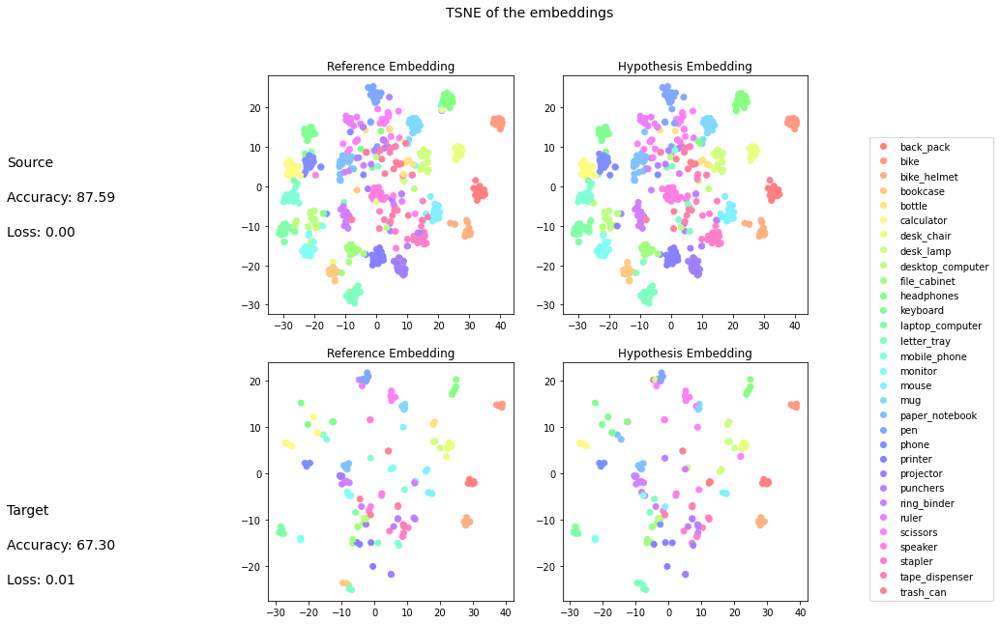

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,1.00,1.00,14.00
bookcase,0.93,0.88,0.90,16.00
bottle,0.83,0.71,0.77,7.00
calculator,1.00,0.95,0.97,19.00
desk_chair,0.94,0.83,0.88,18.00
desk_lamp,0.94,0.85,0.89,20.00
desktop_computer,0.80,0.84,0.82,19.00
file_cabinet,0.93,0.81,0.87,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

In [ ]:
prediction_confidence(extractor,classifier,test_loader_a,class_mapping,colormap,title='Confidence in label prediction Source',device='cuda:0')

In [ ]:
prediction_confidence(extractor,classifier,test_loader_w,class_mapping,colormap,title='Confidence in label prediction Target',device='cuda:0')

## Finetune ResNet18 on W only

Here we train a model of ResNet18 on product images only

In [ ]:
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES).to(device)
optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)
ce_cost_function = get_ce_loss()
ex = train_source_only(extractor,
           classifier,
           train_loader_w,
           test_loader_w, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           epochs=50, 
           device=device)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_ex_w_path)
torch.save(classifier.state_dict(), resnet18_cl_w_path)

In [ ]:
!cp $resnet18_ex_w_path $models_basepath
!cp $resnet18_cl_w_path $models_basepath

### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_ex_w_path  ./
!cp $models_basepath$resnet18_cl_w_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_ex_w_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_cl_w_path))
classifier.to(device)
classifier.eval()

###Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


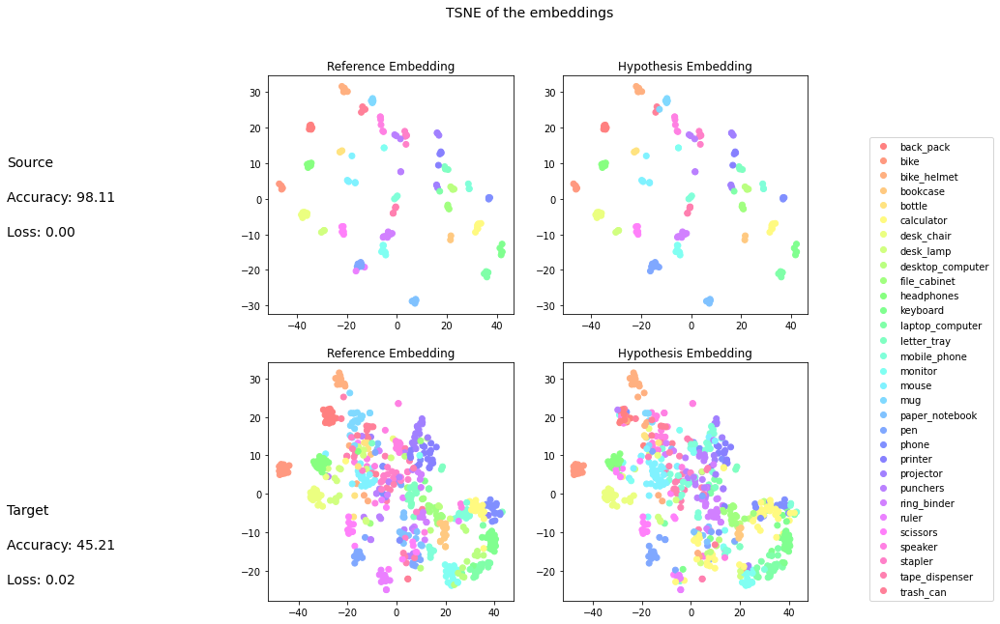

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors  = eval_plot_source_target(extractor,
                                                                                                                             classifier,
                                                                                                                             test_loader_w,
                                                                                                                             test_loader_a,
                                                                                                                             cost_function,
                                                                                                                             class_mapping,
                                                                                                                             layers=['identity'],
                                                                                                                             device='cuda:0')

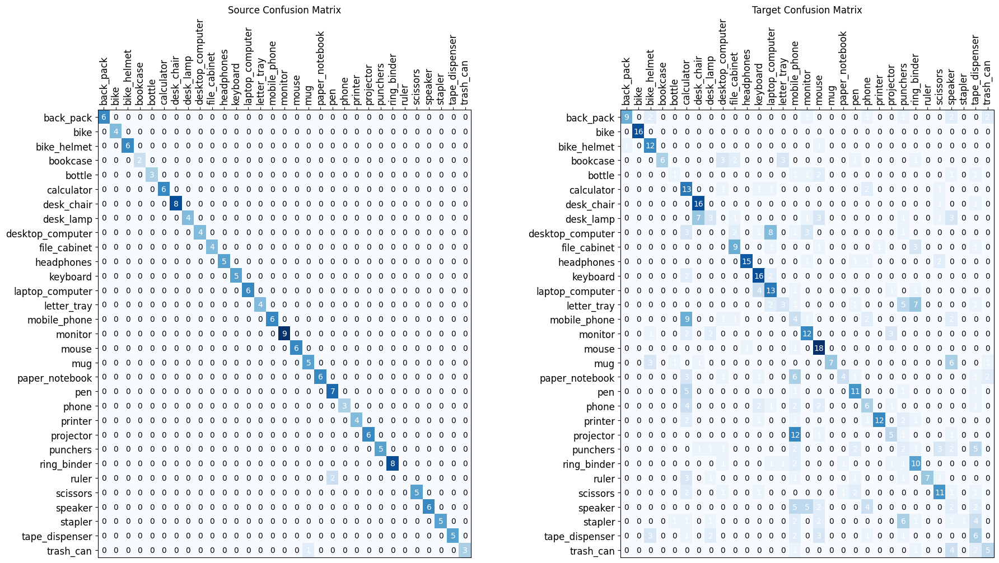

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

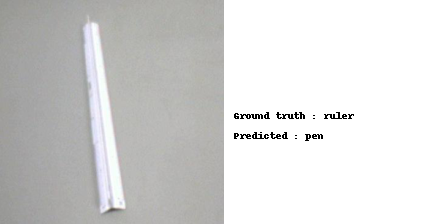

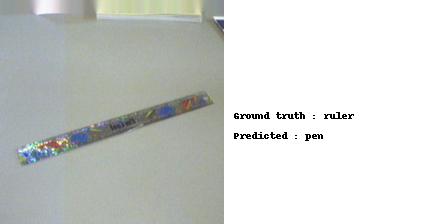

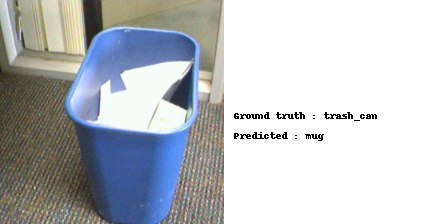

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

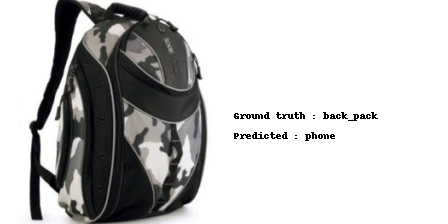

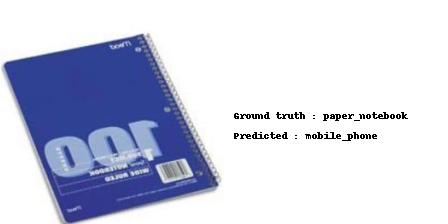

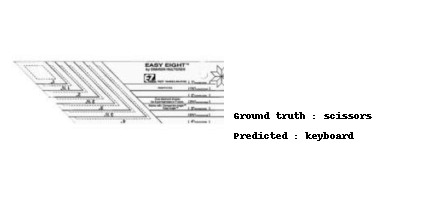

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## Comments

From these results, it is possible to understand that learning on `real_life` images leads to a better domain shifted prediction on `product_images`. However the opposite is not true. 

This effect is very likely caused by the "noise" ( illumination, background, crop, obstruction etc) present in `real_life` images that acts as a regularizer. Instead `product_images` are without noise and no background. 

Moreover this noise may also affect the upper limit of performances, as in `product_images` the network performs much better but at the same time has lower domain shifted results

Also, analyzing the values of activations before the softmax, is possible to notice that most labels are confidently classified correctly. However there are some classes that are significantly harder like `backpack` `purse` `stroller` where the model has a harder time differentiating the labels. The confidence of the model is significantly lower across all classes for the target domain and on `real_world` the confidence is much lower than `product_images`.

Also, across multiple runs we noticed a significant variance in test results in the direction `product_images`to `real_world`. Even with stratification, we still get results from 68% to 76% accuracy. This is likely because there are some images in the `real_world` dataset that are much harder than others, and if we are unlucky enough to get these in our test set or not. 
For this reason we later decided to permanently set a random seed to avoid this variance in between runs.

# AuxSelfTrain
>**[Gradual Domain Adaptation via Self-Training of Auxiliary Models](https://arxiv.org/abs/2106.09890)**
>
>*Zhang et al. 2021*

It is quite easy to understand that the greater the domain shift between source and target distributions, the more difficult it gets for a model trained on source data to perform well on target data. 

However, if the domain shift is reasonably small and we do have a good model for the source domain, we can obtain a reasonably effective auxiliary model for the target domain through self-training ([Kumar et al. 2020](https://arxiv.org/abs/2002.11361)), i.e. using the source model to produce pseudolabels for the target domain and then retraining the model using the pseudolabels as true targets.

Of course, reasonably small domain shift are rarely encountered in practice and this method is not effective, unless we have access to *intermediate domains* between source and target distributions. This work from Zhang et al. proposes a framework to build intermediate datasets by slowly increasing the proportion of samples drawn from the target distribution.


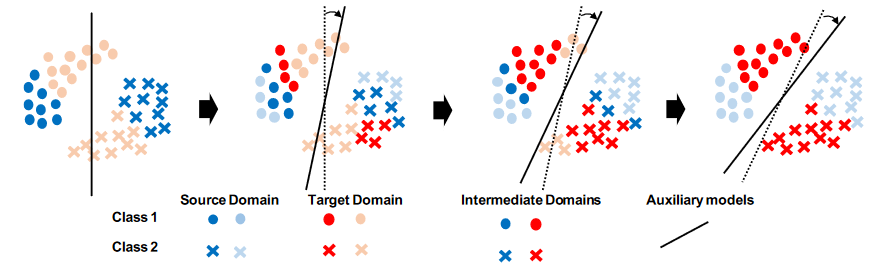

The paper also proposes some strategies to perform a better selection od which samples to draw.

**Target samples selection.** The idea here is to select those samples with the highest confidence pseudolabel prediction, based on the current model. This means that at step $m$ we will use the current auxiliary model $f_m$ to evaluate all the target samples $\mathcal{C}_t$ and pick as pseudolabel the highest confidence prediction: $c_t(x_i^t, f_m) = argmax(f_m(x_i^t))$. Amongst these, we will select the $\frac{m+1}{M}$ samples with highest confidence:

$$ v_i^t = \begin{cases} 1, & c_t(x_i^t,f_m) \in TOP_{(m+1)/M}(\mathcal{C_t})\\ 0, & otherwise \end{cases} $$

Note that the paper also proposes a model ensamble to compute pseudolabels. This enhancement is not considered in our implementation.

**Source samples selection.** In this case the idea is to drop those samples with larger domain shift first, i.e. farther to the target distribution. This is achieved by computing a class prototype $p_k$ for all classes $K$. The class prototype s sued to compute the prediction probability for all source samples:

$$ c_s(x_i^s, f_m) = \frac{\exp (1+ ||\phi_m (x_i^s) - p_{y_i^s} ||^2)^{-1}}{\sum_{k \in \mathcal{K}} \exp ( 1+ ||\phi_m (x_i^s) - p_k  ||^2)^{-1}}$$

Then, similarly as for target samples, the $(M - m + 1)/M$ source samples with highest $c_s(x_i^s, f_m)$ are selected.


## Model
In this case, we do not need anything fancy: we will use a basic combination of a feature extractor (our usual ResNet18 backbone pre-trained on ImageNet) and a classifier with one linear layer.

In [ ]:
class Classifier(nn.Module):
    def __init__(self, input, n_classes : int ,layers:Iterable[str] = None) -> None:
        super().__init__()
        self.identity = torch.nn.Identity()
        self.fc = torch.nn.Linear(in_features=input,out_features=n_classes)
        self.layers = layers
        if layers != None:
            self._features = {layer: torch.empty(0) for layer in layers}
            for layer_id in layers:
                layer = dict([*self.named_modules()])[layer_id]
                layer.register_forward_hook(self.save_outputs_hook(layer_id))

    def save_outputs_hook(self, layer_id: str) -> Callable:
        def fn(_, __, output):
            self._features[layer_id] = output
        return fn

    def forward(self, x: Tensor,layers : Iterable[str] = None) -> Tensor or Tuple[Tensor,Iterable[Tensor]]:
        out = x
        out = self.identity(out)
        out = self.fc(out)
        if layers == None:
            return  out
        else:
            feature_list = []
            for i in layers:
                if self.layers != None and i in self.layers:
                    feature_list.append(self._features[i])
                if i not in self.layers:
                    raise NameError(f"{i} is not a valid layer or it was not stated in __init__")
            return out, feature_list

## Dataset
The `IntermediateDataset` class implements the samples selection part. It exposes a very simple API to create the dataset given a source and a target dataset, update the current state and create dataloaders for source and target given the current state. 

In [ ]:
class IntermediateDataset(datasets.VisionDataset):
    """
    Custom dataset class that implements the samples selection mechanisms.
    
    Attributes
    ----------
    source_ds: Dataset
        source PyTorch dataset
    target_ds: Dataset
        target PyTorch dataset
    source_loader: DataLoader
        source PyTorch dataloader
    target_loader: DataLoader
        target PyTorch dataloader
    m_current: int
        counter of current step
    m_total:int
        total number of steps of the current experiment
    rand: int
        flag for ablation experiments. Default is -1 (no ablation)
    src_path: str
        path of the source dataset, used to check domain of __getitem__
    tgt_path: str
        path of the target dataset, used to check domain of __getitem__
    loader: Callable
        loader function to call when a sample is retrieved
    classes: Any
        class mapping of this dataset
    transform_src: List
        list of PyTorch transform pipeline to perform when loading source sample
    transform_tgt: List
        list of PyTorch transform pipeline to perform when loading target sample
    samples: List[Tuple[str, int]]
        list of samples in the dataset at current state, tuple of (path: str, target: int)
    targets: List[int]
        list of targets of the samples in the dataset at current state
    """
    def __init__(self, 
            root: str,
            source_ds: datasets.ImageFolder, 
            target_ds: datasets.ImageFolder,
            source_loader: torch.utils.data.DataLoader, 
            target_loader: torch.utils.data.DataLoader, 
            m_total: int = 10,
            rand: int = -1):
        super().__init__(root)
        self.source_ds = source_ds
        self.target_ds = target_ds
        self.source_loader = source_loader
        self.target_loader = target_loader
        self.m_current = 0
        self.m_total = m_total
        self.rand = rand

        self.src_path = source_ds.root
        self.tgt_path = target_ds.root

        self.loader = self.source_ds.loader # we use the default loader from datasets.DatasetFolder
        self.classes = self.source_ds.classes
        self.transform_src = source_ds.transform
        self.transform_tgt = target_ds.transform

        self.samples = self.source_ds.samples
        self.targets = self.source_ds.targets

    def get_dataloaders(
            self, 
            batch_size: int, 
            train_size: float = 0.8, 
            test_size: float = 0.2) -> Tuple[torch.utils.data.DataLoader, torch.utils.data.DataLoader]:
        """
        Splits data and produces train and test dataloaders, given current states

        Parameters
        ----------
        batch_size: int
            batch size of dataloaders
        train_size: float
            percentage of train split
        test_size: float
            percentage of test split

        Returns
        -------
        train_loader: DataLoader
            train dataloader
        test_loader: DataLoader
            test dataloader
        """
        print("Initializing dataloaders...")
        with torch.no_grad():
            train_data, test_data = train_test_split(self,train_size=train_size,test_size=test_size,random_state=0,
                                                shuffle=True,stratify=None)
            # initialize dataloaders
            train_loader = torch.utils.data.DataLoader(train_data, batch_size, shuffle=True)
            test_loader = torch.utils.data.DataLoader(test_data, batch_size, shuffle=False)

        return train_loader, test_loader


    def update_dataset(
            self, 
            extractor: nn.Module, 
            classifier: nn.Module) -> None:
        """
        Updates the state of the dataset given the current state of the auxiliary model.

        Parameters
        ----------
        extractor: nn.Module
            feature extractor at current state
        classifier: nn.Module
            classifier at current states
        """      
        if self.rand is not None:
            if self.rand not in { -1, 0, 1 }:
                raise ValueError("Unrecognized ablation parameter! Allowed: 0 (all random), 1 (source random)")
                
        print("Updating dataset...")
        self.m_current += 1
        ratio = int(len(self) * (self.m_current / self.m_total)) 
        
        print("Selecting target samples...")
        if self.rand is not None and self.rand != 0:
            target_samples, t_features, pseudolabels = self._select_target_samples(ratio, extractor, classifier)
        else:
            target_samples = self._random_select(ratio, self.target_ds.samples, extractor=extractor, classifier=classifier, target=True)

        print("Selecting source samples...")
        if self.rand is not None and self.rand not in { 0, 1 }:
            source_samples = self._select_source_samples(
                ratio, 
                extractor, 
                classifier, 
                t_features, 
                pseudolabels)
        else:
            source_samples = self._random_select(len(self)-ratio, self.source_ds.samples)
        
        self.samples = target_samples + source_samples
        self.targets = [s[1] for s in self.samples]
        print(f"Update done! Samples: {len(self)}")

    def _select_target_samples(
            self, 
            ratio: int, 
            extractor: nn.Module, 
            classifier: nn.Module) -> Tuple[List[Tuple[str, int]], List[Tensor], List[int]]:
        """
        Performs target sample selection by computing the pseudolabels
        on target data given the current state.

        Parameters
        ----------
        ratio: int
            percentage of target data to consider at current state
        extractor: nn.Module
            feature extractor at current state
        classifier: nn.Module
            classifier at current states

        Returns
        -------
        samples: List[Tuple[str, int]]
            list of tuples (path, pseudolable) of selected target samples
        features: List[Tensor]
            ordered feature maps of selected samples; save computation later
        pseudolabels: List[int]
            list of pseudolabels computed for target samples
        """      
        samples, features = self._compute_pseudolabels(extractor, classifier, self.target_loader) 
        samples = [(self.target_ds.samples[i][0], l) for (i, l) in samples]
        return samples[:ratio], features, [s[1] for s in samples]

    def _compute_pseudolabels(
            self, 
            extractor: nn.Module, 
            classifier: nn.Module, 
            dataloader: torch.utils.data.DataLoader) -> Tuple[List[int, int], List[Tensor]]:
        """
        Performs pseudolabel computation for samples of a given dataloader.

        Parameters
        ----------
        extractor: nn.Module
            feature extractor at current state
        classifier: nn.Module
            classifier at current states
        dataloader: DataLoader
            dataloader to perform pseudolabels computation on

        Returns
        -------
        samples: List[int, int]
            list of tuples (index, pseudolable) of selected target samples
        features: List[Tensor]
            ordered feature maps of selected samples; save computation later
        """      
        samples, indices, features, outputs, confidence = self._exec_inference(extractor, classifier, dataloader, clf=True)
        sorted_on_confidence = list(zip(samples, indices, features, outputs, confidence))
        sorted_on_confidence.sort(key= lambda x: x[4], reverse=True)
        samples, indices, features, outputs, confidence = zip(*sorted_on_confidence)
        return list(zip(indices,outputs)), features

    def _select_source_samples(
            self, 
            ratio: int, 
            extractor: nn.Module, 
            classifier: nn.Module, 
            t_features: List[Tensor], 
            pseudolabels: List[int]) -> List[Tuple[str, int]]:
        """
        Performs source sample selection by computing the prediction probability
        of source data given the current state.

        Parameters
        ----------
        ratio: int
            percentage of target data to consider at current state
        extractor: nn.Module
            feature extractor at current state
        classifier: nn.Module
            classifier at current states
        t_features: List[Tensor]
            ordered feature maps of selected target samples
        pseudolabels: List[int]
            list of pseudolabels computed for target samples

        Returns
        -------
        samples: List[Tuple[str, int]]
            list of tuples (path, pseudolable) of selected source samples
        """      
        _, indices, s_features, *_ = self._exec_inference(extractor, classifier, self.source_loader, clf=False)
        prototypes = self._compute_prototype_clf(t_features, pseudolabels, len(self.source_ds))

        pred_prob = [self._compute_prediction_probability(feat, self.source_ds.samples[i][1], prototypes) for feat, i in zip(s_features, indices)]
        pred_prob = torch.stack(pred_prob, dim=0).squeeze().tolist()
        samples = [i for i, _ in sorted(zip(indices, pred_prob), reverse=True, key = lambda elem: elem[1])]
        samples = [self.source_ds.samples[i] for i in samples]
        return samples[:len(self) - ratio]

    def _compute_prototype_clf(
            self, 
            features: List[Tensor], 
            pseudolabels: List[int], 
            num_classes: int) -> List[Tensor]:
        """
        Performs prortype computation.

        Parameters
        ----------
        features: List[Tensor]
            ordered feature maps of selected target samples
        pseudolabels: List[int]
            list of pseudolabels computed for target samples
        num_classes: int
            number of classes considered in the datasets

        Returns
        -------
        prototypes: List[Tensor]
            Computed prorotypes for the num_classes classes
        """      
        prototypes = [np.zeros_like(features[0]) for i in range(num_classes)]
        instance_count = [0 for i in range(num_classes)]
        for feat,label  in zip(features,pseudolabels):
            prototypes[label] += feat
            instance_count[label] += 1
        for proto,count in zip(prototypes,instance_count):
            if count!=0:
                proto/=count
        return [torch.tensor(i).to(device) for i in prototypes]

    def _compute_prediction_probability(
            self, 
            xs: Tensor, 
            target: int, 
            prototypes: List[Tensor]) -> Tensor:
        """
        Performs prediction probability (sort of a normalized softmax) 
        on a source sample given prototypes.

        Parameters
        ----------
        xs: Tensor
            feature map of current source sample
        target: int
            label of current source sample
        prototypes: List[Tensor] 
            list of prototypes, one for each class

        Returns
        -------
        pred_prob: Tensor
            computed prediction probablity of current sample 
        """
        xs = Tensor(xs).to(device)
        prototypes = torch.stack(prototypes)
        xs = xs.unsqueeze(dim=0)
        # like norm, but faster 
        dist = torch.cdist(xs, prototypes)
        dist += 1
        dist = 1/dist
        softmax = nn.Softmax(dim=1)
        output = softmax(dist)
        return output.squeeze()[target]

        
    def _exec_inference(
            self, 
            extractor: nn.Module, 
            classifier: nn.Module, 
            dataloader: torch.utils.data.DataLoader, 
            clf: bool = True) -> Tuple[List[np.ndarray], List[int], List[np.ndarray], List[np.ndarray], List[np.ndarray]]:
        """
        Performs inference prediction on samples from a given dataloader and
        returns several inference data.

        Parameters
        ----------
        extractor: nn.Module
            feature extractor at current state
        classifier: nn.Module
            classifier at current states
        dataloader: DataLoader
            dataloader to perform inference on
        clf: bool
            flag to control whether to perform full inference or stop
            after feature maps. Default: True
        
        Returns
        -------
        samples: List[np.ndarray]
            samples of the dataloader
        indices: List[int]
            indices of the samples in the dataset
        features: List[np.ndarray]
            extracted feature maps
        outputs: List[np.ndarray]
            predicted outputs, empty if clf=False
        confidence: List[np.ndarray]
            confidence of output predictions, empty if clf=False
        """
        extractor.eval()
        classifier.eval()

        outputs = []
        samples = []
        features = []
        confidence = []
        indices = []
        for batch_idx, (x, _, sample_idx) in enumerate(dataloader):
            feats = extractor(x.to(device))
            feats = feats.unsqueeze(0) if feats.dim() < 2 else feats
            if clf:
                preds = classifier(feats)
                preds = preds.unsqueeze(-1) if preds.dim() < 2 else preds
                confs, pseudolabels = preds.max(1)
                outputs.append(pseudolabels.detach().cpu().numpy())
                confidence.append(confs.detach().cpu().numpy())
                samples.append(x.detach().cpu().numpy())
            features.append(feats.detach().cpu().numpy())
            indices.append(sample_idx.numpy())

        indices = np.concatenate(indices, axis=0)
        features = np.concatenate(features, axis=0)
        if clf:
            samples = np.concatenate(samples,axis=0)
            outputs = np.concatenate(outputs,axis=0)
            confidence = np.concatenate(confidence, axis=0)
        return samples, indices, features, outputs, confidence

    def _random_select(
            self, 
            val: int, 
            dataset: datasets.ImageFolder, 
            extractor: nn.Module = None, 
            classifier: nn.Module = None, 
            target: bool = False) -> List[Tuple[str, int]]:
        """
        Performs a random selection of samples; if launched on the target 
        dataset, it also handles pseudolabel computation.

        Parameters
        ----------
        val: int
            percentage of samples to return 
            (ratio for target, len(self) - ratio for source)
        dataset: datasets.ImageFolder
            dataset from which to draw samples
        extractor: nn.Module
            feature extractor at current state
        classifier: nn.Module
            classifier at current states
        target: bool
            flag to set the source or target mode.
            Default: False (source)
        
        Returns
        -------
        samples: List[Tuple[str, int]]
            selected samples
        """
        if target:
            samples, _ = self._compute_pseudolabels(extractor, classifier, self.target_loader) 
            samples = [(self.target_ds.samples[i][0], l) for (i, l) in samples]
        else:
            samples = dataset
        random.shuffle(samples)
        return samples[:val]

    def __len__(self) -> int:
        """
        Required dunder for a child class of datasets.VisionDataset.
        Returns the length of the dataset at current state.
        Initial state: == len(self.source_ds.samples)
        Terminal state: == len(self.target_ds.samples)

        Returns
        -------
        length: int
            length of the dataset at current state
        """
        return len(self.samples)

    def __getitem__(self, index: int) -> Tuple[Tensor, int, int]:
        """
        Required dunder for a child class of datasets.VisionDataset.
        Retrieves the sample and performs different transform pipelines
        depending of whether it is from source or target dataset.

        Parameters
        ----------
        index: int
            index of requested sample

        Returns
        -------
        sample: Tensor
            trasformed sample
        target: int
            actual label of retrieved sample
        index: int
            index of requested sample

        Raises
        ------
        ValueError
            root directory of either source or target domain should appear
            in the path of the requested sample; 
            else, the sample does not exists
        """
        path, target = self.samples[index]
        sample = self.loader(path)
        path_split = path.split('/')
        if self.src_path.split('/')[-1] in path_split:
            sample = self.transform_src(sample)
        elif self.tgt_path.split('/')[-1] in path_split:
            sample = self.transform_tgt(sample)
        else:
            raise ValueError("Error in IntermediateDataset.__getitem__(index)")

        return sample, target, index

## Training step

In [ ]:
def training_step_ast(
    extractor: nn.Module,
    classifier: nn.Module,
    optimizer_ex: Any,
    optimizer_cl: Any,
    criterion: nn.Module,
    data_loader: Iterable,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  # target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  
  pbar = tqdm(range(len(data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs, targets,_)) in zip(pbar, enumerate(data_loader)):

    inputs = inputs.to(device)
    targets = targets.to(device)

    features = extractor(inputs)
    pred_class = classifier(features)

    loss_class = criterion(pred_class, targets)

    loss_class.backward()
    optimizer_ex.step()
    optimizer_cl.step()
    optimizer_ex.zero_grad()
    optimizer_cl.zero_grad()

    cumulative_loss += loss_class.item()

    samples += inputs.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, 


In [ ]:
def aux_self_train(
    extractor: nn.Module,
    classifier: nn.Module,
    optimizer_ex: Any,
    optimizer_cl: Any,
    ds_root: str,
    source_full_loader: Iterable,
    source_dataset: Any,
    target_full_loader: Iterable,
    target_dataset: Any,
    epochs=10,
    m_steps = 20,
    first_step_epochs=-1,
    rand=-1,
    device="cuda:0") -> Tuple[nn.Module, nn.Module]:
  
    extractor.to(device)
    classifier.to(device)

    ce_loss = get_ce_loss()

    dataset = IntermediateDataset(
        ds_root,
        source_ds=source_dataset,
        source_loader=source_full_loader,
        target_ds=target_dataset,
        target_loader=target_full_loader,
        m_total=m_steps,
        rand=rand
    )

    step_epochs = first_step_epochs if first_step_epochs > -1 else epochs

    pbar_m = tqdm(range(m_steps), position=0, leave=True)
    for pm, m in zip(pbar_m, range(m_steps)):

        train_loader, test_loader = dataset.get_dataloaders(BATCH_SIZE, train_size=0.8, test_size=0.2)
        
        pbar = tqdm(range(step_epochs),position=0, leave=True)
        for p,e in zip(pbar,range(step_epochs)):
            
            train_loss, train_accuracy = training_step_ast(
              extractor, 
              classifier,  
              optimizer_ex, 
              optimizer_cl, 
              ce_loss,
              train_loader,
              device=device) 

            test_loss, test_accuracy = test_step(
                extractor, 
                classifier, 
                test_loader, 
                cost_function=ce_loss)
            
            pbar.set_description(str({
            'Training loss': f'{train_loss:.5f}',
            'Training accuracy': f'{train_accuracy:.5f}',
            'Test loss': f'{test_loss:.5f}',
            'Test accuracy': f'{test_accuracy:.5f}',
            }))

        if m < m_steps:
            dataset.update_dataset(extractor, classifier) 
        if first_step_epochs > -1 and m == 0:
            step_epochs = epochs

    return extractor, classifier

## A -> W

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor, 
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    './office31',
    source_full_loader=full_loader_a,
    source_dataset=dataset_a,
    target_full_loader=full_loader_w,
    target_dataset=dataset_w,
    epochs=5,
    m_steps=25)

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_auxselftrain_ex_a_w_path)
torch.save(classifier.state_dict(), resnet18_auxselftrain_cl_a_w_path)

In [ ]:
!cp $resnet18_auxselftrain_ex_a_w_path $models_basepath
!cp $resnet18_auxselftrain_cl_a_w_path $models_basepath

### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_auxselftrain_ex_a_w_path  ./
!cp $models_basepath$resnet18_auxselftrain_cl_a_w_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_auxselftrain_ex_a_w_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_auxselftrain_cl_a_w_path))
classifier.to(device)
classifier.eval()

###Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


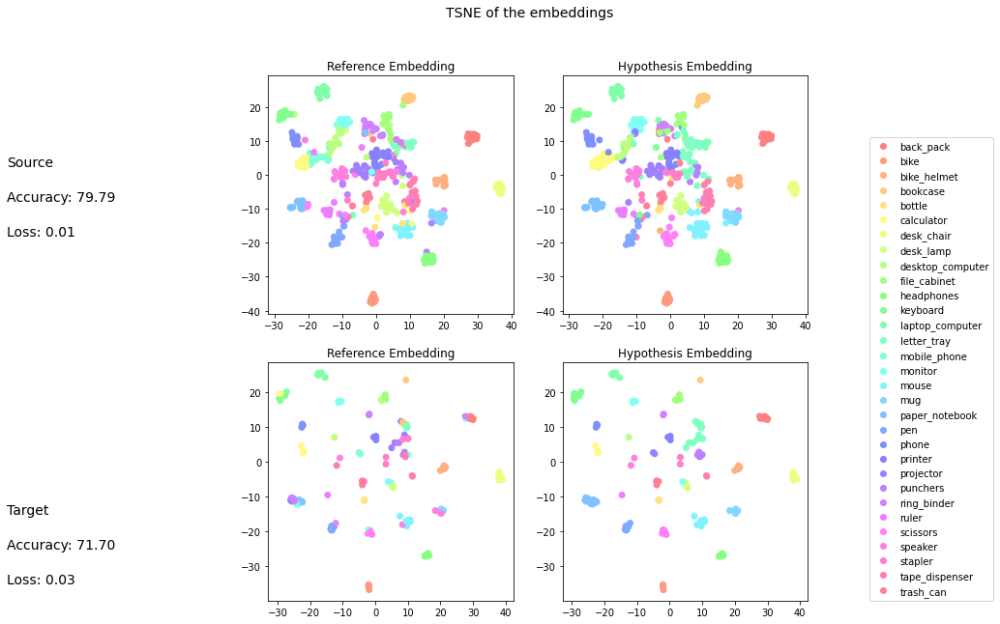

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,0.93,1.00,0.97,14.00
bookcase,0.94,0.94,0.94,16.00
bottle,0.83,0.71,0.77,7.00
calculator,0.62,0.95,0.75,19.00
desk_chair,1.00,0.89,0.94,18.00
desk_lamp,1.00,0.80,0.89,20.00
desktop_computer,0.67,0.42,0.52,19.00
file_cabinet,0.69,0.69,0.69,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

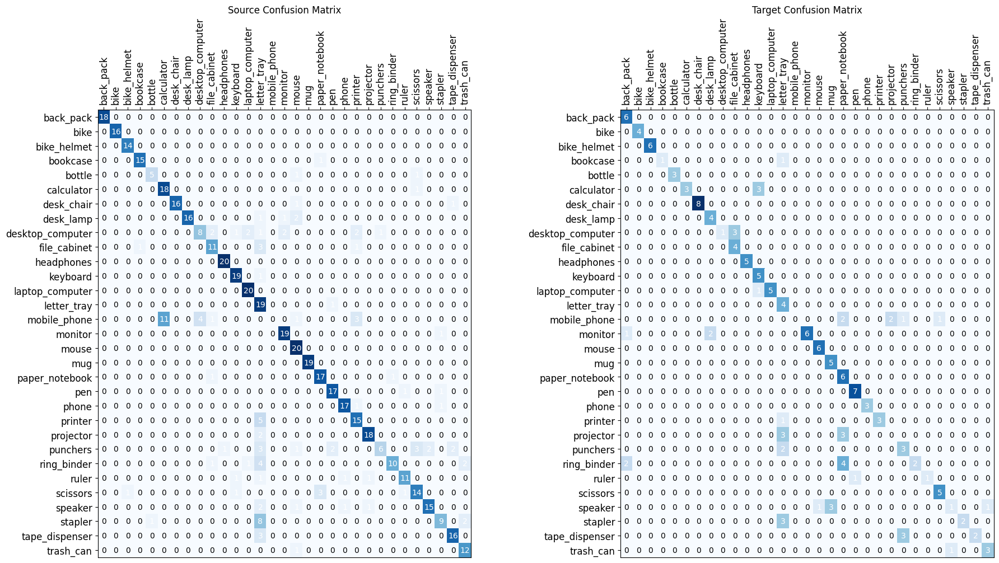

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

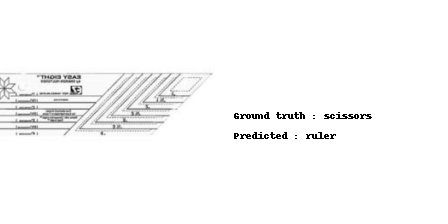

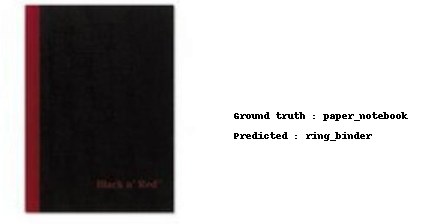

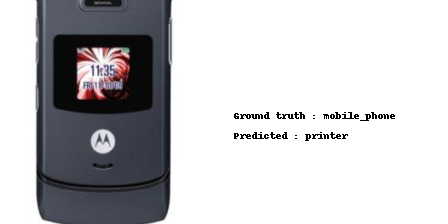

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

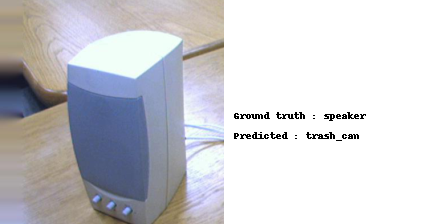

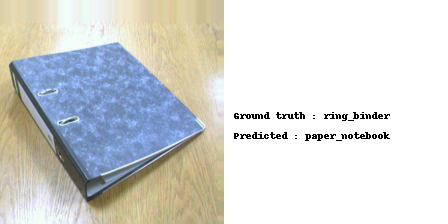

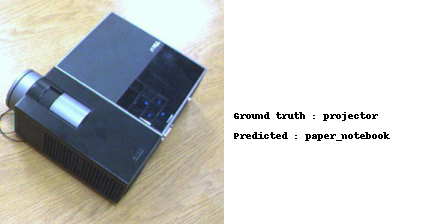

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

## W -> A

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor, 
    classifier, 
    optimizer_ex, 
    optimizer_cl,
    './office31' ,
    source_full_loader=full_loader_w,
    source_dataset=dataset_w,
    target_full_loader=full_loader_a,
    target_dataset=dataset_a,
    epochs=5,
    m_steps=25)

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_auxselftrain_ex_w_a_path)
torch.save(classifier.state_dict(), resnet18_auxselftrain_cl_w_a_path)

In [ ]:
!cp $resnet18_auxselftrain_ex_w_a_path $models_basepath
!cp $resnet18_auxselftrain_cl_w_a_path $models_basepath

### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_auxselftrain_ex_w_a_path  ./
!cp $models_basepath$resnet18_auxselftrain_cl_w_a_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_auxselftrain_ex_w_a_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_auxselftrain_cl_w_a_path))
classifier.to(device)
classifier.eval()

###Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


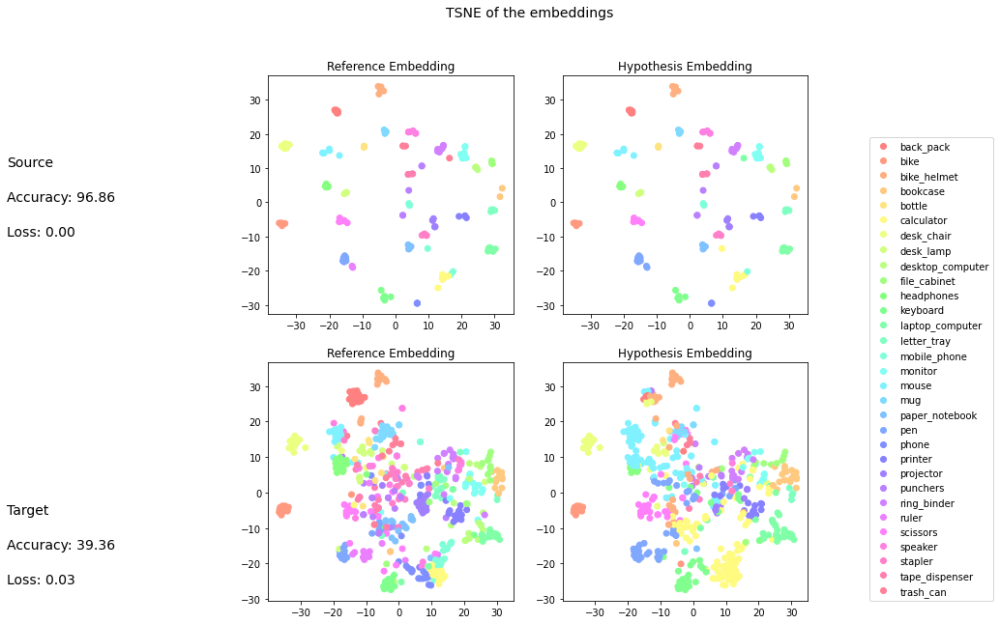

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,0.75,1.00,0.86,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

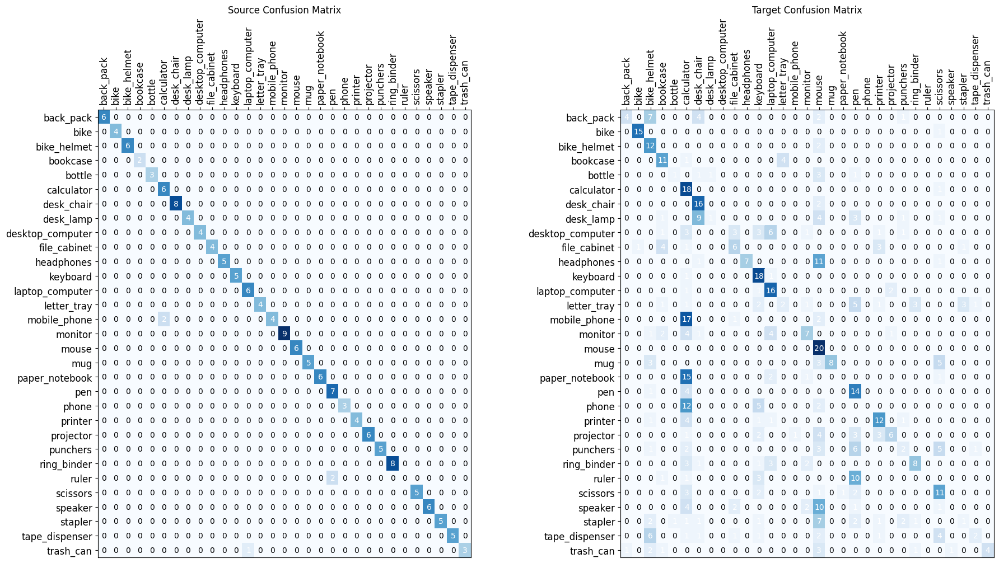

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

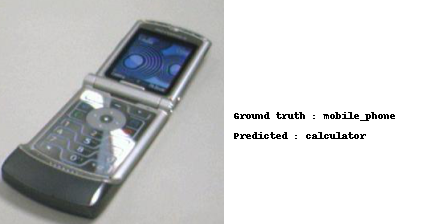

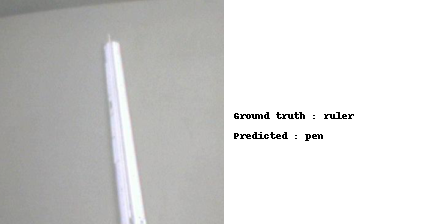

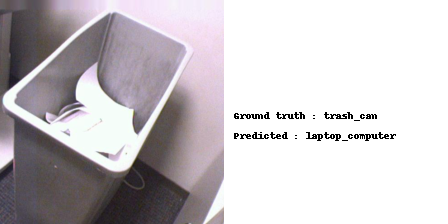

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

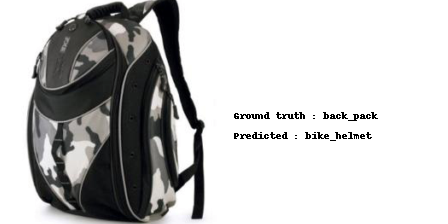

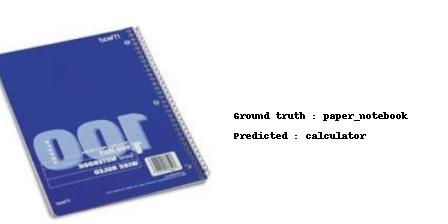

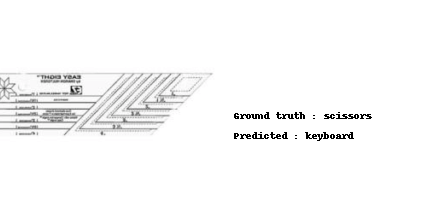

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## Ablations

### Random source samples selection

#### A -> W

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor, 
    classifier,
    optimizer_ex, 
    optimizer_cl, 
    unzipped_dataset_office31, 
    source_full_loader=full_loader_a,
    source_dataset=dataset_a,
    target_full_loader=full_loader_w,
    target_dataset=dataset_w,
    epochs=5,
    m_steps=25,
    rand=1)

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_auxselftrain_ex_a_w_abs_path)
torch.save(classifier.state_dict(), resnet18_auxselftrain_cl_a_w_abs_path)

In [ ]:
!cp $resnet18_auxselftrain_ex_a_w_abs_path $models_basepath
!cp $resnet18_auxselftrain_cl_a_w_abs_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_auxselftrain_ex_a_w_abs_path  ./
!cp $models_basepath$resnet18_auxselftrain_cl_a_w_abs_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_auxselftrain_ex_a_w_abs_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_auxselftrain_cl_a_w_abs_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


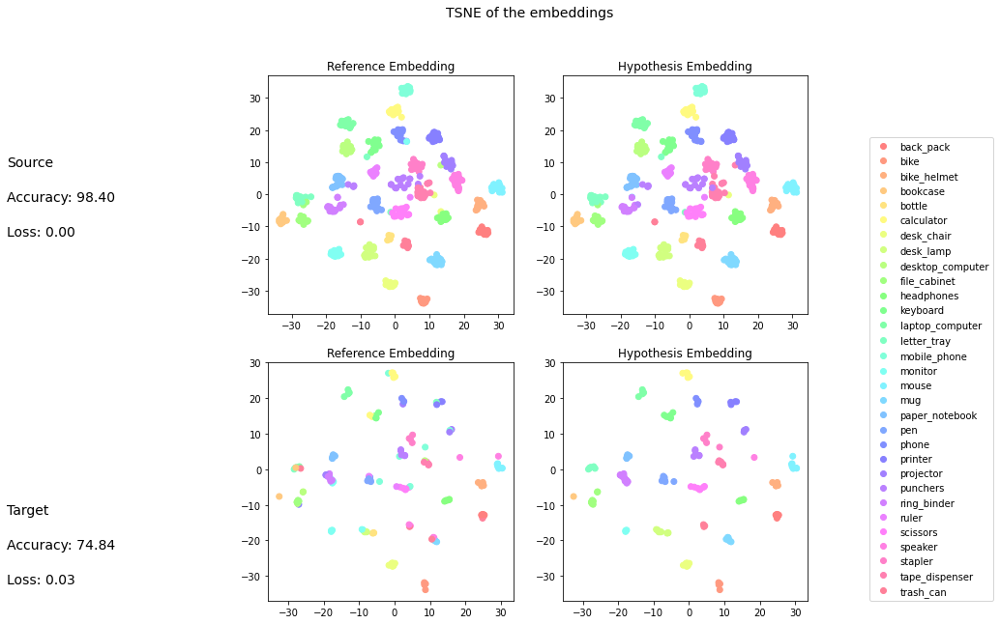

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,1.00,1.00,14.00
bookcase,1.00,1.00,1.00,16.00
bottle,1.00,1.00,1.00,7.00
calculator,1.00,1.00,1.00,19.00
desk_chair,1.00,0.94,0.97,18.00
desk_lamp,1.00,1.00,1.00,20.00
desktop_computer,1.00,0.95,0.97,19.00
file_cabinet,1.00,0.94,0.97,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

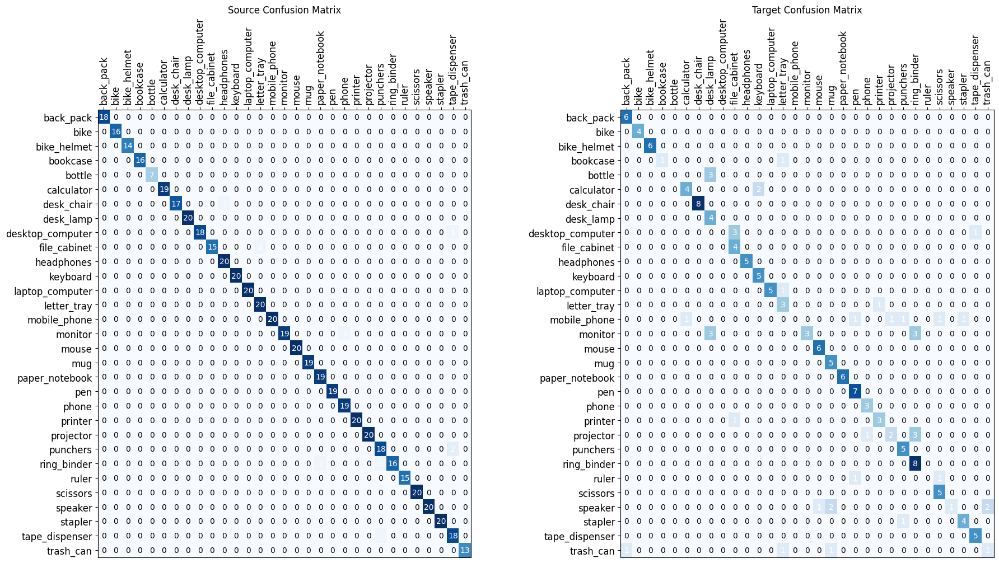

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

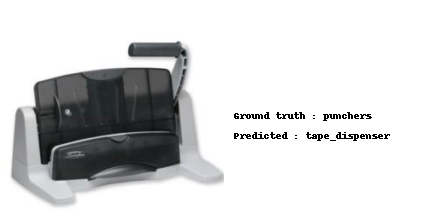

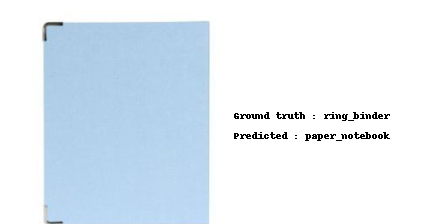

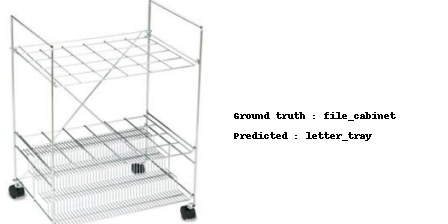

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

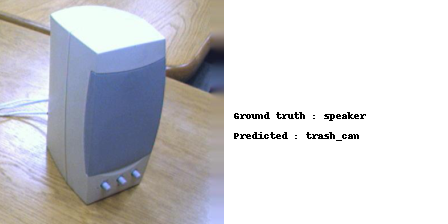

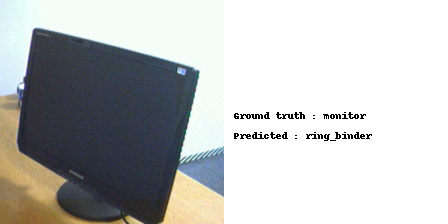

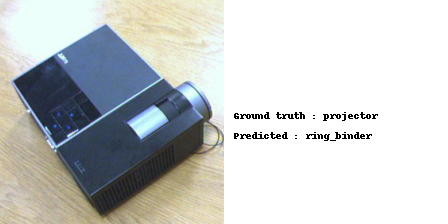

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

#### W -> A

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor, 
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    source_full_loader=full_loader_w,
    source_dataset=dataset_w,
    target_full_loader=full_loader_a,
    target_dataset=dataset_a,
    epochs=5,
    m_steps=25,
    rand=1)

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_auxselftrain_ex_w_a_abs_path)
torch.save(classifier.state_dict(), resnet18_auxselftrain_cl_w_a_abs_path)

In [ ]:
!cp $resnet18_auxselftrain_ex_w_a_abs_path $models_basepath
!cp $resnet18_auxselftrain_cl_w_a_abs_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_auxselftrain_ex_w_a_abs_path  ./
!cp $models_basepath$resnet18_auxselftrain_cl_w_a_abs_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_auxselftrain_ex_w_a_abs_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_auxselftrain_cl_w_a_abs_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


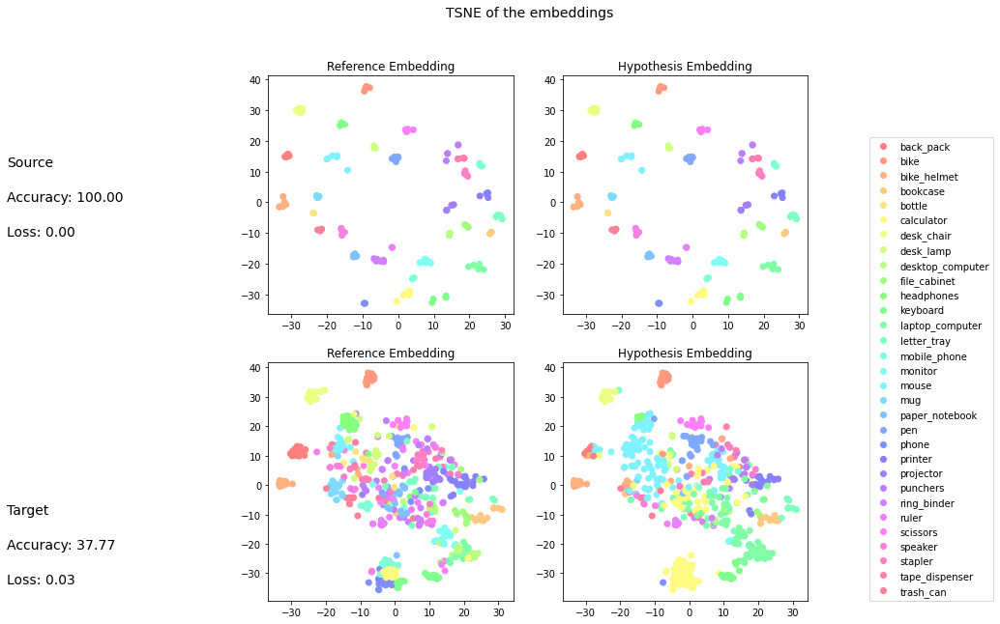

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

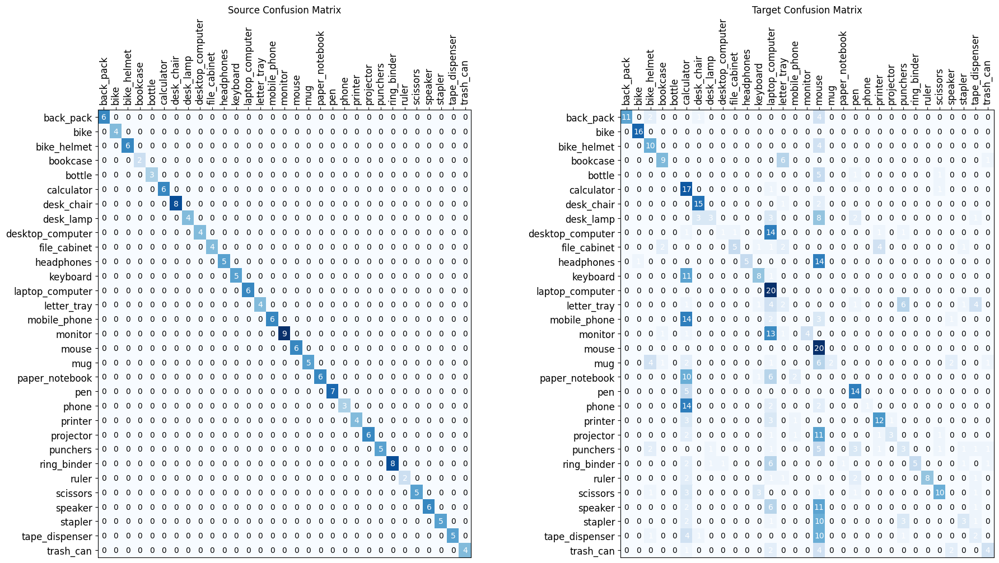

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

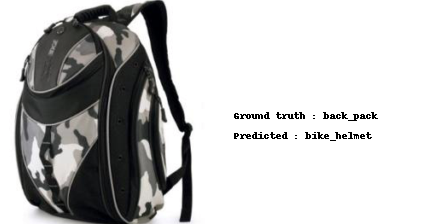

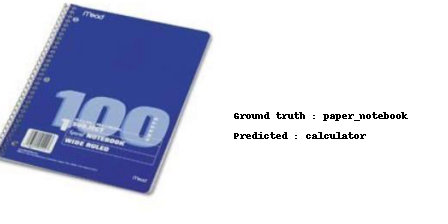

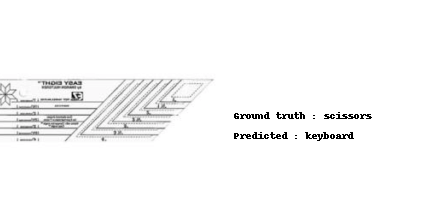

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

### Random samples selection

#### A -> W

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor, 
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    source_full_loader=full_loader_a,
    source_dataset=dataset_a,
    target_full_loader=full_loader_w,
    target_dataset=dataset_w,
    epochs=5,
    m_steps=25,
    rand=0)

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_auxselftrain_ex_a_w_abf_path)
torch.save(classifier.state_dict(), resnet18_auxselftrain_cl_a_w_abf_path)

In [ ]:
!cp $resnet18_auxselftrain_ex_a_w_abf_path $models_basepath
!cp $resnet18_auxselftrain_cl_a_w_abf_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_auxselftrain_ex_a_w_abf_path  ./
!cp $models_basepath$resnet18_auxselftrain_cl_a_w_abf_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_auxselftrain_ex_a_w_abf_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_auxselftrain_cl_a_w_abf_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


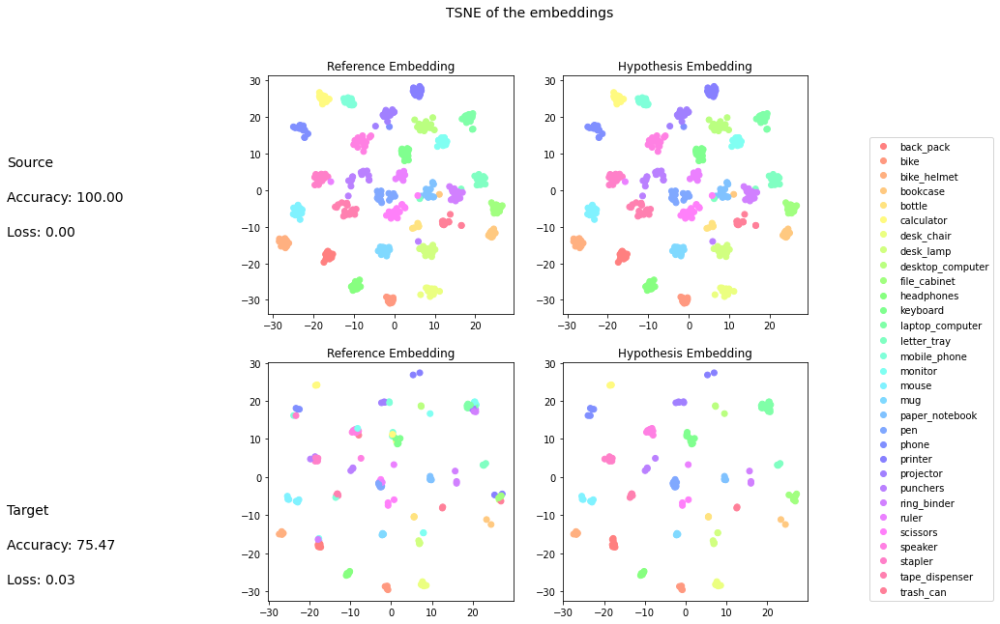

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,1.00,1.00,14.00
bookcase,1.00,1.00,1.00,16.00
bottle,1.00,1.00,1.00,7.00
calculator,1.00,1.00,1.00,19.00
desk_chair,1.00,1.00,1.00,18.00
desk_lamp,1.00,1.00,1.00,20.00
desktop_computer,1.00,1.00,1.00,19.00
file_cabinet,1.00,1.00,1.00,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

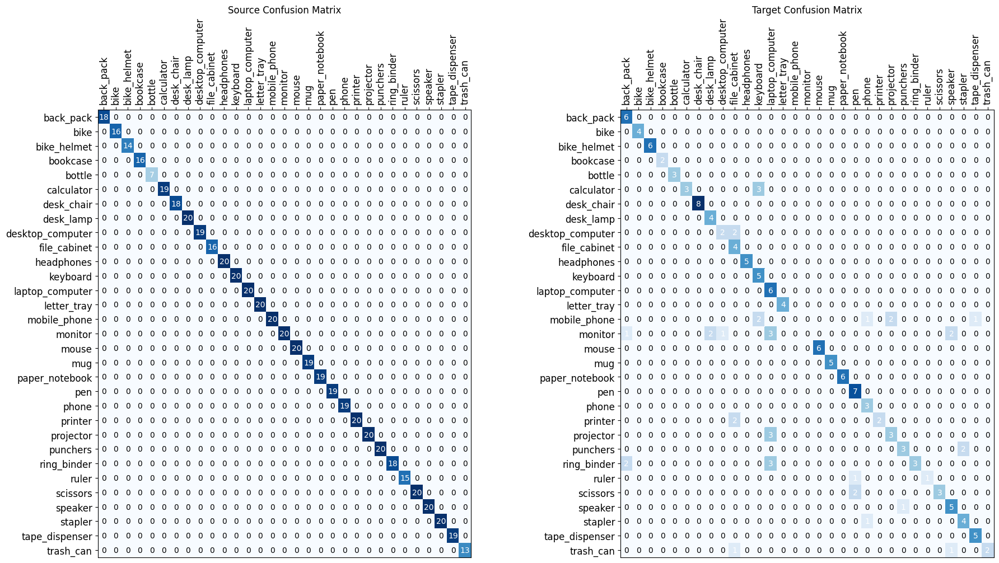

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

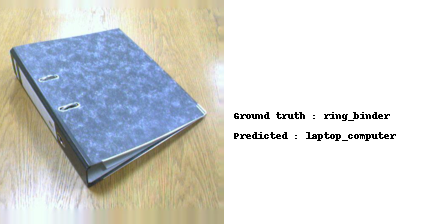

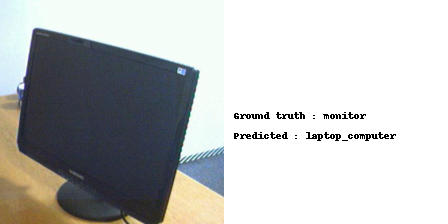

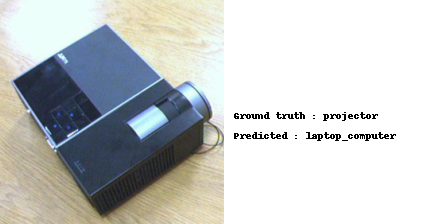

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

#### W -> A

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor, 
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    source_full_loader=full_loader_w,
    source_dataset=dataset_w,
    target_full_loader=full_loader_a,
    target_dataset=dataset_a,
    epochs=5,
    m_steps=25,
    rand=0)

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_auxselftrain_ex_w_a_abf_path)
torch.save(classifier.state_dict(), resnet18_auxselftrain_cl_w_a_abf_path)

In [ ]:
!cp $resnet18_auxselftrain_ex_w_a_abf_path $models_basepath
!cp $resnet18_auxselftrain_cl_w_a_abf_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_auxselftrain_ex_w_a_abf_path  ./
!cp $models_basepath$resnet18_auxselftrain_cl_w_a_abf_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_auxselftrain_ex_w_a_abf_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_auxselftrain_cl_w_a_abf_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


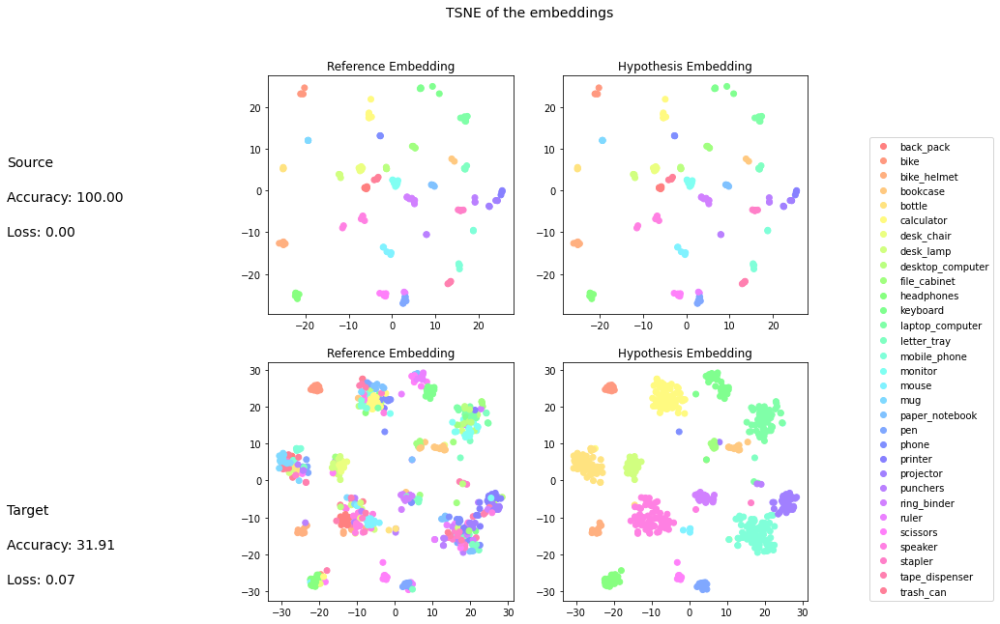

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## Comparison with other datasets

### MNIST and MNIST-M

#### Dataset preparation

In [ ]:
# remove blank spaces
dataset_path = mnist_path.replace(' ','\ ')

In [ ]:
# where to store temporary files for this run ./ for base
temp_dataset_path = './'
temp_dataset_zip = join(temp_dataset_path,basename(dataset_path))
temp_dataset_zip = temp_dataset_zip.replace(' ','\ ')

In [ ]:
!rm -rf $temp_dataset_zip
!cp $dataset_path $temp_dataset_path

In [ ]:
unzipped_dataset_mnist = get_unzipped_name(temp_dataset_zip)

In [ ]:
%%capture
!rm -rf $unzipped_dataset_mnist
!unzip $temp_dataset_zip

In [ ]:
classes = listdir(join(unzipped_dataset_mnist,"mnist"))
domains = ["mnist", "mnist-m"]
light_ratio = 15
for dir in listdir(unzipped_dataset_mnist):
    if dir not in set(domains):
        rmtree(join(unzipped_dataset_mnist, dir))
    for c_dir in listdir(join(unzipped_dataset_mnist, dir)):
        current_max_file = int(len(listdir(join(unzipped_dataset_mnist, dir, c_dir))) / 15)
        # print(join(unzipped_dataset_mnist, dir, c_dir))
        # print(len(listdir(join(unzipped_dataset_mnist, dir, c_dir))))
        # print(current_max_file)
        for idx, sample in enumerate(listdir(join(unzipped_dataset_mnist, dir, c_dir))):
            if idx > current_max_file:
                unlink(join(unzipped_dataset_mnist, dir, c_dir, sample))
        # print(len(listdir(join(unzipped_dataset_mnist, dir, c_dir))))

pprint(classes)

['7', '3', '2', '4', '5', '6', '1', '0', '9', '8']


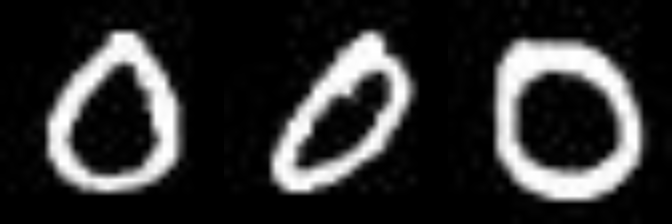

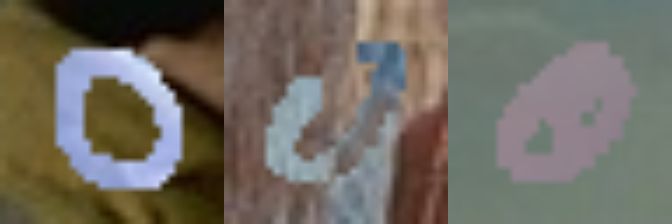

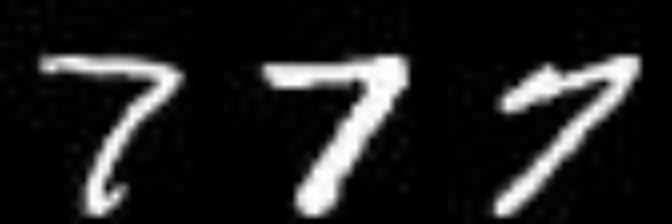

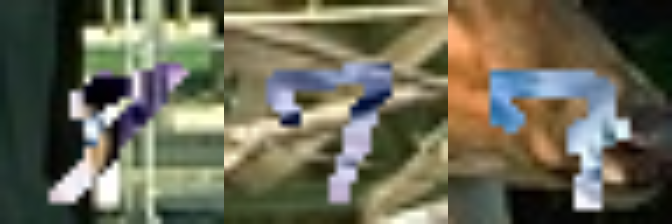

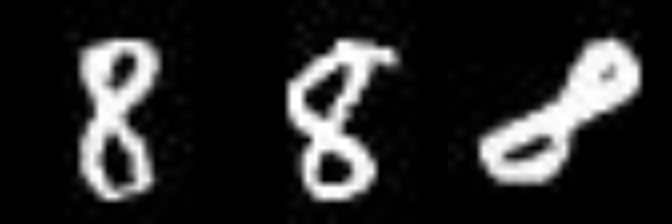

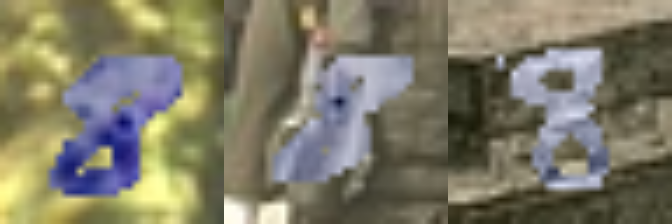

In [ ]:
show_images(dataset_path=f"{unzipped_dataset_mnist}/mnist", category='0', quantity=3)
show_images(dataset_path=f"{unzipped_dataset_mnist}/mnist-m", category='0', quantity=3)
show_images(dataset_path=f"{unzipped_dataset_mnist}/mnist", category='7', quantity=3)
show_images(dataset_path=f"{unzipped_dataset_mnist}/mnist-m", category='7', quantity=3)
show_images(dataset_path=f"{unzipped_dataset_mnist}/mnist", category='8', quantity=3)
show_images(dataset_path=f"{unzipped_dataset_mnist}/mnist-m", category='8', quantity=3)

In [ ]:
dataset_mnist, full_loader_mnist, train_loader_mnist, test_loader_mnist, class_mapping = get_data(
    BATCH_SIZE,
    img_root = f"{unzipped_dataset_mnist}/mnist", 
    apply_norm=False,
    apply_flip=False, 
    train_percentage=0.8,
    test_percentage=0.2, 
    random_state=seed)

dataset size 4005
train set size 3204
val set size 0
test set size 801


In [ ]:
dataset_m, full_loader_m, train_loader_m, test_loader_m, class_mapping = get_data(
    BATCH_SIZE,
    img_root = f"{unzipped_dataset_mnist}/mnist-m", 
    apply_flip=False, 
    train_percentage=0.8,
    test_percentage=0.2, 
    random_state=seed)

dataset size 4539
train set size 3631
val set size 0
test set size 908


#### Baseline

##### MNIST

In [ ]:
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=10).to(device)
optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)
ce_cost_function = get_ce_loss()
ex = train_source_only(extractor,
           classifier,
           train_loader_mnist,
           test_loader_mnist, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           epochs=50, 
           device=device)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_ex_mnist_path)
torch.save(classifier.state_dict(), resnet18_cl_mnist_path)

In [ ]:
!cp $resnet18_ex_mnist_path $models_basepath
!cp $resnet18_cl_mnist_path $models_basepath

###### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_ex_mnist_path  ./
!cp $models_basepath$resnet18_cl_mnist_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_ex_mnist_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=10,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_cl_mnist_path))
classifier.to(device)
classifier.eval()

###### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


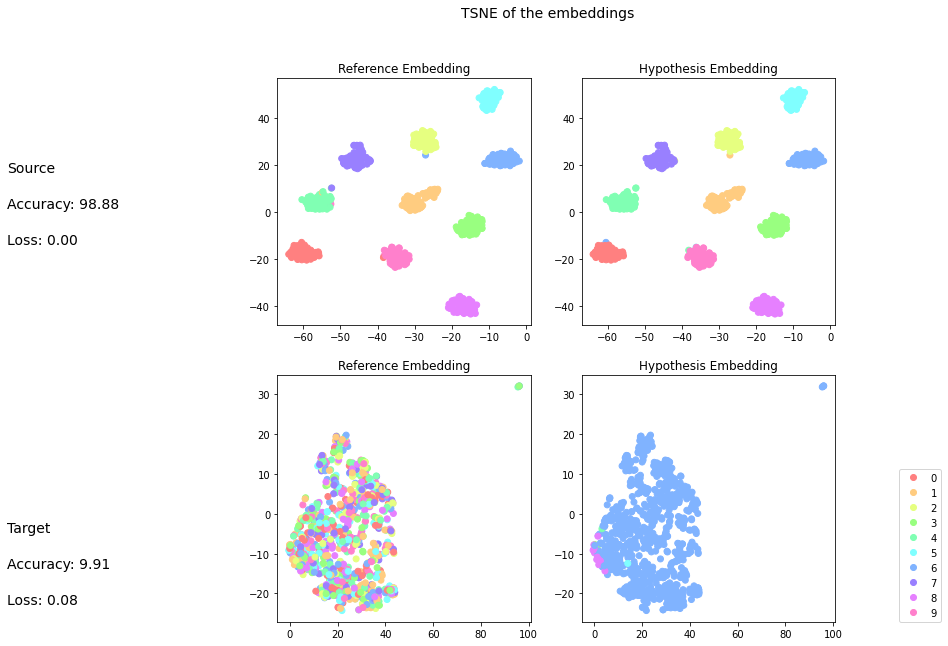

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
0,1.00,0.97,0.99,79.00
1,0.99,0.99,0.99,90.00
2,0.99,1.00,0.99,80.00
3,1.00,1.00,1.00,82.00
4,0.95,1.00,0.98,78.00
5,0.99,1.00,0.99,72.00
6,0.99,0.99,0.99,79.00
7,1.00,0.98,0.99,84.00
8,1.00,1.00,1.00,78.00
9,0.99,0.96,0.97,79.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_mnist,
                                                                                                                            test_loader_m,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

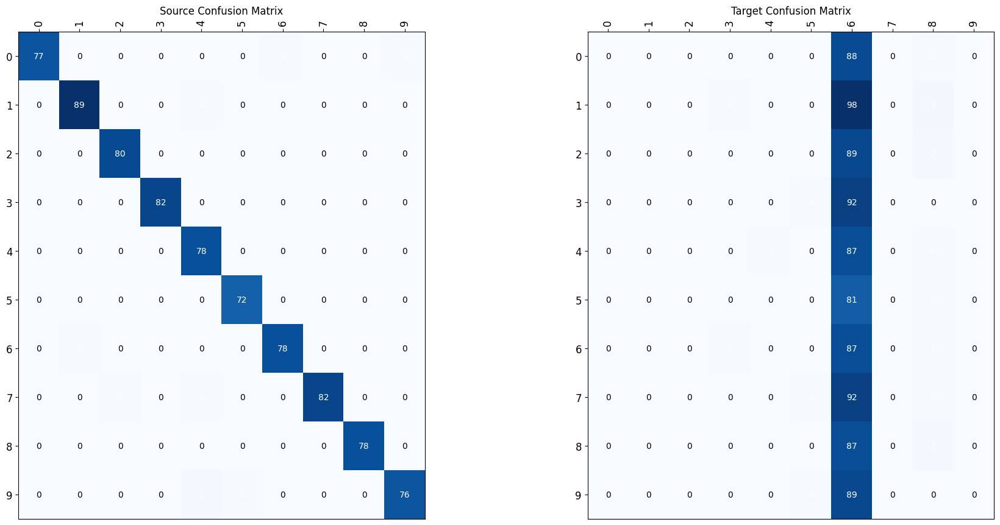

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

##### MNIST-M

In [ ]:
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=10).to(device)
optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)
ce_cost_function = get_ce_loss()
ex = train_source_only(extractor,
           classifier,
           train_loader_m,
           test_loader_m, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           epochs=50, 
           device=device)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_ex_m_path)
torch.save(classifier.state_dict(), resnet18_cl_m_path)

In [ ]:
!cp $resnet18_ex_m_path $models_basepath
!cp $resnet18_cl_m_path $models_basepath

###### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_ex_m_path  ./
!cp $models_basepath$resnet18_cl_m_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_ex_m_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=10,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_cl_m_path))
classifier.to(device)
classifier.eval()

###### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


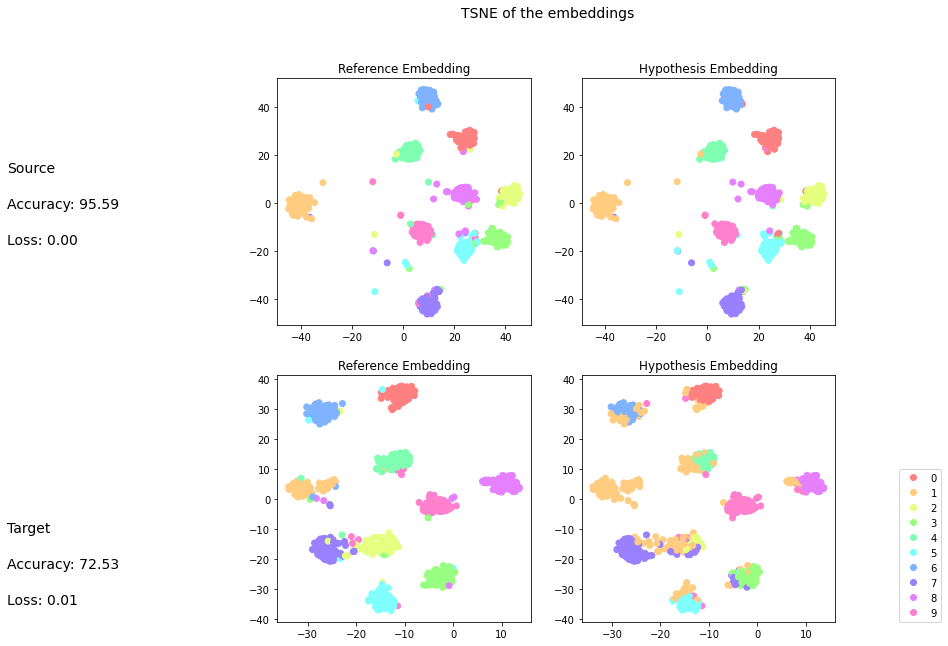

,precision,recall,f1-score,support
0,0.93,0.96,0.94,89.00
1,0.97,1.00,0.99,102.00
2,0.96,0.95,0.95,91.00
3,0.97,0.96,0.96,93.00
4,0.99,0.94,0.97,89.00
5,0.91,0.96,0.93,82.00
6,0.98,0.97,0.97,89.00
7,0.97,0.98,0.97,94.00
8,0.93,0.92,0.93,89.00
9,0.95,0.92,0.94,90.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_m,
                                                                                                                            test_loader_mnist,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

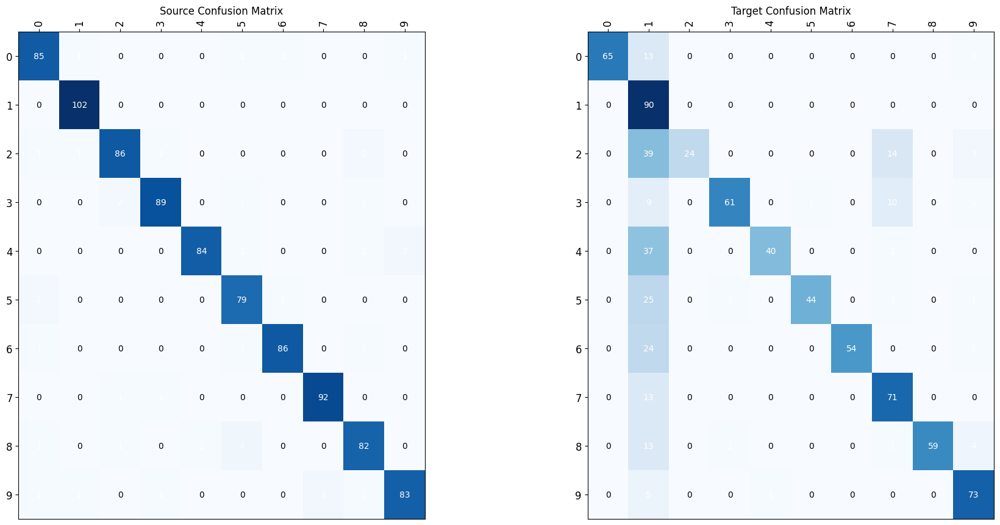

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

#### MNIST $\rightarrow$ MNIST-M

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    unzipped_dataset_mnist,
    source_full_loader=full_loader_mnist,
    source_dataset=dataset_mnist,
    target_full_loader=full_loader_m,
    target_dataset=dataset_m,
    epochs=5,
    m_steps=25,
    first_epoch=20)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/25 [00:00<?, ?it/s]

Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005


In [ ]:
# save pre trained fine tuned model
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_mnist_auxselftrain_ex_b_m_path)
torch.save(classifier.state_dict(), resnet18_mnist_auxselftrain_cl_b_m_path)

In [ ]:
!cp $resnet18_mnist_auxselftrain_ex_b_m_path $models_basepath
!cp $resnet18_mnist_auxselftrain_cl_b_m_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_mnist_auxselftrain_ex_b_m_path  ./
!cp $models_basepath$resnet18_mnist_auxselftrain_cl_b_m_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_mnist_auxselftrain_ex_b_m_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_mnist_auxselftrain_cl_b_m_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


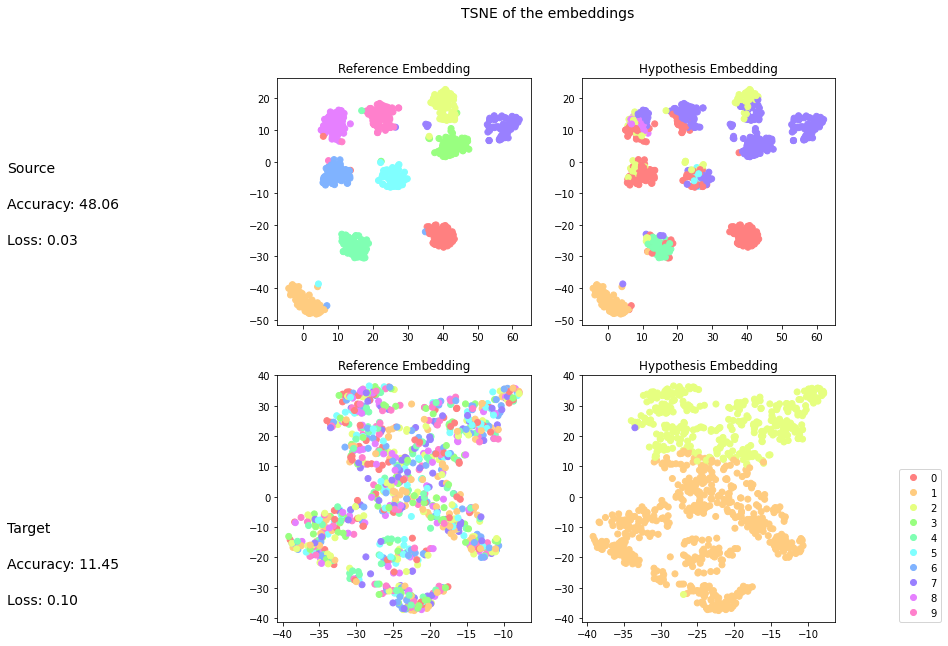

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
0,0.32,1.00,0.49,79.00
1,0.99,0.99,0.99,90.00
2,0.55,0.57,0.56,80.00
3,0.00,0.00,0.00,82.00
4,1.00,0.67,0.80,78.00
5,1.00,0.19,0.33,72.00
6,0.00,0.00,0.00,79.00
7,0.29,1.00,0.44,84.00
8,1.00,0.27,0.42,78.00
9,0.00,0.00,0.00,79.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_mnist,
                                                                                                                            test_loader_m,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

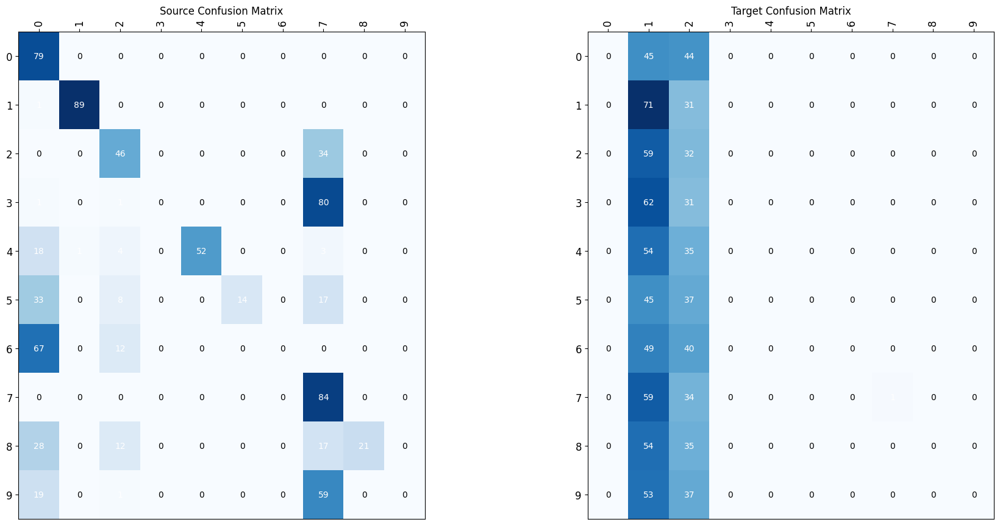

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

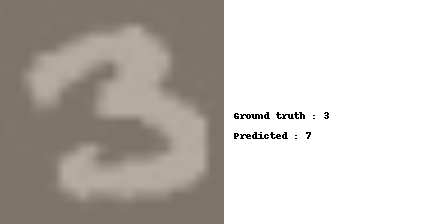

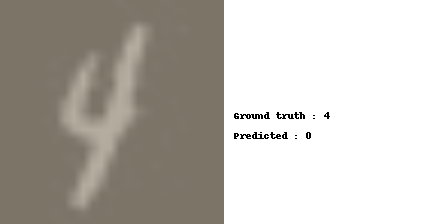

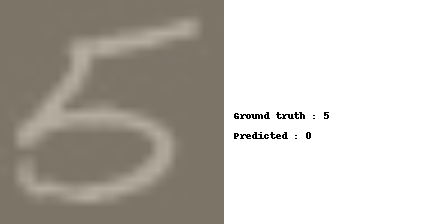

In [ ]:
show_error_images(test_loader_mnist,*source_errors,class_mapping,max_images=3)

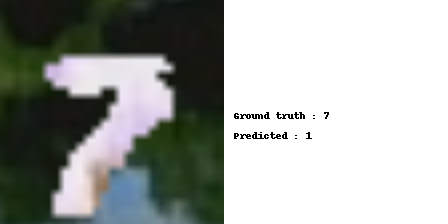

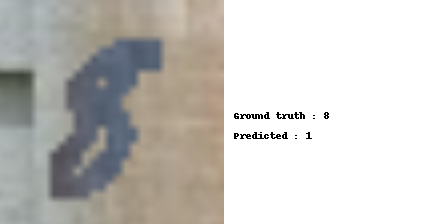

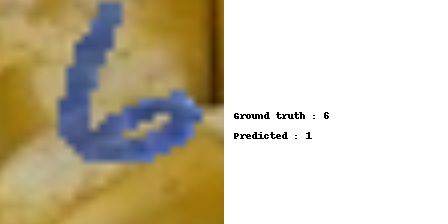

In [ ]:
show_error_images(test_loader_m,*target_errors,class_mapping,max_images=3)

#### MNIST-M $\rightarrow$ MNIST

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    unzipped_dataset_mnist,
    source_full_loader=full_loader_m,
    source_dataset=dataset_m,
    target_full_loader=full_loader_mnist,
    target_dataset=dataset_mnist,
    epochs=5,
    m_steps=25)

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_mnist_auxselftrain_ex_m_b_path)
torch.save(classifier.state_dict(), resnet18_mnist_auxselftrain_cl_m_b_path)

In [ ]:
!cp $resnet18_mnist_auxselftrain_ex_m_b_path $models_basepath
!cp $resnet18_mnist_auxselftrain_cl_m_b_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_mnist_auxselftrain_ex_m_b_path  ./
!cp $models_basepath$resnet18_mnist_auxselftrain_cl_m_b_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_mnist_auxselftrain_ex_m_b_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_mnist_auxselftrain_cl_m_b_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

In [ ]:
colormap = color_map(class_mapping)

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


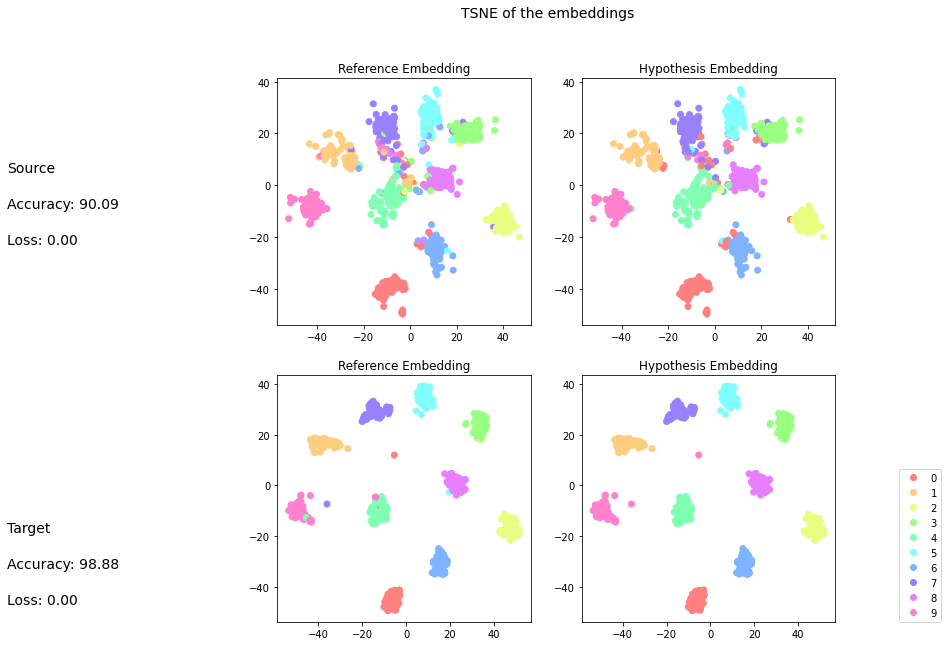

,precision,recall,f1-score,support
0,0.78,0.97,0.86,89.00
1,0.98,0.88,0.93,102.00
2,0.95,0.91,0.93,91.00
3,1.00,0.84,0.91,93.00
4,0.81,0.98,0.89,89.00
5,0.89,0.91,0.90,82.00
6,0.97,0.85,0.91,89.00
7,0.86,0.93,0.89,94.00
8,0.90,0.83,0.87,89.00
9,0.92,0.91,0.92,90.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_m,
                                                                                                                            test_loader_mnist,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

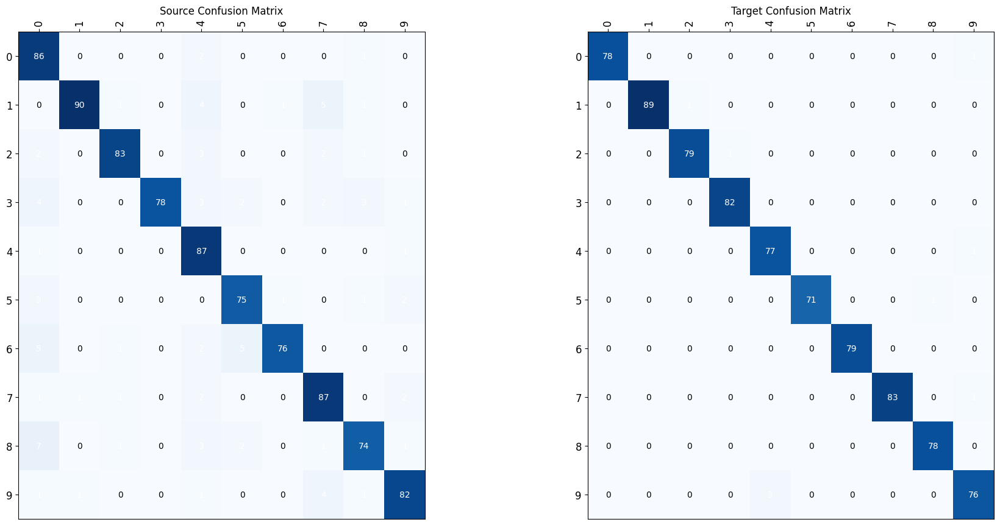

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

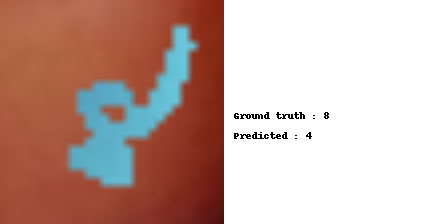

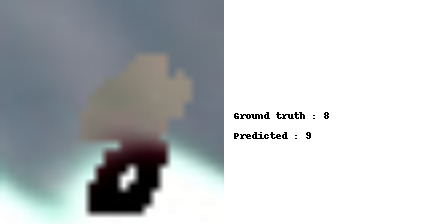

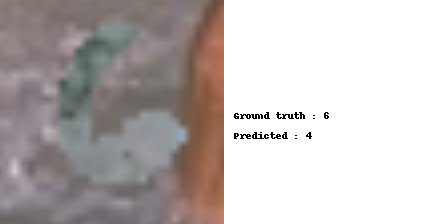

In [ ]:
show_error_images(test_loader_m,*source_errors,class_mapping,max_images=3)

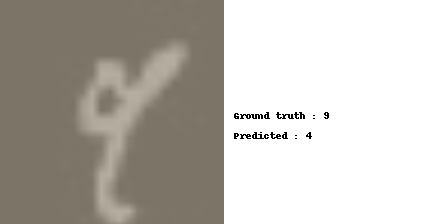

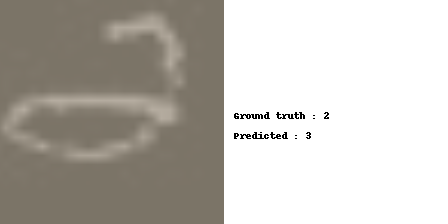

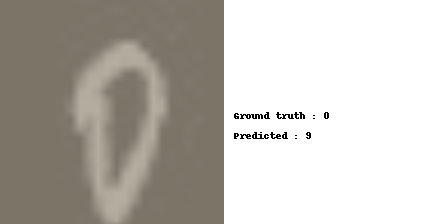

In [ ]:
show_error_images(test_loader_mnist,*target_errors,class_mapping,max_images=3)

#### MNIST $\rightarrow$ MNIST-M (Source Ablation)

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    unzipped_dataset_mnist,
    source_full_loader=full_loader_mnist,
    source_dataset=dataset_mnist,
    target_full_loader=full_loader_m,
    target_dataset=dataset_m,
    epochs=5,
    m_steps=25,
    rand=1)

In [ ]:
# save pre trained fine tuned model
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_mnist_auxselftrain_ex_b_m_abs_path)
torch.save(classifier.state_dict(), resnet18_mnist_auxselftrain_cl_b_m_abs_path)

In [ ]:
!cp $resnet18_mnist_auxselftrain_ex_b_m_abs_path $models_basepath
!cp $resnet18_mnist_auxselftrain_cl_b_m_abs_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_mnist_auxselftrain_ex_b_m_abs_path  ./
!cp $models_basepath$resnet18_mnist_auxselftrain_cl_b_m_abs_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_mnist_auxselftrain_ex_b_m_abs_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_mnist_auxselftrain_cl_b_m_abs_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


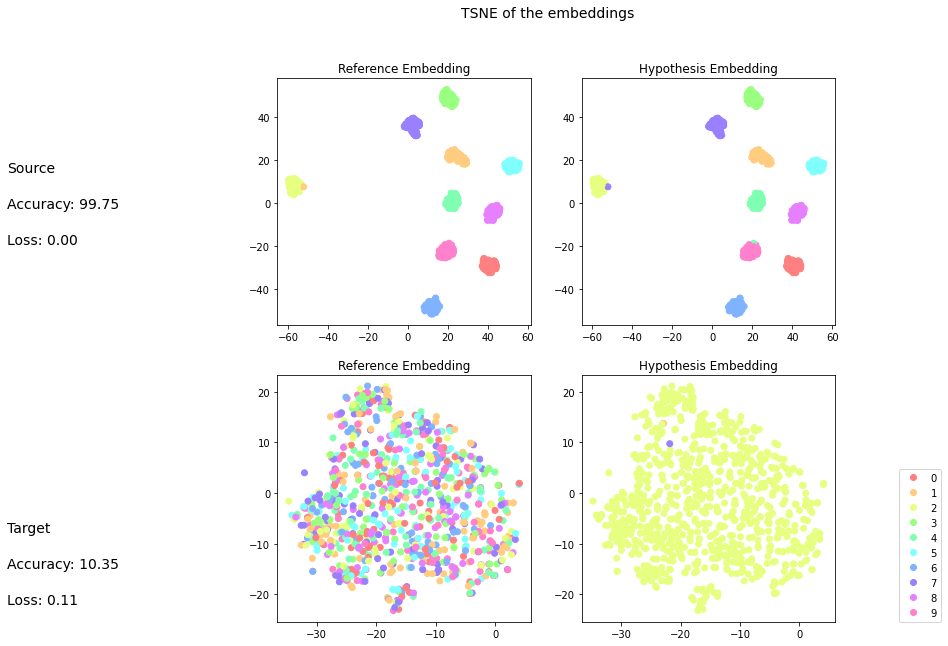

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
0,1.00,1.00,1.00,79.00
1,1.00,0.99,0.99,90.00
2,1.00,1.00,1.00,80.00
3,1.00,1.00,1.00,82.00
4,0.99,1.00,0.99,78.00
5,1.00,1.00,1.00,72.00
6,1.00,1.00,1.00,79.00
7,0.99,1.00,0.99,84.00
8,1.00,1.00,1.00,78.00
9,1.00,0.99,0.99,79.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_mnist,
                                                                                                                            test_loader_m,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

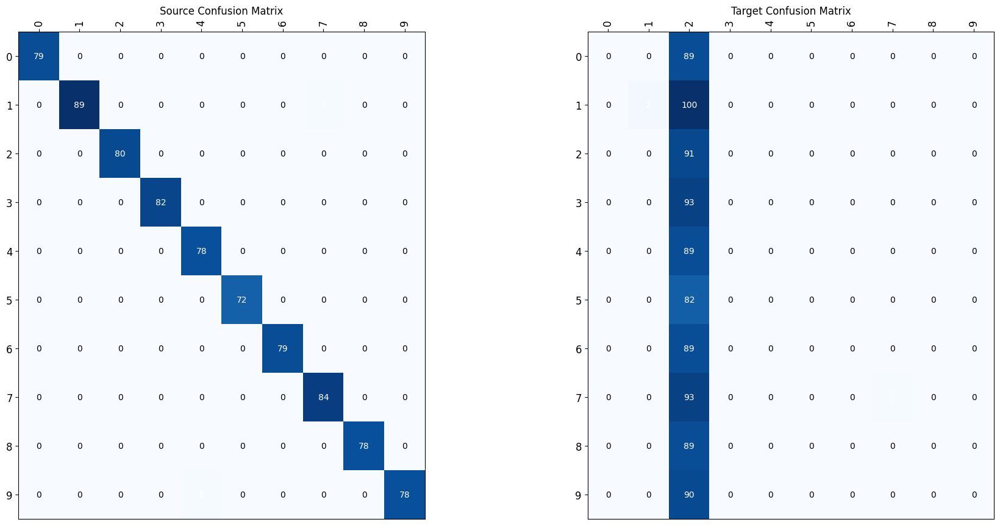

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

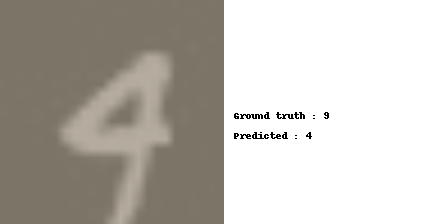

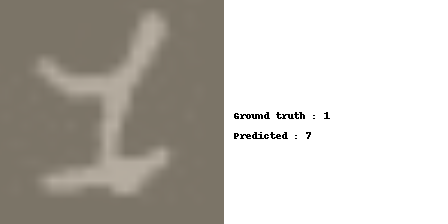

In [ ]:
show_error_images(test_loader_mnist,*source_errors,class_mapping,max_images=3)

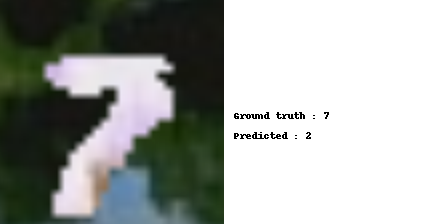

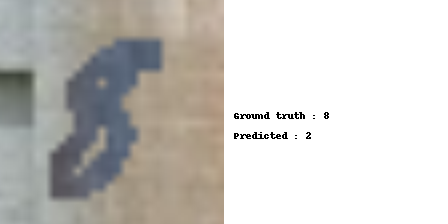

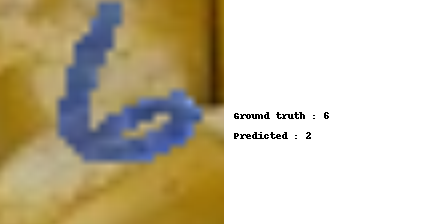

In [ ]:
show_error_images(test_loader_m,*target_errors,class_mapping,max_images=3)

#### MNIST-M $\rightarrow$ MNIST (Source Ablation)

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    unzipped_dataset_mnist,
    source_full_loader=full_loader_m,
    source_dataset=dataset_m,
    target_full_loader=full_loader_mnist,
    target_dataset=dataset_mnist,
    epochs=5,
    m_steps=25,
    rand=1)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/25 [00:00<?, ?it/s]

Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4539
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4369
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4180
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 4005


In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_mnist_auxselftrain_ex_m_b_abs_path)
torch.save(classifier.state_dict(), resnet18_mnist_auxselftrain_cl_m_b_abs_path)

In [ ]:
!cp $resnet18_mnist_auxselftrain_ex_m_b_abs_path $models_basepath
!cp $resnet18_mnist_auxselftrain_cl_m_b_abs_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_mnist_auxselftrain_ex_m_b_abs_path  ./
!cp $models_basepath$resnet18_mnist_auxselftrain_cl_m_b_abs_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_mnist_auxselftrain_ex_m_b_abs_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_mnist_auxselftrain_cl_m_b_abs_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


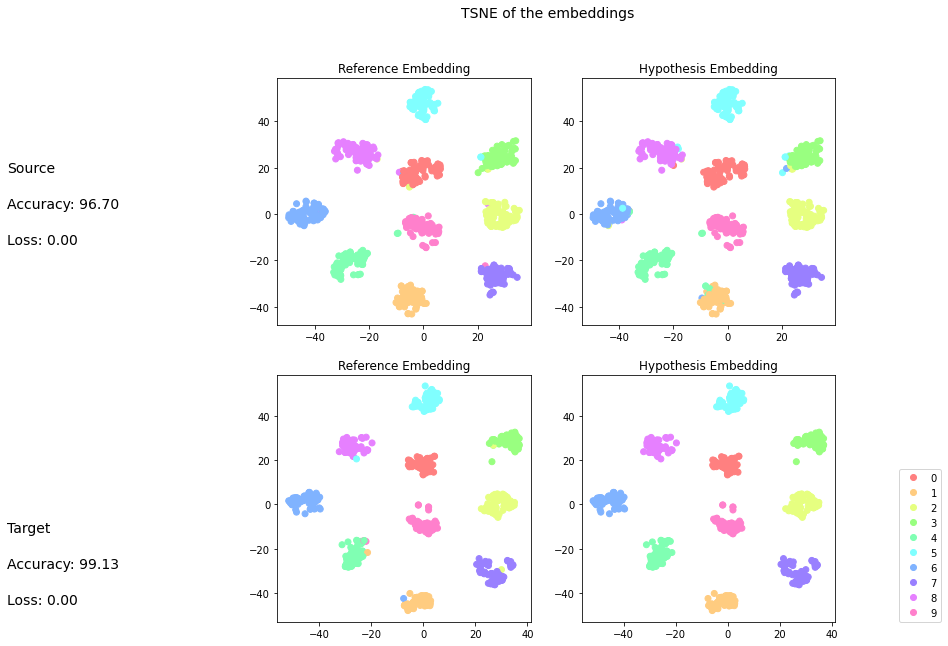

,precision,recall,f1-score,support
0,0.94,1.00,0.97,89.00
1,1.00,0.92,0.96,102.00
2,0.96,0.99,0.97,91.00
3,1.00,0.95,0.97,93.00
4,0.92,0.99,0.95,89.00
5,0.92,1.00,0.96,82.00
6,0.98,0.92,0.95,89.00
7,0.99,1.00,0.99,94.00
8,0.99,0.93,0.96,89.00
9,0.99,0.98,0.98,90.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_m,
                                                                                                                            test_loader_mnist,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

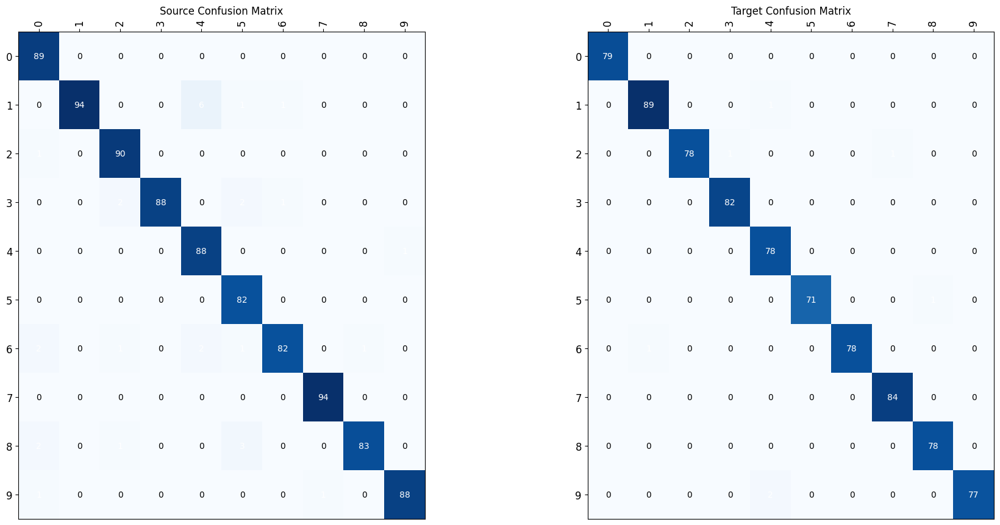

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

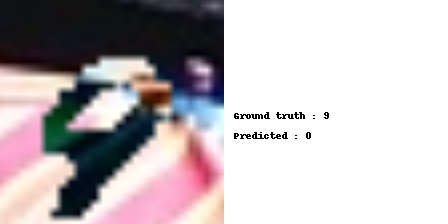

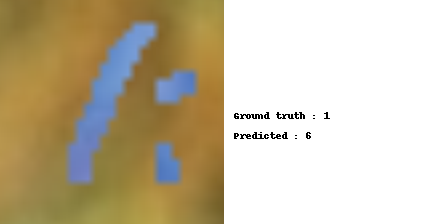

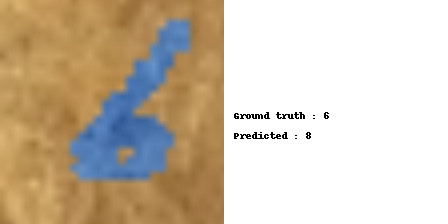

In [ ]:
show_error_images(test_loader_m,*source_errors,class_mapping,max_images=3)

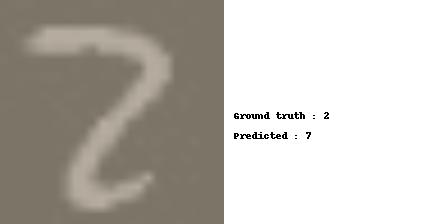

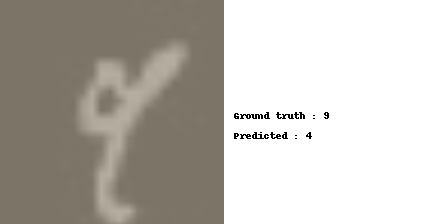

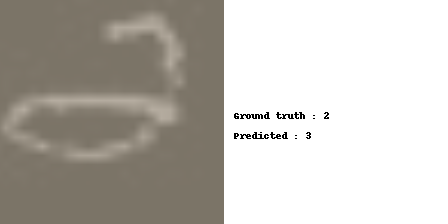

In [ ]:
show_error_images(test_loader_mnist,*target_errors,class_mapping,max_images=3)

#### MNIST $\rightarrow$ MNIST-M (Full Ablation)

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    unzipped_dataset_mnist,
    source_full_loader=full_loader_mnist,
    source_dataset=dataset_mnist,
    target_full_loader=full_loader_m,
    target_dataset=dataset_m,
    epochs=5,
    m_steps=25,
    rand=0)

In [ ]:
# save pre trained fine tuned model
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_mnist_auxselftrain_ex_b_m_abf_path)
torch.save(classifier.state_dict(), resnet18_mnist_auxselftrain_cl_b_m_abf_path)

In [ ]:
!cp $resnet18_mnist_auxselftrain_ex_b_m_abf_path $models_basepath
!cp $resnet18_mnist_auxselftrain_cl_b_m_abf_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_mnist_auxselftrain_ex_b_m_abf_path  ./
!cp $models_basepath$resnet18_mnist_auxselftrain_cl_b_m_abf_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_mnist_auxselftrain_ex_b_m_abf_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_mnist_auxselftrain_cl_b_m_abf_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


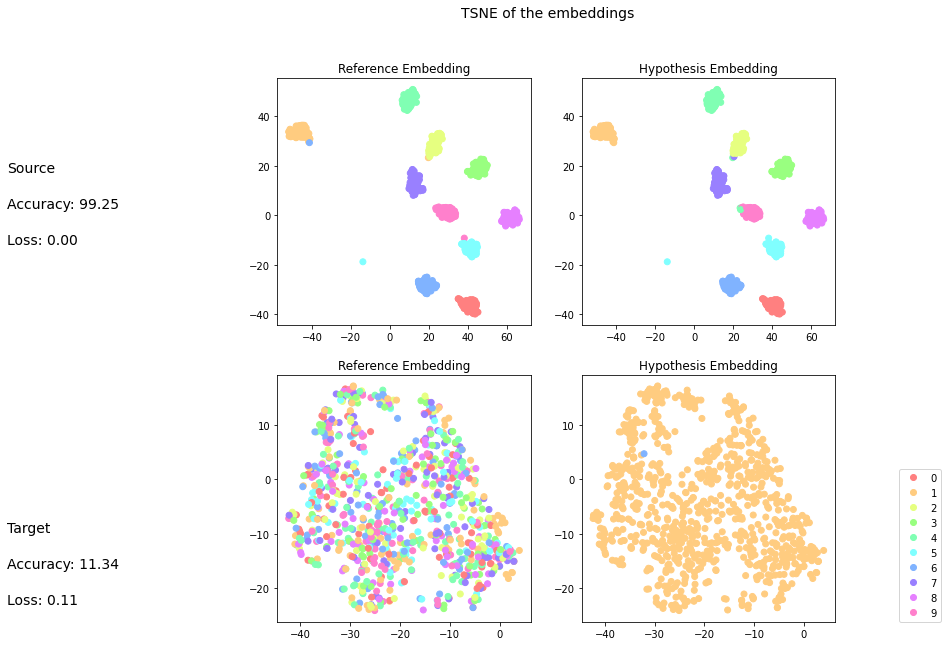

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
0,1.00,1.00,1.00,79.00
1,0.99,0.99,0.99,90.00
2,1.00,0.99,0.99,80.00
3,1.00,1.00,1.00,82.00
4,0.96,1.00,0.98,78.00
5,0.99,1.00,0.99,72.00
6,1.00,0.99,0.99,79.00
7,0.99,1.00,0.99,84.00
8,1.00,1.00,1.00,78.00
9,1.00,0.96,0.98,79.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_mnist,
                                                                                                                            test_loader_m,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

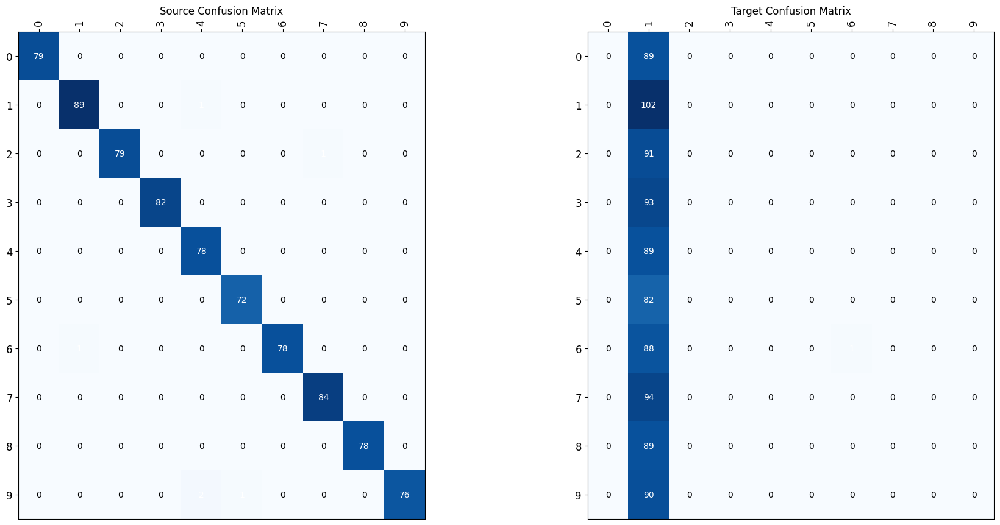

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

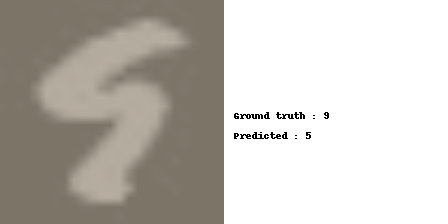

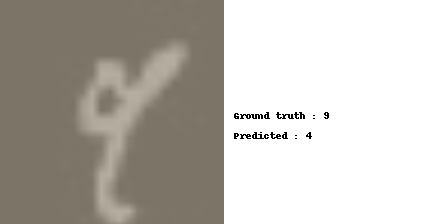

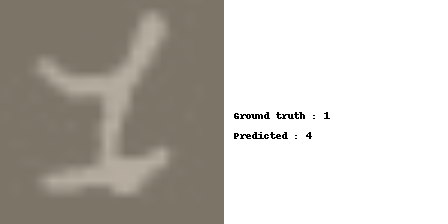

In [ ]:
show_error_images(test_loader_mnist,*source_errors,class_mapping,max_images=3)

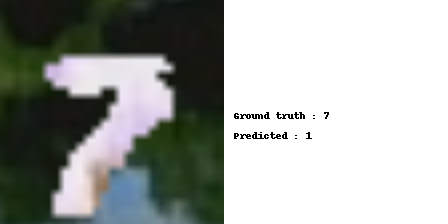

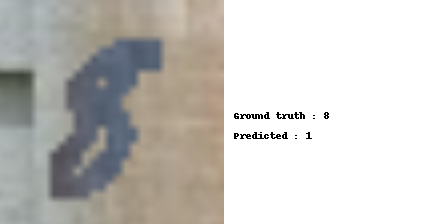

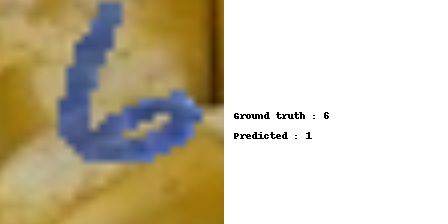

In [ ]:
show_error_images(test_loader_m,*target_errors,class_mapping,max_images=3)

#### MNIST-M $\rightarrow$ MNIST (Full Ablation)

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    unzipped_dataset_mnist,
    source_full_loader=full_loader_m,
    source_dataset=dataset_m,
    target_full_loader=full_loader_mnist,
    target_dataset=dataset_mnist,
    epochs=5,
    m_steps=25,
    rand=0)

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_mnist_auxselftrain_ex_m_b_abf_path)
torch.save(classifier.state_dict(), resnet18_mnist_auxselftrain_cl_m_b_abf_path)

In [ ]:
!cp $resnet18_mnist_auxselftrain_ex_m_b_abf_path $models_basepath
!cp $resnet18_mnist_auxselftrain_cl_m_b_abf_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_mnist_auxselftrain_ex_m_b_abf_path  ./
!cp $models_basepath$resnet18_mnist_auxselftrain_cl_m_b_abf_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_mnist_auxselftrain_ex_m_b_abf_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_mnist_auxselftrain_cl_m_b_abf_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


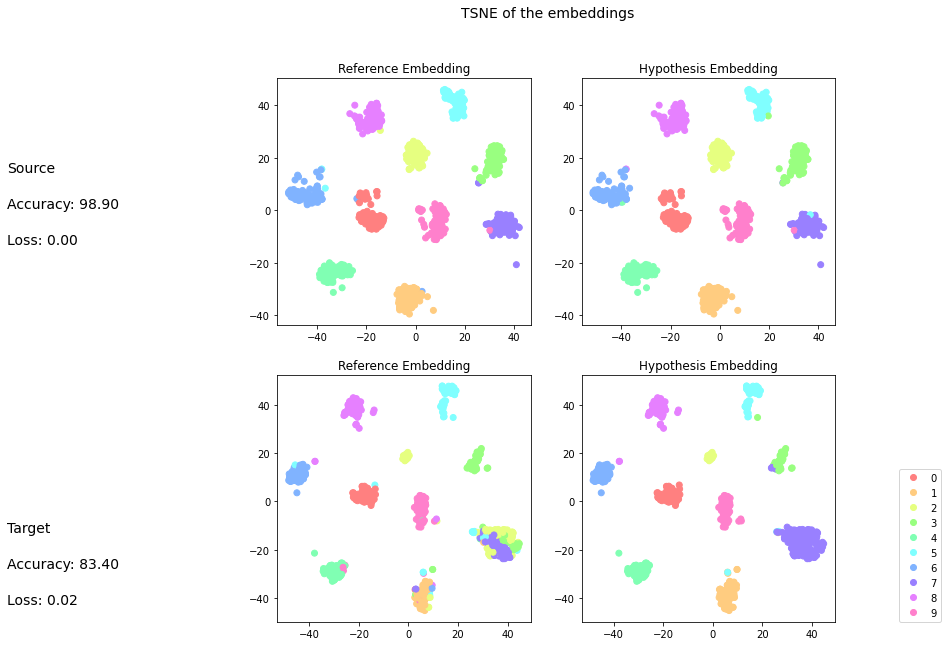

,precision,recall,f1-score,support
0,0.99,1.00,0.99,89.00
1,0.99,1.00,1.00,102.00
2,1.00,0.99,0.99,91.00
3,0.98,1.00,0.99,93.00
4,0.99,1.00,0.99,89.00
5,0.99,0.95,0.97,82.00
6,0.99,0.97,0.98,89.00
7,1.00,0.98,0.99,94.00
8,0.97,1.00,0.98,89.00
9,1.00,1.00,1.00,90.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_m,
                                                                                                                            test_loader_mnist,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

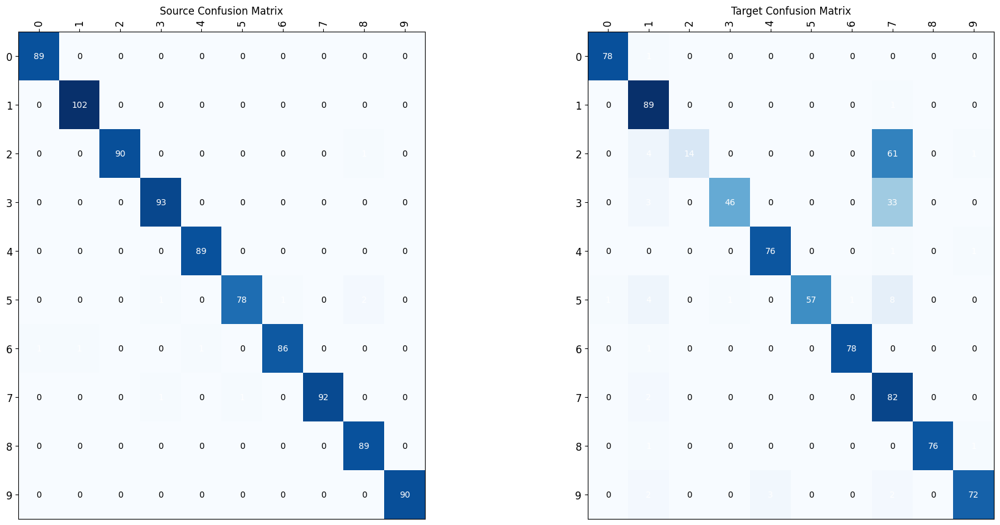

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

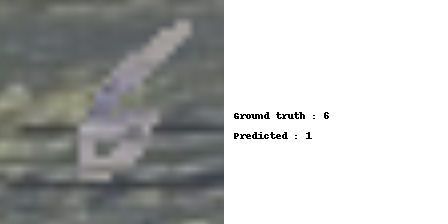

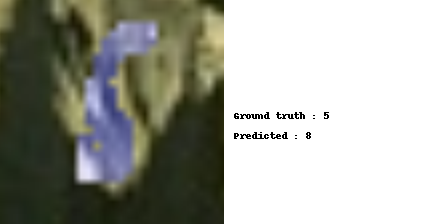

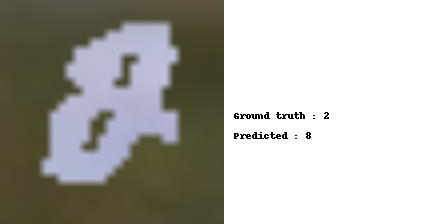

In [ ]:
show_error_images(test_loader_m,*source_errors,class_mapping,max_images=3)

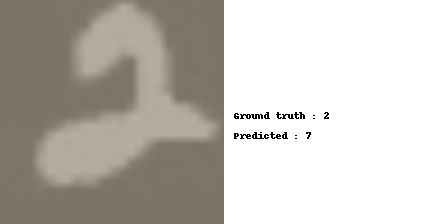

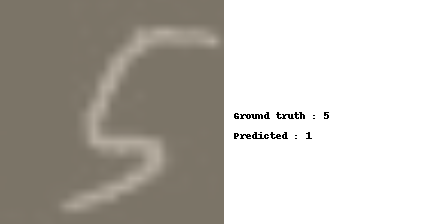

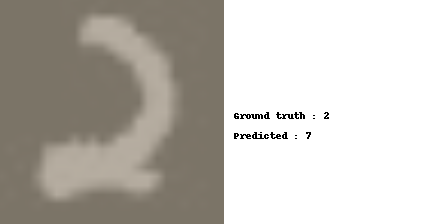

In [ ]:
show_error_images(test_loader_mnist,*target_errors,class_mapping,max_images=3)

### OfficeHome

#### Dataset preparation

In [ ]:
# remove blank spaces
dataset_path = officehome_path.replace(' ','\ ')

In [ ]:
# where to store temporary files for this run ./ for base
temp_dataset_path = './'
temp_dataset_zip = join(temp_dataset_path,basename(dataset_path))
temp_dataset_zip = temp_dataset_zip.replace(' ','\ ')

In [ ]:
!rm -rf $temp_dataset_zip
!cp $dataset_path $temp_dataset_path

In [ ]:
unzipped_dataset_oh = get_unzipped_name(temp_dataset_zip)

In [ ]:
%%capture
!rm -rf $unzipped_dataset_oh
!unzip $temp_dataset_zip

In [ ]:
!rm -rf oh_small/

In [ ]:
!mkdir oh_small
classes = listdir(join(unzipped_dataset_oh,"Product"))
classes = ["Backpack", "Batteries", "Calculator", "Computer", "Couch", "File_Cabinet", "Flowers", "Glasses", "Keyboard",
           "Helmet", "Laptop", "Marker", "Monitor", "Mug", "Notebook", "Pen", "Printer",
           "Ruler", "Screwdriver", "TV"]
for d, td in zip([join(unzipped_dataset_oh,"Product"), join(unzipped_dataset_oh,"Real World")], ["oh_small/Product", "oh_small/Real World"]):
  makedirs(td)
  for c in tqdm(classes):
    c_path = join(d, c)
    c_target = join(td, c)
    copytree(c_path, c_target)
pprint(classes)

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

['Backpack',
 'Batteries',
 'Calculator',
 'Computer',
 'Couch',
 'File_Cabinet',
 'Flowers',
 'Glasses',
 'Keyboard',
 'Helmet',
 'Laptop',
 'Marker',
 'Monitor',
 'Mug',
 'Notebook',
 'Pen',
 'Printer',
 'Ruler',
 'Screwdriver',
 'TV']


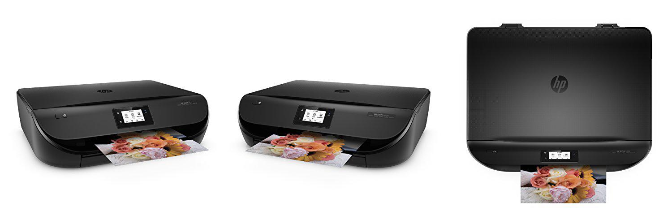

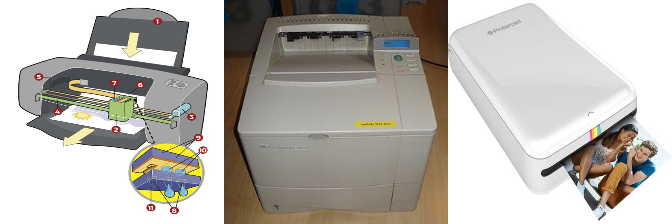

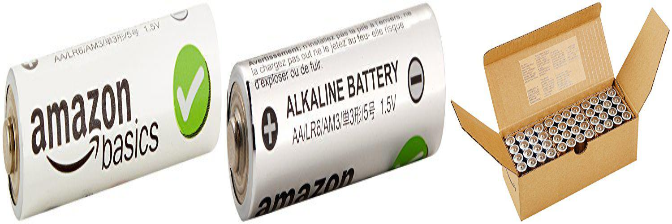

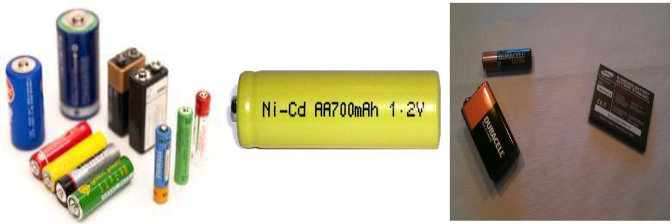

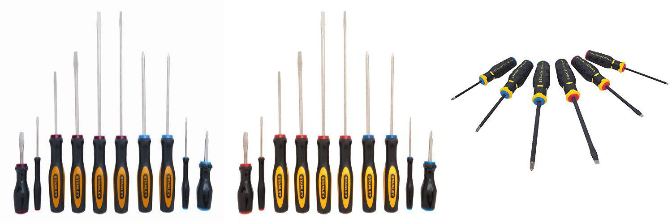

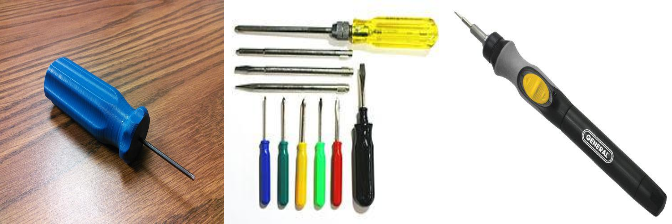

In [ ]:
show_images(dataset_path=f"oh_small/Product", category='Printer', quantity=3)
show_images(dataset_path=f"oh_small/Real World", category='Printer', quantity=3)
show_images(dataset_path=f"oh_small/Product", category='Batteries', quantity=3)
show_images(dataset_path=f"oh_small/Real World", category='Batteries', quantity=3)
show_images(dataset_path=f"oh_small/Product", category='Screwdriver', quantity=3)
show_images(dataset_path=f"oh_small/Real World", category='Screwdriver', quantity=3)

In [ ]:
dataset_p, full_loader_p, train_loader_p, test_loader_p, class_mapping = get_data(
    BATCH_SIZE,
    img_root = f"oh_small/Product", 
    apply_norm=False, 
    train_percentage=0.8,
    test_percentage=0.2, 
    random_state=seed)

dataset size 1564
train set size 1251
val set size 0
test set size 313


In [ ]:
dataset_r, full_loader_r, train_loader_r, test_loader_r, class_mapping = get_data(
    BATCH_SIZE,
    img_root = f"oh_small/Real World", 
    train_percentage=0.8,
    test_percentage=0.2, 
    random_state=seed)

dataset size 1253
train set size 1002
val set size 0
test set size 251


#### Baseline

##### Product

In [ ]:
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=20).to(device)
optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)
ce_cost_function = get_ce_loss()
ex = train_source_only(extractor,
           classifier,
           train_loader_p,
           test_loader_p, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           epochs=50, 
           device=device)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_ex_p_path)
torch.save(classifier.state_dict(), resnet18_cl_p_path)

In [ ]:
!cp $resnet18_ex_p_path $models_basepath
!cp $resnet18_cl_p_path $models_basepath

###### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_ex_p_path  ./
!cp $models_basepath$resnet18_cl_p_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_ex_p_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=20,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_cl_p_path))
classifier.to(device)
classifier.eval()

###### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


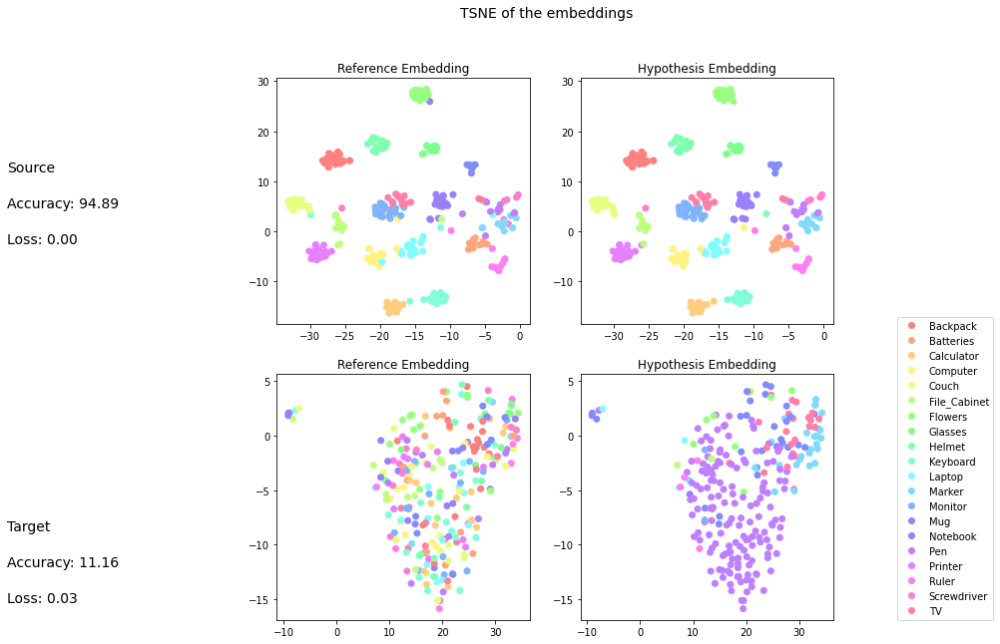

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
Backpack,1.00,1.00,1.00,20.00
Batteries,0.92,1.00,0.96,12.00
Calculator,0.94,1.00,0.97,16.00
Computer,0.90,0.95,0.92,19.00
Couch,0.95,1.00,0.97,18.00
File_Cabinet,1.00,0.86,0.92,14.00
Flowers,0.95,1.00,0.97,18.00
Glasses,1.00,1.00,1.00,13.00
Helmet,0.95,1.00,0.97,18.00
Keyboard,1.00,0.85,0.92,20.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_p,
                                                                                                                            test_loader_r,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

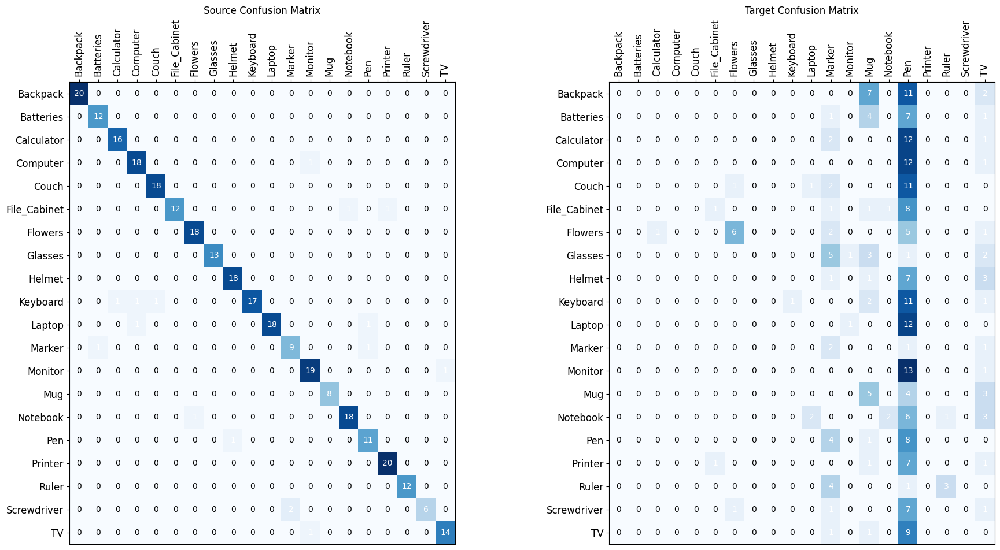

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

##### Real World

In [ ]:
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=20).to(device)
optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)
ce_cost_function = get_ce_loss()
ex = train_source_only(extractor,
           classifier,
           train_loader_r,
           test_loader_r, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           epochs=50, 
           device=device)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_ex_r_path)
torch.save(classifier.state_dict(), resnet18_cl_r_path)

In [ ]:
!cp $resnet18_ex_r_path $models_basepath
!cp $resnet18_cl_r_path $models_basepath

###### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_ex_r_path  ./
!cp $models_basepath$resnet18_cl_r_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_ex_r_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=20,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_cl_r_path))
classifier.to(device)
classifier.eval()

###### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


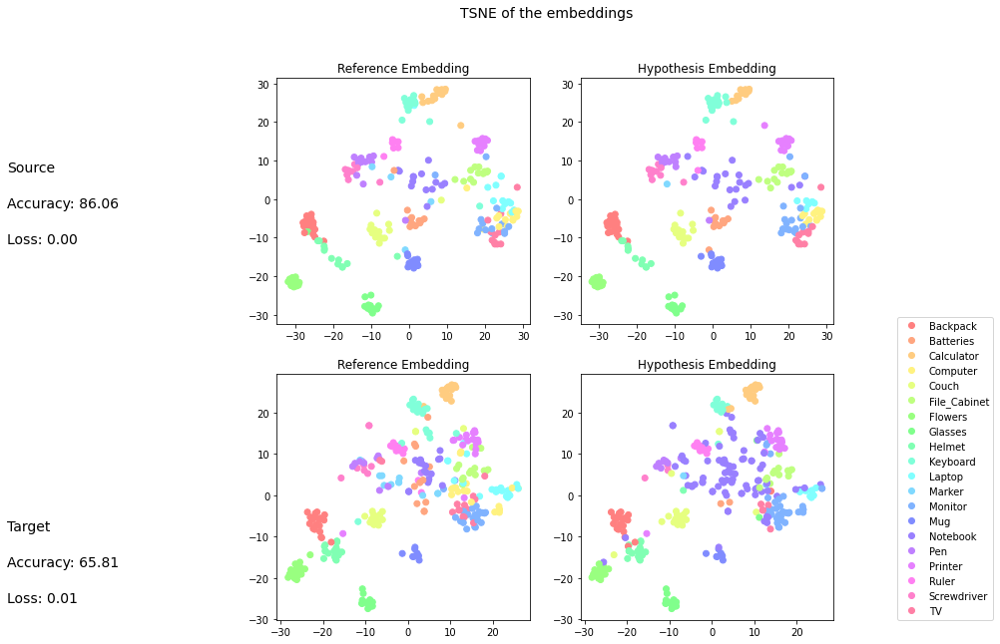

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
Backpack,0.95,1.00,0.98,20.00
Batteries,0.92,0.92,0.92,13.00
Calculator,1.00,0.80,0.89,15.00
Computer,0.67,0.62,0.64,13.00
Couch,1.00,0.93,0.97,15.00
File_Cabinet,0.92,1.00,0.96,12.00
Flowers,1.00,1.00,1.00,15.00
Glasses,1.00,0.92,0.96,12.00
Helmet,1.00,0.92,0.96,12.00
Keyboard,0.82,0.93,0.87,15.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_r,
                                                                                                                            test_loader_p,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

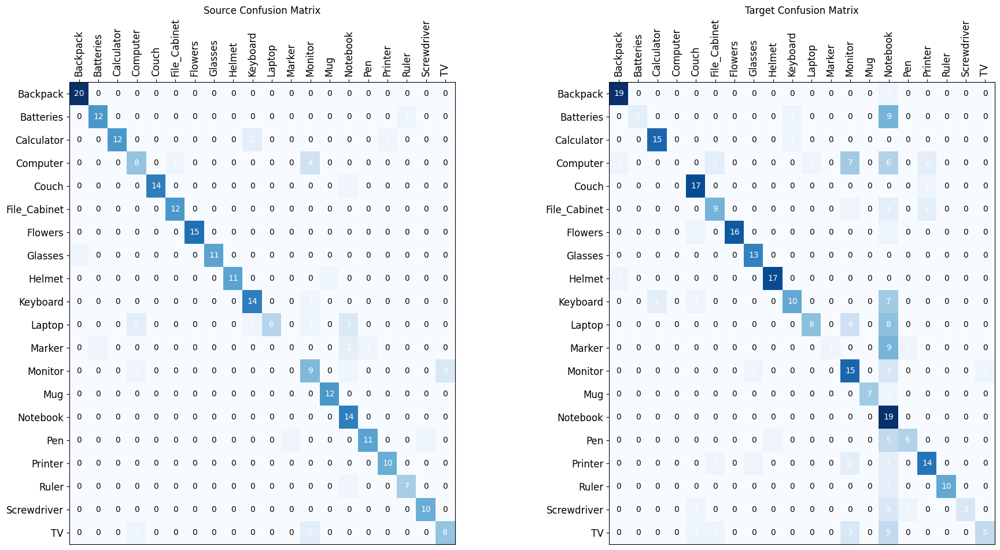

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

#### Product $\rightarrow$ Real World

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    "oh_small",
    source_full_loader=full_loader_p,
    source_dataset=dataset_p,
    target_full_loader=full_loader_r,
    target_dataset=dataset_r,
    epochs=5,
    m_steps=25,
    rand=1)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/25 [00:00<?, ?it/s]

Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1564
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1504
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1434
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1368
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1308
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253


In [ ]:
# save pre trained fine tuned model
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_oh_auxselftrain_ex_p_r_path)
torch.save(classifier.state_dict(), resnet18_oh_auxselftrain_cl_p_r_path)

In [ ]:
!cp $resnet18_oh_auxselftrain_ex_p_r_path $models_basepath
!cp $resnet18_oh_auxselftrain_cl_p_r_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_oh_auxselftrain_ex_p_r_path  ./
!cp $models_basepath$resnet18_oh_auxselftrain_cl_p_r_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_oh_auxselftrain_ex_p_r_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_oh_auxselftrain_cl_p_r_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

In [ ]:
colormap = color_map(class_mapping)

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


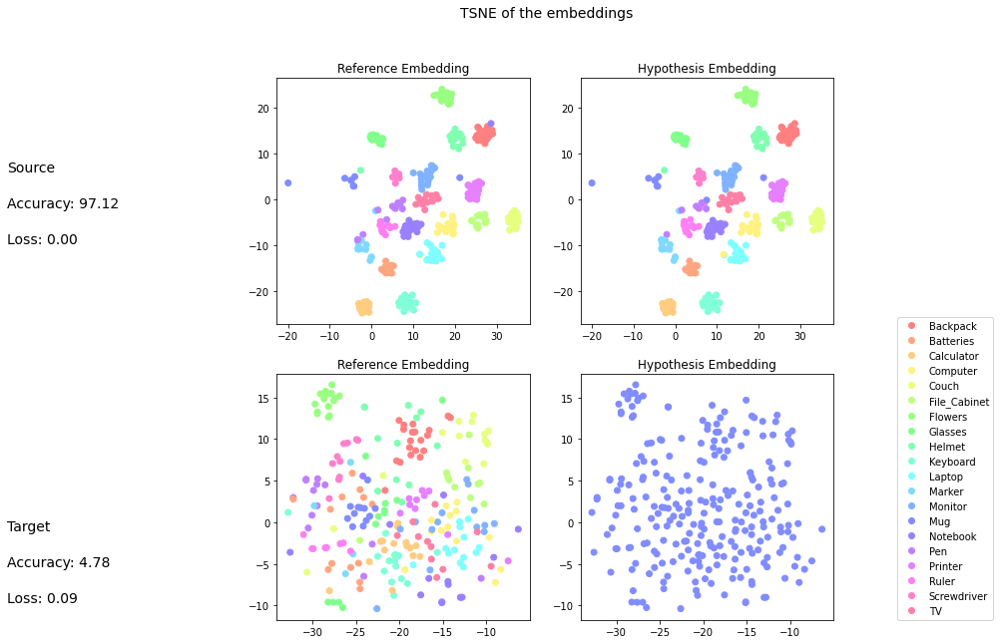

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
Backpack,0.95,1.00,0.98,20.00
Batteries,1.00,1.00,1.00,12.00
Calculator,1.00,1.00,1.00,16.00
Computer,0.95,0.95,0.95,19.00
Couch,1.00,1.00,1.00,18.00
File_Cabinet,1.00,1.00,1.00,14.00
Flowers,1.00,1.00,1.00,18.00
Glasses,1.00,1.00,1.00,13.00
Helmet,1.00,1.00,1.00,18.00
Keyboard,1.00,1.00,1.00,20.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_p,
                                                                                                                            test_loader_r,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

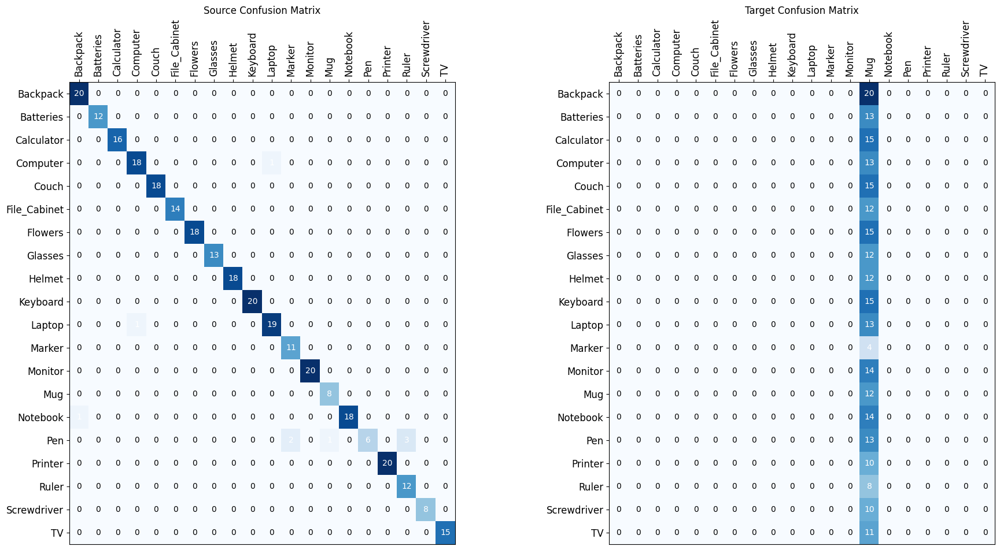

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

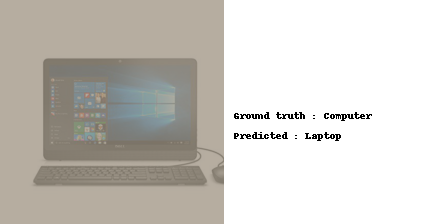

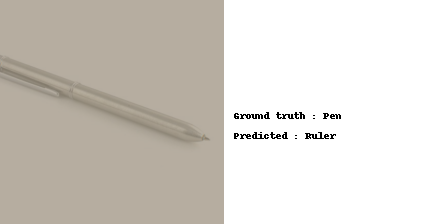

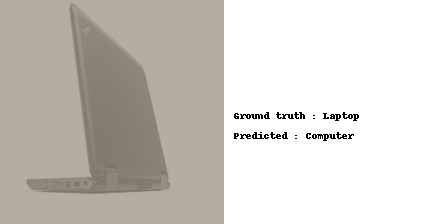

In [ ]:
show_error_images(test_loader_p,*source_errors,class_mapping,max_images=3)

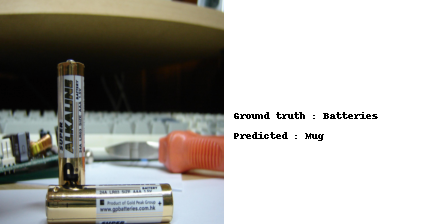

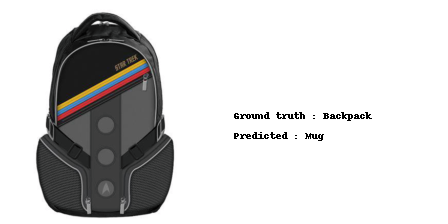

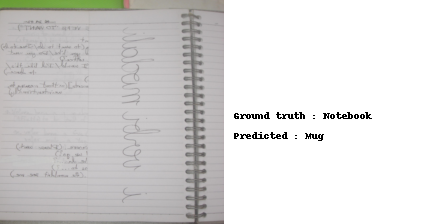

In [ ]:
show_error_images(test_loader_r,*target_errors,class_mapping,max_images=3)

#### Real World $\rightarrow$ Product

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    "oh_small",
    source_full_loader=full_loader_r,
    source_dataset=dataset_r,
    target_full_loader=full_loader_p,
    target_dataset=dataset_p,
    epochs=5,
    m_steps=25,
    rand=1)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


  0%|          | 0/25 [00:00<?, ?it/s]

Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253
Initializing dataloaders...


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Updating dataset...
Selecting target samples...
Selecting source samples...
Update done! Samples: 1253


In [ ]:
# save pre trained fine tuned model
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_oh_auxselftrain_ex_r_p_path)
torch.save(classifier.state_dict(), resnet18_oh_auxselftrain_cl_r_p_path)

In [ ]:
!cp $resnet18_oh_auxselftrain_ex_r_p_path $models_basepath
!cp $resnet18_oh_auxselftrain_cl_r_p_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_oh_auxselftrain_ex_r_p_path  ./
!cp $models_basepath$resnet18_oh_auxselftrain_cl_r_p_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_oh_auxselftrain_ex_r_p_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_oh_auxselftrain_cl_r_p_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

In [ ]:
colormap = color_map(class_mapping)

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


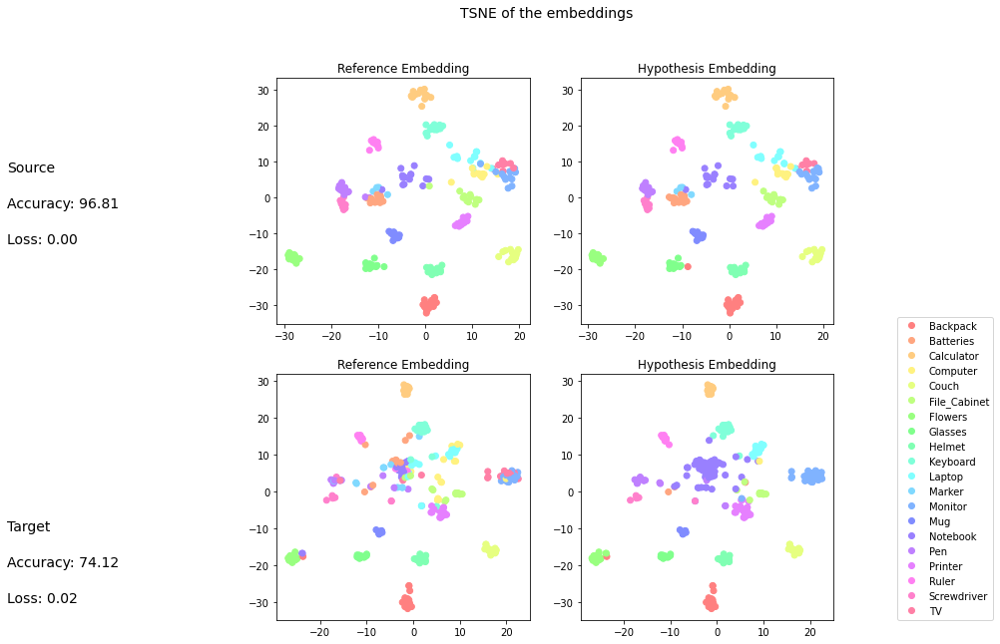

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
Backpack,0.95,1.00,0.98,20.00
Batteries,0.87,1.00,0.93,13.00
Calculator,1.00,1.00,1.00,15.00
Computer,0.92,0.92,0.92,13.00
Couch,1.00,1.00,1.00,15.00
File_Cabinet,1.00,0.92,0.96,12.00
Flowers,1.00,1.00,1.00,15.00
Glasses,1.00,0.92,0.96,12.00
Helmet,1.00,1.00,1.00,12.00
Keyboard,1.00,1.00,1.00,15.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_r,
                                                                                                                            test_loader_p,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

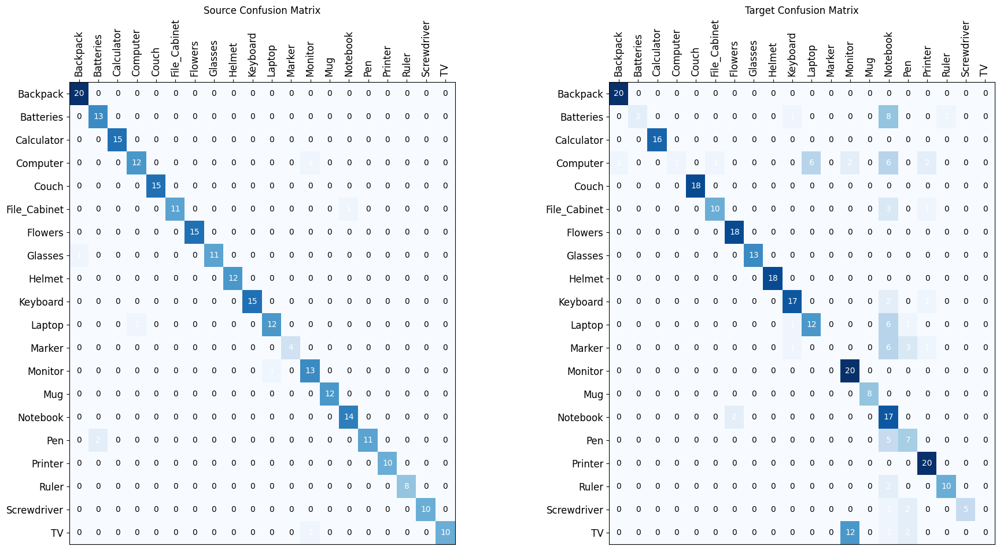

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

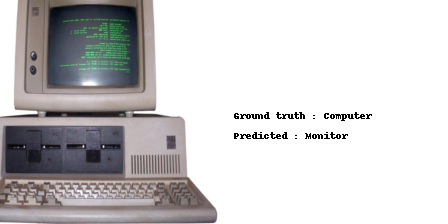

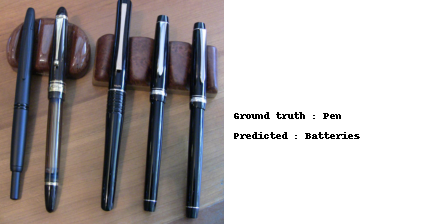

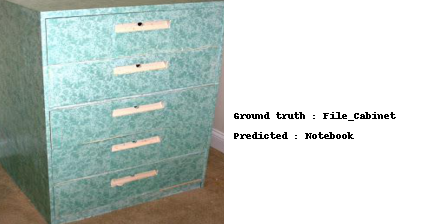

In [ ]:
show_error_images(test_loader_r,*source_errors,class_mapping,max_images=3)

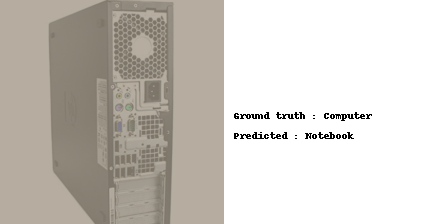

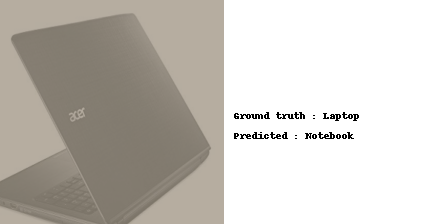

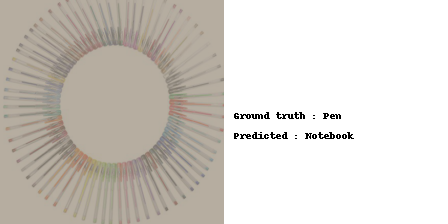

In [ ]:
show_error_images(test_loader_p,*target_errors,class_mapping,max_images=3)

#### Product $\rightarrow$ Real World (Source Ablation)

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=20)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    "oh_small",
    source_full_loader=full_loader_p,
    source_dataset=dataset_p,
    target_full_loader=full_loader_r,
    target_dataset=dataset_r,
    epochs=5,
    m_steps=25,
    rand=1)

In [ ]:
# save pre trained fine tuned model
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_oh_auxselftrain_ex_p_r_abf_path)
torch.save(classifier.state_dict(), resnet18_oh_auxselftrain_cl_p_r_abf_path)

In [ ]:
!cp $resnet18_oh_auxselftrain_ex_p_r_abf_path $models_basepath
!cp $resnet18_oh_auxselftrain_cl_p_r_abf_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_oh_auxselftrain_ex_p_r_abf_path  ./
!cp $models_basepath$resnet18_oh_auxselftrain_cl_p_r_abf_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_oh_auxselftrain_ex_p_r_abf_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_oh_auxselftrain_cl_p_r_abf_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

In [ ]:
colormap = color_map(class_mapping)

In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_p,
                                                                                                                            test_loader_r,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

In [ ]:
show_error_images(test_loader_p,*source_errors,class_mapping,max_images=3)

In [ ]:
show_error_images(test_loader_r,*target_errors,class_mapping,max_images=3)

#### Real World $\rightarrow$ Product (Source Ablation)

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    "oh_small",
    source_full_loader=full_loader_r,
    source_dataset=dataset_r,
    target_full_loader=full_loader_p,
    target_dataset=dataset_p,
    epochs=5,
    m_steps=25,
    rand=1)

In [ ]:
# save pre trained fine tuned model
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_oh_auxselftrain_ex_r_p_abs_path)
torch.save(classifier.state_dict(), resnet18_oh_auxselftrain_cl_r_p_abs_path)

In [ ]:
!cp $resnet18_oh_auxselftrain_ex_r_p_abs_path $models_basepath
!cp $resnet18_oh_auxselftrain_cl_r_p_abs_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_oh_auxselftrain_ex_r_p_abs_path  ./
!cp $models_basepath$resnet18_oh_auxselftrain_cl_r_p_abs_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_oh_auxselftrain_ex_r_p_abs_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_oh_auxselftrain_cl_r_p_abs_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

In [ ]:
colormap = color_map(class_mapping)

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


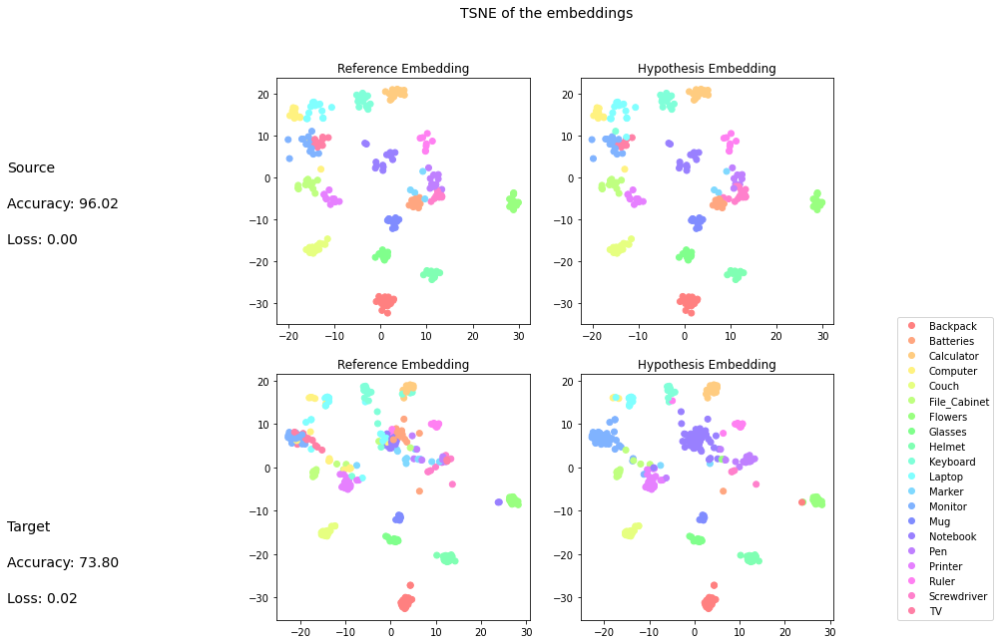

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
Backpack,1.00,1.00,1.00,20.00
Batteries,1.00,0.92,0.96,13.00
Calculator,1.00,1.00,1.00,15.00
Computer,1.00,0.92,0.96,13.00
Couch,1.00,1.00,1.00,15.00
File_Cabinet,1.00,1.00,1.00,12.00
Flowers,1.00,1.00,1.00,15.00
Glasses,1.00,1.00,1.00,12.00
Helmet,1.00,1.00,1.00,12.00
Keyboard,0.94,1.00,0.97,15.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_r,
                                                                                                                            test_loader_p,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

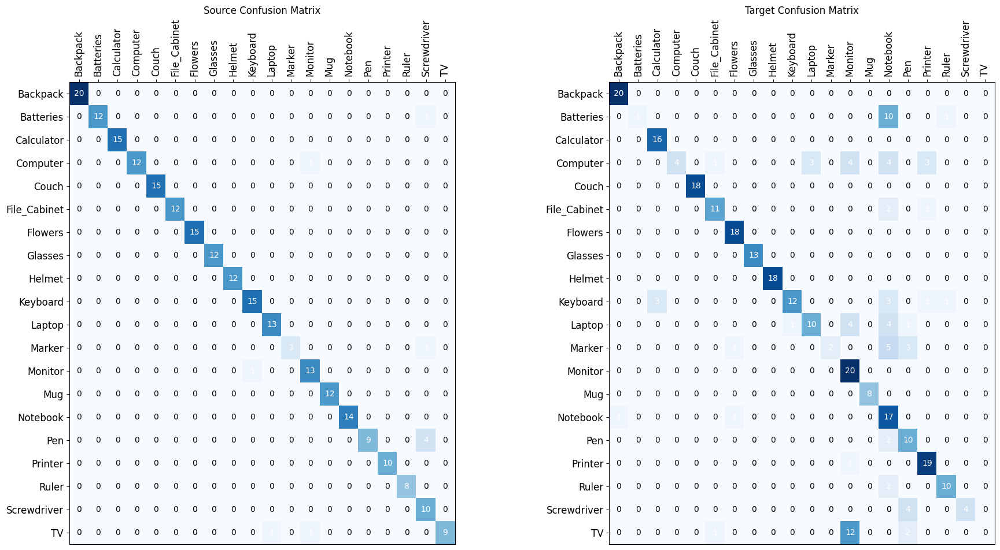

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

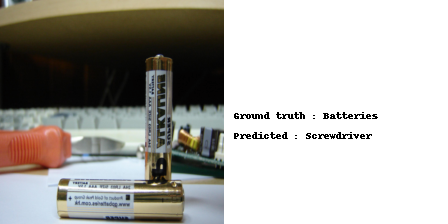

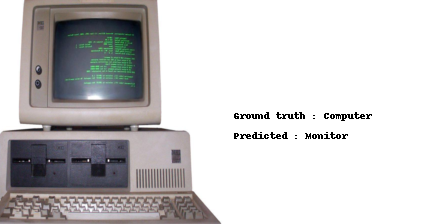

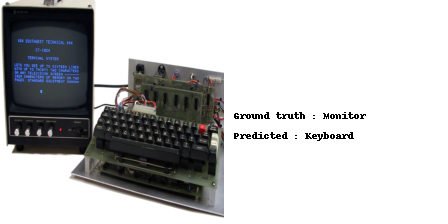

In [ ]:
show_error_images(test_loader_r,*source_errors,class_mapping,max_images=3)

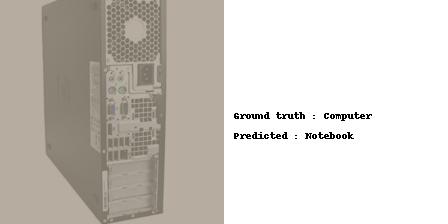

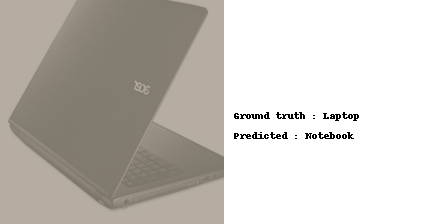

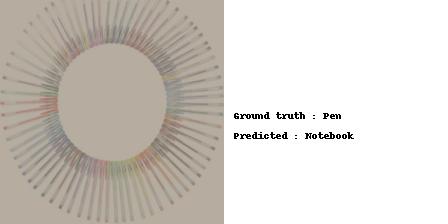

In [ ]:
show_error_images(test_loader_p,*target_errors,class_mapping,max_images=3)

#### Product $\rightarrow$ Real World (Full Ablation)

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=20)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    "oh_small",
    source_full_loader=full_loader_p,
    source_dataset=dataset_p,
    target_full_loader=full_loader_r,
    target_dataset=dataset_r,
    epochs=5,
    m_steps=25,
    rand=0)

In [ ]:
# save pre trained fine tuned model
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_oh_auxselftrain_ex_p_r_abf_path)
torch.save(classifier.state_dict(), resnet18_oh_auxselftrain_cl_p_r_abf_path)

In [ ]:
!cp $resnet18_oh_auxselftrain_ex_p_r_abf_path $models_basepath
!cp $resnet18_oh_auxselftrain_cl_p_r_abf_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_oh_auxselftrain_ex_p_r_abf_path  ./
!cp $models_basepath$resnet18_oh_auxselftrain_cl_p_r_abf_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_oh_auxselftrain_ex_p_r_abf_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=20,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_oh_auxselftrain_cl_p_r_abf_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

In [ ]:
colormap = color_map(class_mapping)

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


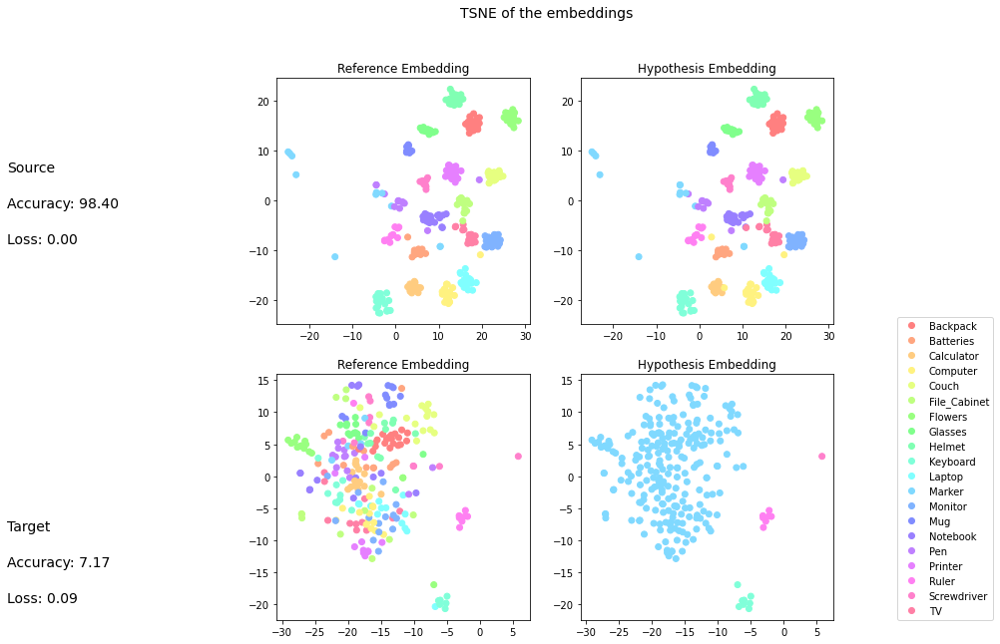

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
Backpack,1.00,1.00,1.00,20.00
Batteries,1.00,0.92,0.96,12.00
Calculator,1.00,0.94,0.97,16.00
Computer,0.90,1.00,0.95,19.00
Couch,1.00,1.00,1.00,18.00
File_Cabinet,1.00,1.00,1.00,14.00
Flowers,1.00,1.00,1.00,18.00
Glasses,1.00,1.00,1.00,13.00
Helmet,1.00,1.00,1.00,18.00
Keyboard,1.00,1.00,1.00,20.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_p,
                                                                                                                            test_loader_r,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

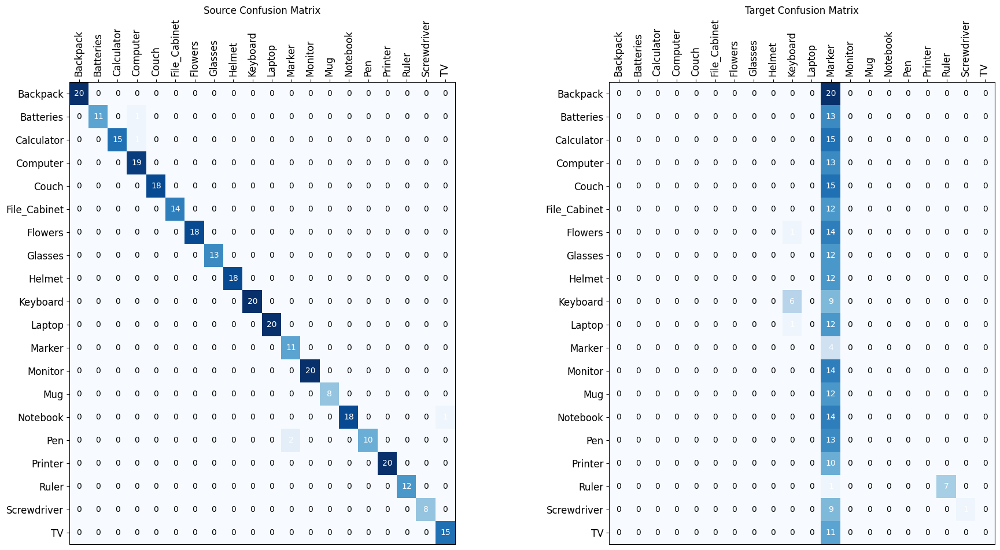

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

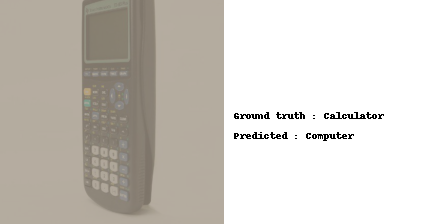

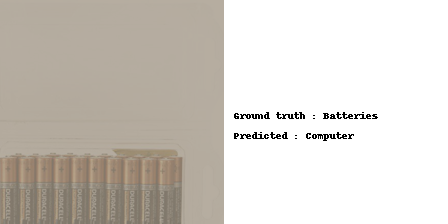

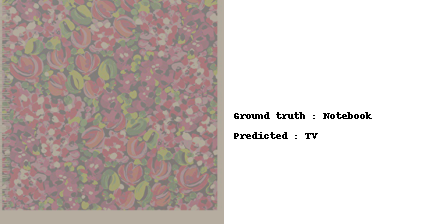

In [ ]:
show_error_images(test_loader_p,*source_errors,class_mapping,max_images=3)

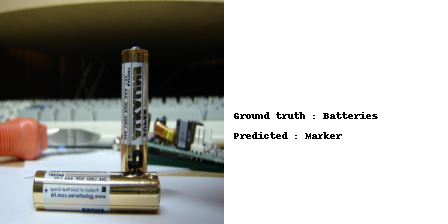

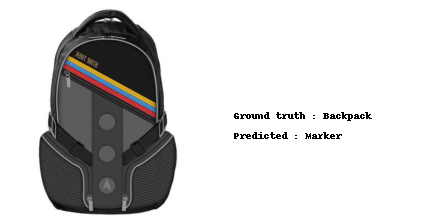

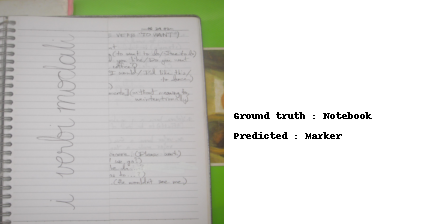

In [ ]:
show_error_images(test_loader_r,*target_errors,class_mapping,max_images=3)

#### Real World $\rightarrow$ Product (Full Ablation)

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=20)

optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

extractor, classifier = aux_self_train(
    extractor,
    classifier, 
    optimizer_ex, 
    optimizer_cl, 
    "oh_small",
    source_full_loader=full_loader_r,
    source_dataset=dataset_r,
    target_full_loader=full_loader_p,
    target_dataset=dataset_p,
    epochs=5,
    m_steps=25,
    rand=0)

In [ ]:
# save pre trained fine tuned model
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_oh_auxselftrain_ex_r_p_abf_path)
torch.save(classifier.state_dict(), resnet18_oh_auxselftrain_cl_r_p_abf_path)

In [ ]:
!cp $resnet18_oh_auxselftrain_ex_r_p_abf_path $models_basepath
!cp $resnet18_oh_auxselftrain_cl_r_p_abf_path $models_basepath

##### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
!cp $models_basepath$resnet18_oh_auxselftrain_ex_r_p_abf_path  ./
!cp $models_basepath$resnet18_oh_auxselftrain_cl_r_p_abf_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_oh_auxselftrain_ex_r_p_abf_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=20,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_oh_auxselftrain_cl_r_p_abf_path))
classifier.to(device)
classifier.eval()

##### Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

In [ ]:
colormap = color_map(class_mapping)

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


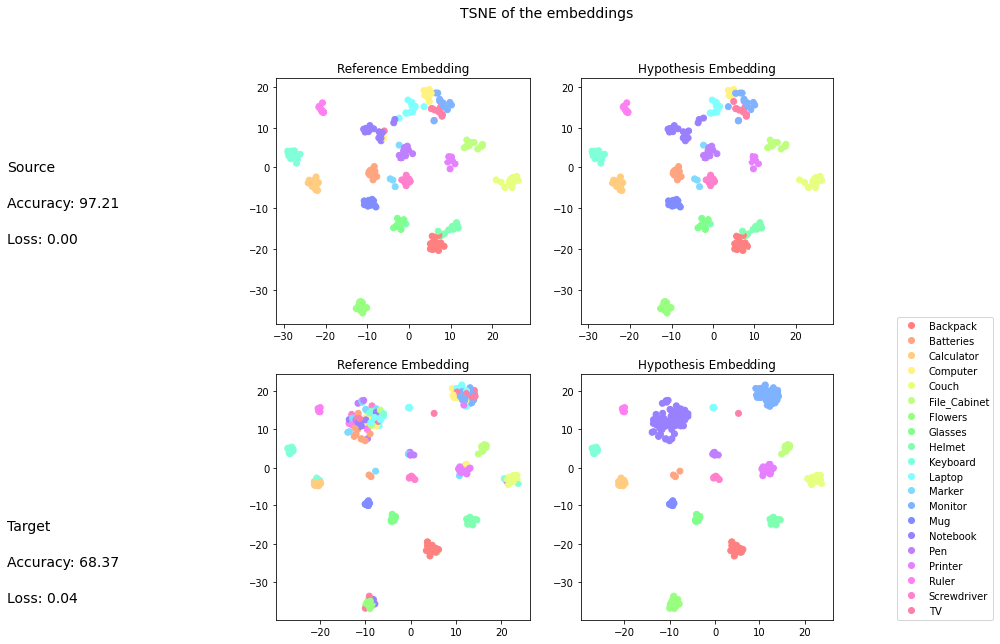

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
Backpack,1.00,1.00,1.00,20.00
Batteries,1.00,1.00,1.00,13.00
Calculator,1.00,1.00,1.00,15.00
Computer,1.00,0.69,0.82,13.00
Couch,1.00,1.00,1.00,15.00
File_Cabinet,1.00,1.00,1.00,12.00
Flowers,1.00,1.00,1.00,15.00
Glasses,1.00,1.00,1.00,12.00
Helmet,1.00,1.00,1.00,12.00
Keyboard,1.00,1.00,1.00,15.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_r,
                                                                                                                            test_loader_p,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

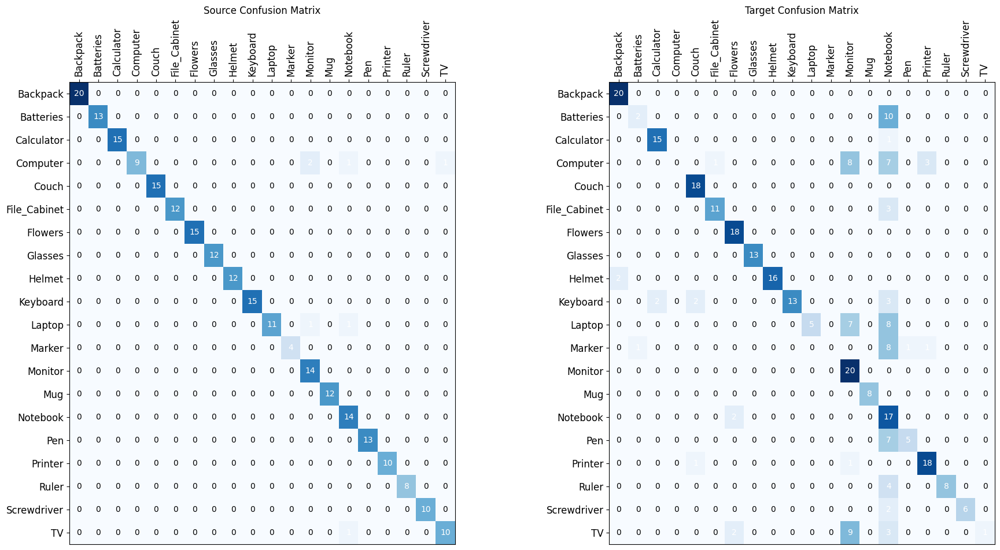

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

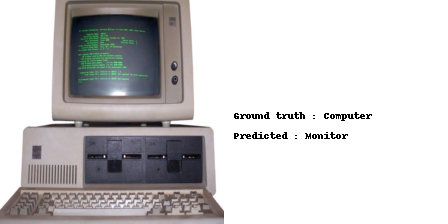

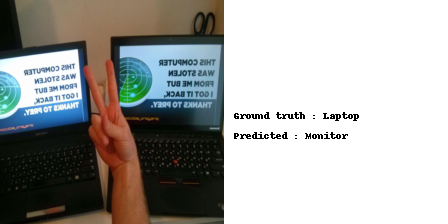

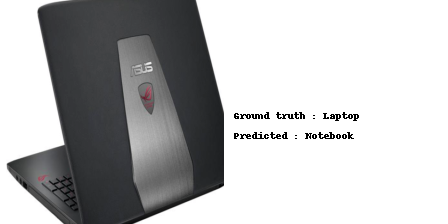

In [ ]:
show_error_images(test_loader_r,*source_errors,class_mapping,max_images=3)

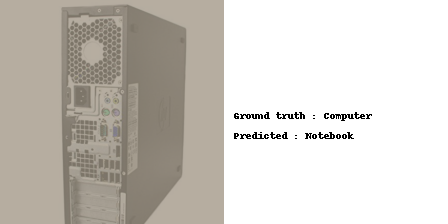

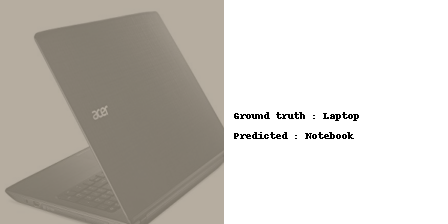

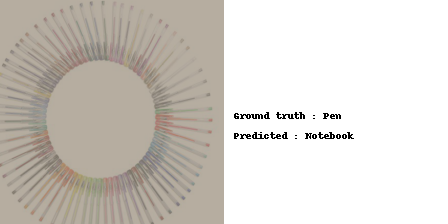

In [ ]:
show_error_images(test_loader_p,*target_errors,class_mapping,max_images=3)

# Conclusions

||Office31|  |Mnist|  |OfficeHome|  |
|-----|-----| ----|-----| ----|-----| ----|
||W $\rightarrow$ A | A $\rightarrow$ M|M $\rightarrow$ MNIST | MNIST $\rightarrow$ M|R $\rightarrow$ P | P $\rightarrow$ R|
|Source only|45% |67% |72% |9% |65% |11% |
|Self training|39% |71% |98% |11% |74% |4% |
|Self training ablation random source|37% |74% |99% |10% |73% |11% |
|Self training ablation full random| 31%| 75%| 83%| 11% |68% |7% |

Here we present our conclusion for self training.

From the table we can conclude that the approach does indeed work, but also have some significant flaws.

The first thing we noticed is that we do have remarkable and consistent improvements in the A $\rightarrow$ W direction, but performances severely drop in the other direction. In particular, we noticed that not only the approach failed to nicely separate the samples in class clusters, it often showed a tendency to overrepresent one class in the final prediction, i.e. assigning the same class label to one big cluster. 

We thought that such behaviour was due to the imbalance in the dataset: the Webcam domain has only 800 samples, while the Amazon domain has almost 3000. Hence, we considered the idea of trying this approach on more balanced datasets.

For this job, we selected:
- **MNIST** and **MNIST-M**: the famous digit dataset and one of its variations with color and background noise
- **OfficeHome** (*Product* and *Real World*): dataset containing images of classes from home and office settings; out of the 65 available classes, we selected 20 of them, which are enough for what concerns our purposes

We then run our method on MNIST $\rightarrow$ MINST-M and viceversa, and the results where unexpected but definitely interesting:
- MNIST $\rightarrow$ MNIST-M: the approach definitely does not work; no clustering happens and the model in the end only predicts one class for each of the sample in the target distribution (see the t-SNE plotting)
- MNIST-M $\rightarrow$ MNIST: we indeed get significant improvements over the baseline (over 10% to 20% depending on the ablation, we weill discuss it later)

For what concerns OfficeHome, results seem to follow a pattern: we have the P $\rightarrow$ R direction that does not work at all (same t-SNE figure appears), while we have smaller but consistent improvements in the R $\rightarrow$ P direction.

We think that such behaviour is determined by the different domain shift that we have in the two directions. Consider MNIST: each sample is a greyscale image with a digit standing out on a plain background. Now, compare that with MNIST-M, where images are colored (huge deal in the latent space representation) and there is a noisy background. A model that learns a good latent representation on MNIST-M can easily transfer its knowledge in the MNIST domain, while the opposite is clearly impossible. The domain shift is too huge for AuxSelfTrain to deal with.

OfficeHome is pretty similar: images in the *Real World* domain are essentially *Product* images with noisy background and artifacts due to light, tone mapping, shadows, etc.

In both cases, what seems to be happening is that the model assigns the same over-confident pseudo-label prediction to all samples, and therefore ends assigning the same label prediction to all the scattered samples. Hence, accuracy values are experiment-dependent, as the over-confident class varies between runs and not every class have the same number of samples.

However, we were left with one question: how is that possible that we have better results on A $\rightarrow$ W than W $\rightarrow$ A in Office31? If our previous hypothesis were correct, we would expect the exact opposite, as A and W are essentially the same as P and R respectively in OfficeHome. We have two different answers to this problem.
- After some further dataset exploration, we found that A has some images that contains the very same background, noise and artifacts features that are to be found on W; this means that the model is probably able to use these scattered more informative sample to make the slow adaptation process work. This can indeed explain the better-as-expected results of A $\rightarrow$ W,
- The inbalance hypothesis was right after all: the model does not see enough target samples in the W $\rightarrow$ A direction to adapt, and therefore the results - including all the ablations - are lower than the baseline (but still consistent with the ablation results).

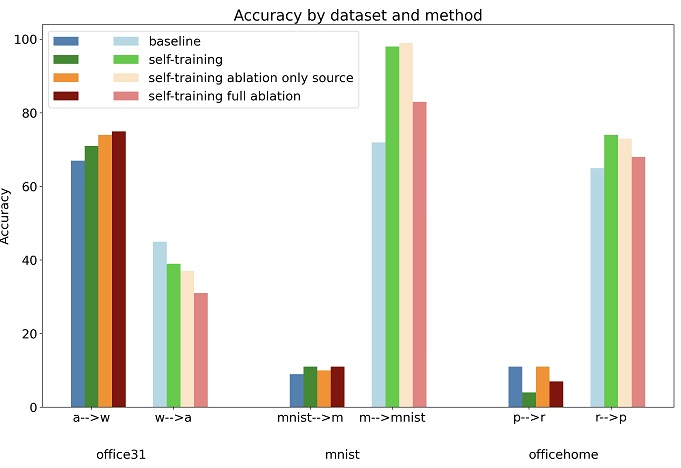

The second interesting consideration came from the ablations studies. We can conclude that the sample selection of both source and target does indeed affect significantly the results. However, we have different considerations for source and target.

In source sample selection we select samples that are closer to the target distribution, but when the domain shift is high, this choice does not make a significant difference.

In target sample selection, we select samples that have a high prediction confidence. This has a huge impact on the performances independently of the domain shift. However, as we were saying before, if the domain shift is too large, it is also likely that the predicted label is not correct and the model is extremely confident in the wrong label. Because we are using a UDA, we cannot correct this behaviour and the outcome is not different from a random selection.

In this regard, it would be quite intresting to reconsider this approach in a Semi-Supervised Domain adaptation scenario, as it has already pointed out in the original paper. 

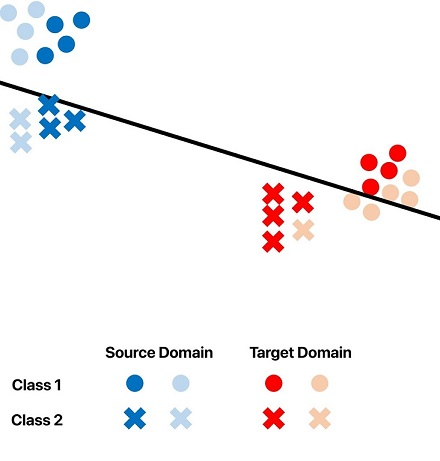